**Housing Project**
**House Price Prediction**

**Problem Statement**
Houses are one of the necessary need of each and every person around the globe and therefore housing and real estate
market is one of the markets which is one of the major contributors in the world’s economy. It is a very large market and there are various companies working in the domain. Data science comes as a very important tool to solve problems in the domain to help the companies increase their overall revenue, profits, improving their marketing strategies and focusing on changing trends in house sales and purchases. Predictive modelling, Market mix modelling, recommendation systems are some of the machine learning techniques used for achieving the business goals for housing companies. Our problem is related to one such housing company.

A US-based housing company named Surprise Housing has decided to enter the Australian market. The company uses
data analytics to purchase houses at a price below their actual values and flip them at a higher price. For the same purpose, the company has collected a data set from the sale of houses in Australia. The data is provided in the CSV file below.

The company is looking at prospective properties to buy houses to enter the market. You are required to build a model
using Machine Learning in order to predict the actual value of the prospective properties and decide whether to invest in them or not. For this company wants to know:

* Which variables are important to predict the price of variable?
* How do these variables describe the price of the house?

**Business Goal:**
You are required to model the price of houses with the available independent variables. This model will then be used
by the management to understand how exactly the prices vary with the variables. They can accordingly manipulate the strategy of the firm and concentrate on areas that will yield high returns. Further, the model will be a good way for the management to understand the pricing dynamics of a new market.

In [137]:
#importing libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [138]:
#loading dataset for train
data=pd.read_csv('train.csv')

In [139]:
pd.set_option('display.max_columns',None)

In [140]:
#checking overview of the train dataset
data.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000


In [141]:
#checking shape for train
data.shape

(1168, 81)

**so we can see that there are about 1168 rows and 80 columns in the dataset.**

In [142]:
#dropping column id from train
data=data.drop(['Id'],axis=1)
data.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000


**Dropping this column as i dont find it relevant at the time of prediction.**

In [143]:
#checking for duplicates in train
data.duplicated().sum()

0

**So we can see that there are no duplicates present in the dataset.**

In [144]:
pd.set_option('display.max_rows',None)

In [145]:
#checking for null values inj train
data.isna().sum()

MSSubClass          0
MSZoning            0
LotFrontage       214
LotArea             0
Street              0
Alley            1091
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          7
MasVnrArea          7
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFinSF        0
GrLivArea 

**So we can see that in columns LotFrontage,Alley,MasVnrType,MasVnrArea,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageQual,GarageCond,PoolQC,Fence and MiscFeature null values are present.**

In [146]:
#checking column
data.columns

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street', 'Alley',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd',
       'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'Wo

**So this are the columns names or the columns present in the dataset.**

In [147]:
#checking for type of data types
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1168 entries, 0 to 1167
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1168 non-null   int64  
 1   MSZoning       1168 non-null   object 
 2   LotFrontage    954 non-null    float64
 3   LotArea        1168 non-null   int64  
 4   Street         1168 non-null   object 
 5   Alley          77 non-null     object 
 6   LotShape       1168 non-null   object 
 7   LandContour    1168 non-null   object 
 8   Utilities      1168 non-null   object 
 9   LotConfig      1168 non-null   object 
 10  LandSlope      1168 non-null   object 
 11  Neighborhood   1168 non-null   object 
 12  Condition1     1168 non-null   object 
 13  Condition2     1168 non-null   object 
 14  BldgType       1168 non-null   object 
 15  HouseStyle     1168 non-null   object 
 16  OverallQual    1168 non-null   int64  
 17  OverallCond    1168 non-null   int64  
 18  YearBuil

**So we can see that 3 columns have float data type, 34 columns have integer datatype and 43 columns have object data type.**

**dropping columns who has a lot of null values.**

In [148]:
#checking for null values
data.isna().sum()/data.shape[0]*100

MSSubClass        0.000000
MSZoning          0.000000
LotFrontage      18.321918
LotArea           0.000000
Street            0.000000
Alley            93.407534
LotShape          0.000000
LandContour       0.000000
Utilities         0.000000
LotConfig         0.000000
LandSlope         0.000000
Neighborhood      0.000000
Condition1        0.000000
Condition2        0.000000
BldgType          0.000000
HouseStyle        0.000000
OverallQual       0.000000
OverallCond       0.000000
YearBuilt         0.000000
YearRemodAdd      0.000000
RoofStyle         0.000000
RoofMatl          0.000000
Exterior1st       0.000000
Exterior2nd       0.000000
MasVnrType        0.599315
MasVnrArea        0.599315
ExterQual         0.000000
ExterCond         0.000000
Foundation        0.000000
BsmtQual          2.568493
BsmtCond          2.568493
BsmtExposure      2.654110
BsmtFinType1      2.568493
BsmtFinSF1        0.000000
BsmtFinType2      2.654110
BsmtFinSF2        0.000000
BsmtUnfSF         0.000000
T

**Dropping columns whos null values percentage is more than 70%**

In [149]:
#dropping columns
data=data.drop(['Alley','PoolQC','Fence','MiscFeature'], axis=1)
data.shape

(1168, 76)

**So we can see that 5 columns have been dropped.**

In [150]:
#checking number of unique values
data.nunique()

MSSubClass        15
MSZoning           5
LotFrontage      106
LotArea          892
Street             2
LotShape           4
LandContour        4
Utilities          1
LotConfig          5
LandSlope          3
Neighborhood      25
Condition1         9
Condition2         8
BldgType           5
HouseStyle         8
OverallQual       10
OverallCond        9
YearBuilt        110
YearRemodAdd      61
RoofStyle          6
RoofMatl           8
Exterior1st       14
Exterior2nd       15
MasVnrType         4
MasVnrArea       283
ExterQual          4
ExterCond          5
Foundation         6
BsmtQual           4
BsmtCond           4
BsmtExposure       4
BsmtFinType1       6
BsmtFinSF1       551
BsmtFinType2       6
BsmtFinSF2       122
BsmtUnfSF        681
TotalBsmtSF      636
Heating            6
HeatingQC          5
CentralAir         2
Electrical         5
1stFlrSF         669
2ndFlrSF         351
LowQualFinSF      21
GrLivArea        746
BsmtFullBath       4
BsmtHalfBath       3
FullBath     

**In this we can see the number of unique values present in the dataset.**

In [151]:
cat_features=[]
for i in data:
    if data[i].dtype=='object':
        cat_features.append(i)
print(cat_features)

['MSZoning', 'Street', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition']


In [152]:
cont_features=[]
for i in data:
    if data[i].dtype!='object':
        cont_features.append(i)
print(cont_features)

['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold', 'SalePrice']


In [153]:
#filling up the null values
for i in data:
    if data[i].dtype=='object':
        data[i]=data[i].fillna(data[i].mode()[0])

In [154]:
#filling up the null values
for i in data:
    if data[i].dtype!='object':
        data[i]=data[i].fillna(data[i].mean())

In [155]:
#checking for null values
data.isna().sum()

MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
KitchenQual      0
TotRmsAbvGrd

In [156]:
#unique values of cat_features
for i in cat_features:
    print(f'\n Unique value of :{i}')
    print(data[i].unique())


 Unique value of :MSZoning
['RL' 'RM' 'FV' 'RH' 'C (all)']

 Unique value of :Street
['Pave' 'Grvl']

 Unique value of :LotShape
['IR1' 'Reg' 'IR2' 'IR3']

 Unique value of :LandContour
['Lvl' 'Bnk' 'HLS' 'Low']

 Unique value of :Utilities
['AllPub']

 Unique value of :LotConfig
['Inside' 'CulDSac' 'FR2' 'Corner' 'FR3']

 Unique value of :LandSlope
['Gtl' 'Mod' 'Sev']

 Unique value of :Neighborhood
['NPkVill' 'NAmes' 'NoRidge' 'NWAmes' 'Gilbert' 'Sawyer' 'Edwards'
 'IDOTRR' 'CollgCr' 'Mitchel' 'Crawfor' 'BrDale' 'StoneBr' 'BrkSide'
 'NridgHt' 'OldTown' 'Somerst' 'Timber' 'SWISU' 'SawyerW' 'ClearCr'
 'Veenker' 'Blmngtn' 'MeadowV' 'Blueste']

 Unique value of :Condition1
['Norm' 'Feedr' 'RRAn' 'PosA' 'RRAe' 'Artery' 'PosN' 'RRNe' 'RRNn']

 Unique value of :Condition2
['Norm' 'RRAe' 'Feedr' 'PosN' 'Artery' 'RRNn' 'PosA' 'RRAn']

 Unique value of :BldgType
['TwnhsE' '1Fam' 'Duplex' 'Twnhs' '2fmCon']

 Unique value of :HouseStyle
['1Story' '2Story' '1.5Fin' 'SFoyer' '1.5Unf' 'SLvl' '2.5F

In [157]:
#unique values of cont_features
for i in cont_features:
    print(f'\n Unique value of :{i}')
    print(data[i].unique())


 Unique value of :MSSubClass
[120  20  60  50  70  30 160  85  45  90  40  80 190  75 180]

 Unique value of :LotFrontage
[ 70.9884696  95.         92.        105.         58.         88.
  70.         80.         50.         44.        129.         59.
  55.         64.         24.         68.         71.         74.
  61.         60.        120.         84.        141.         30.
  65.         76.        100.         85.         75.        107.
 122.         82.         62.         73.         79.         77.
  41.         69.         90.         96.         72.         34.
  78.         63.         40.         98.        160.        108.
 128.         51.         81.         99.         66.         37.
 174.         87.         53.        152.         47.         86.
  56.         89.         35.         52.         21.        104.
  57.         83.         46.        101.        112.        149.
  93.         49.         43.        130.         54.         91.
  67.         97.  

RL         928
RM         163
FV          52
RH          16
C (all)      9
Name: MSZoning, dtype: int64


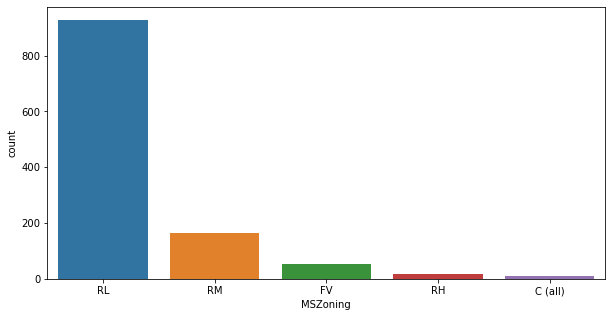

Pave    1164
Grvl       4
Name: Street, dtype: int64


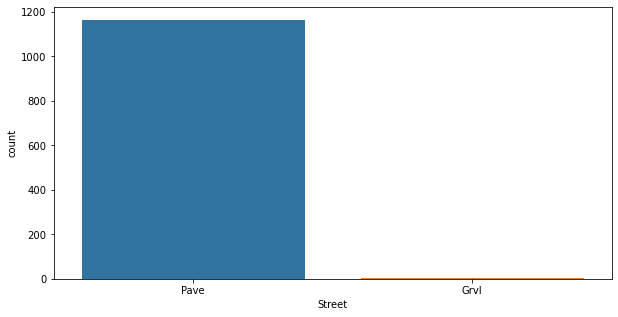

Reg    740
IR1    390
IR2     32
IR3      6
Name: LotShape, dtype: int64


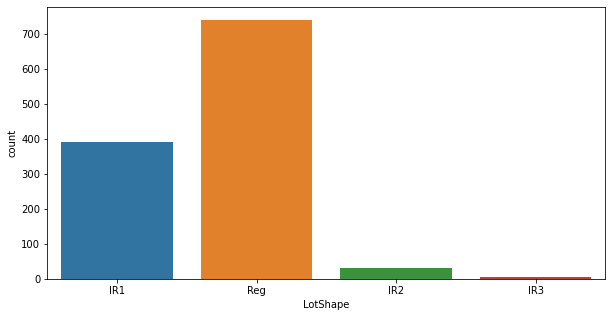

Lvl    1046
Bnk      50
HLS      42
Low      30
Name: LandContour, dtype: int64


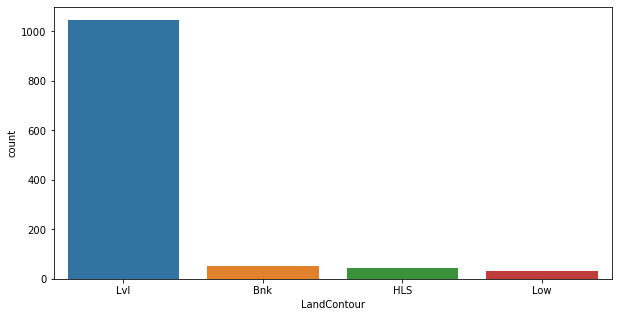

AllPub    1168
Name: Utilities, dtype: int64


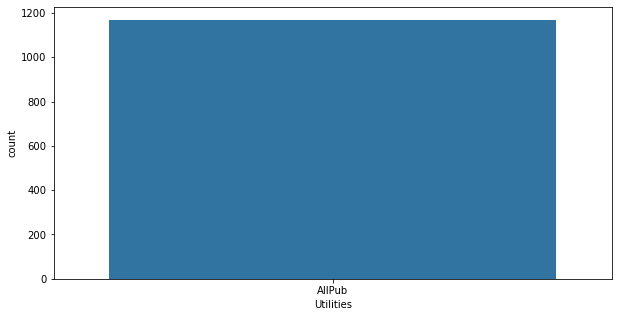

Inside     842
Corner     222
CulDSac     69
FR2         33
FR3          2
Name: LotConfig, dtype: int64


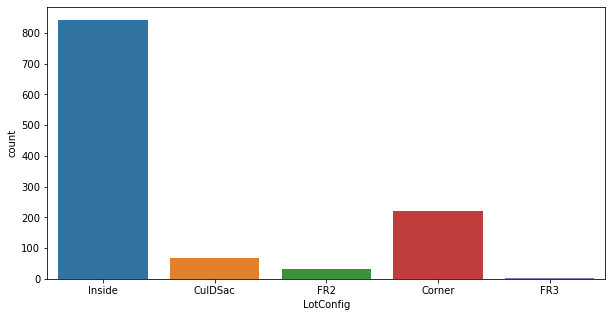

Gtl    1105
Mod      51
Sev      12
Name: LandSlope, dtype: int64


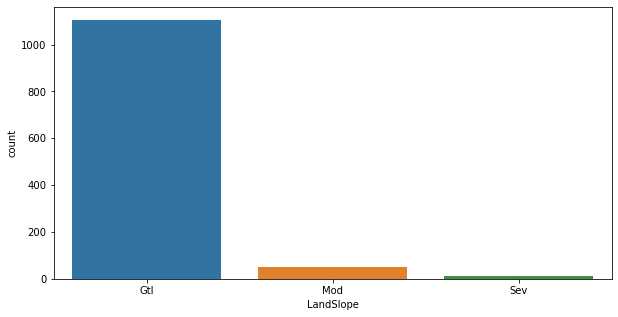

NAmes      182
CollgCr    118
OldTown     86
Edwards     83
Somerst     68
Gilbert     64
NridgHt     61
Sawyer      60
NWAmes      59
SawyerW     51
BrkSide     50
Crawfor     45
NoRidge     35
Mitchel     34
IDOTRR      30
Timber      24
ClearCr     24
SWISU       21
StoneBr     19
Blmngtn     15
BrDale      11
MeadowV      9
Veenker      9
NPkVill      8
Blueste      2
Name: Neighborhood, dtype: int64


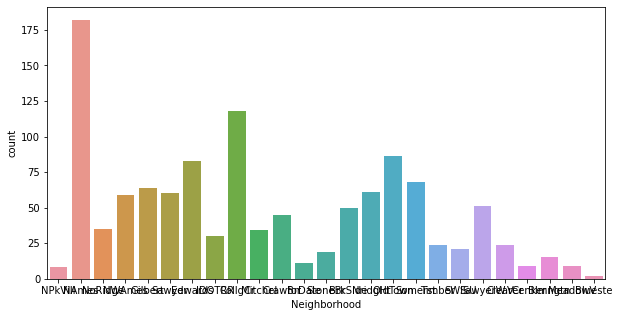

Norm      1005
Feedr       67
Artery      38
RRAn        20
PosN        17
RRAe         9
PosA         6
RRNn         4
RRNe         2
Name: Condition1, dtype: int64


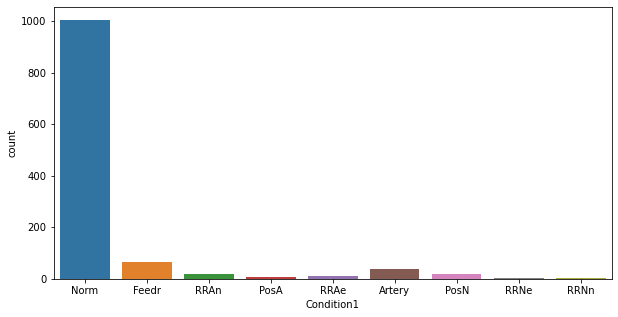

Norm      1154
Feedr        6
PosN         2
Artery       2
RRAe         1
RRNn         1
PosA         1
RRAn         1
Name: Condition2, dtype: int64


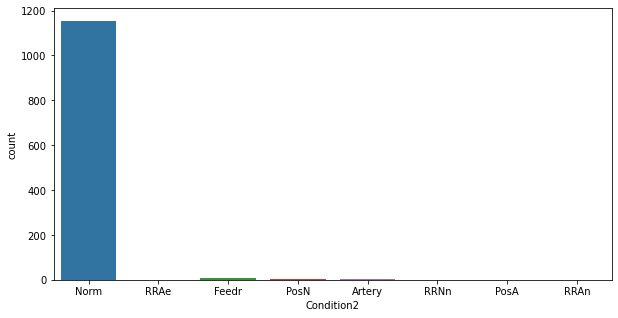

1Fam      981
TwnhsE     90
Duplex     41
Twnhs      29
2fmCon     27
Name: BldgType, dtype: int64


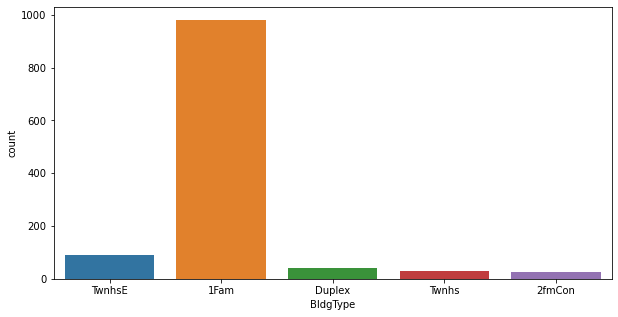

1Story    578
2Story    361
1.5Fin    121
SLvl       47
SFoyer     32
1.5Unf     12
2.5Unf     10
2.5Fin      7
Name: HouseStyle, dtype: int64


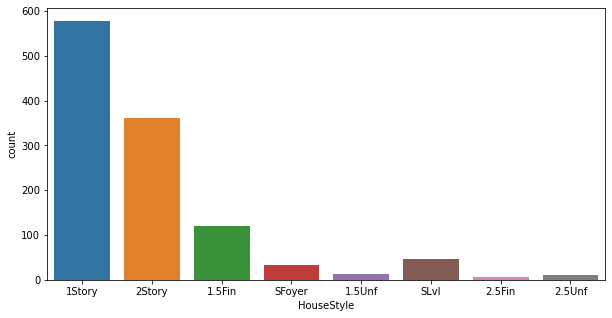

Gable      915
Hip        225
Flat        12
Gambrel      9
Mansard      5
Shed         2
Name: RoofStyle, dtype: int64


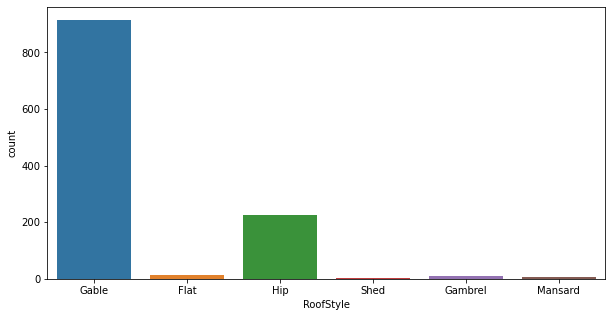

CompShg    1144
Tar&Grv      10
WdShngl       6
WdShake       4
Roll          1
ClyTile       1
Metal         1
Membran       1
Name: RoofMatl, dtype: int64


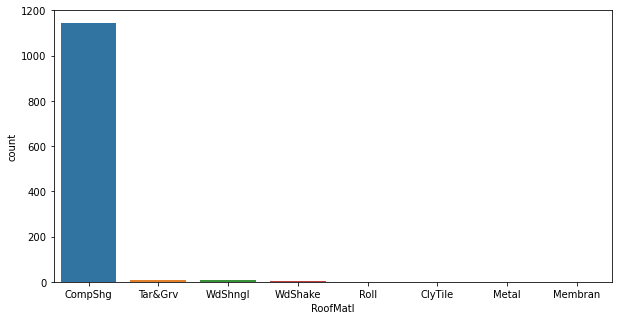

VinylSd    396
HdBoard    179
MetalSd    178
Wd Sdng    174
Plywood     93
CemntBd     42
BrkFace     41
Stucco      22
WdShing     19
AsbShng     19
Stone        2
AsphShn      1
ImStucc      1
BrkComm      1
Name: Exterior1st, dtype: int64


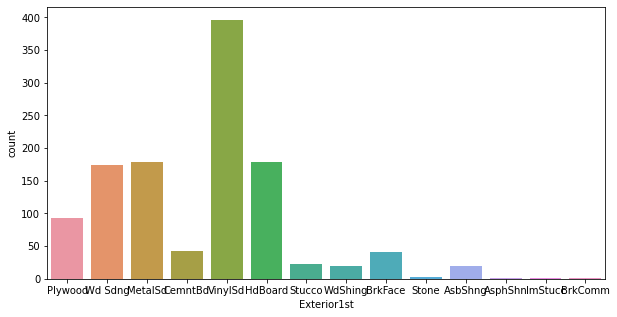

VinylSd    387
MetalSd    173
HdBoard    170
Wd Sdng    165
Plywood    118
CmentBd     42
Wd Shng     31
Stucco      23
BrkFace     20
AsbShng     18
ImStucc      8
Brk Cmn      5
Stone        4
AsphShn      3
Other        1
Name: Exterior2nd, dtype: int64


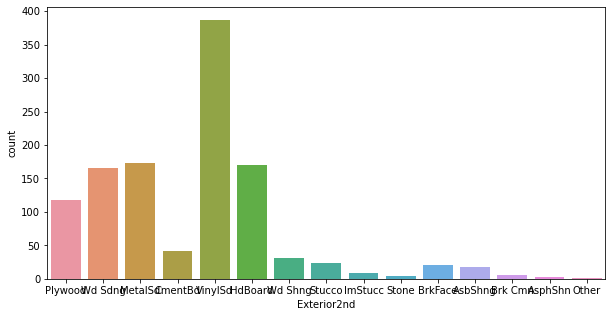

None       703
BrkFace    354
Stone       98
BrkCmn      13
Name: MasVnrType, dtype: int64


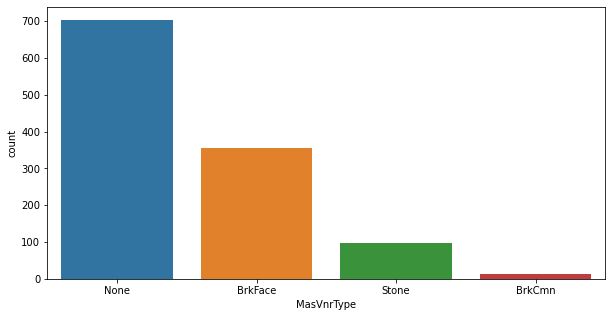

TA    717
Gd    397
Ex     43
Fa     11
Name: ExterQual, dtype: int64


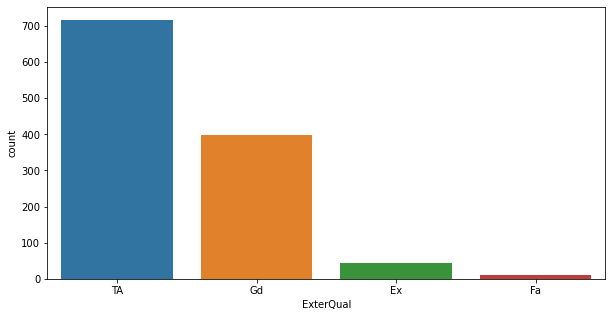

TA    1022
Gd     117
Fa      26
Ex       2
Po       1
Name: ExterCond, dtype: int64


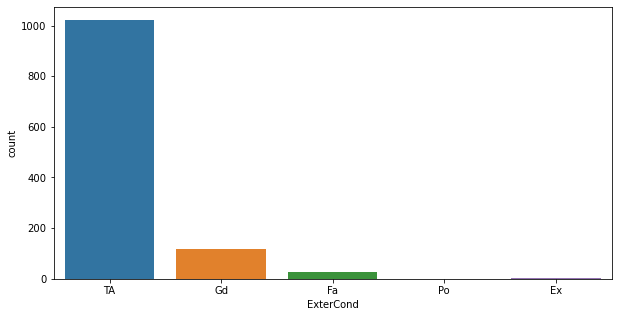

CBlock    516
PConc     513
BrkTil    112
Slab       21
Stone       5
Wood        1
Name: Foundation, dtype: int64


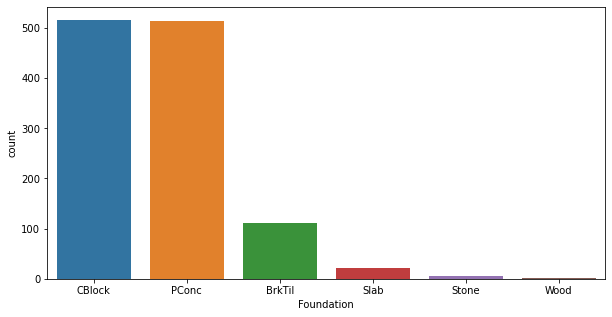

TA    547
Gd    498
Ex     94
Fa     29
Name: BsmtQual, dtype: int64


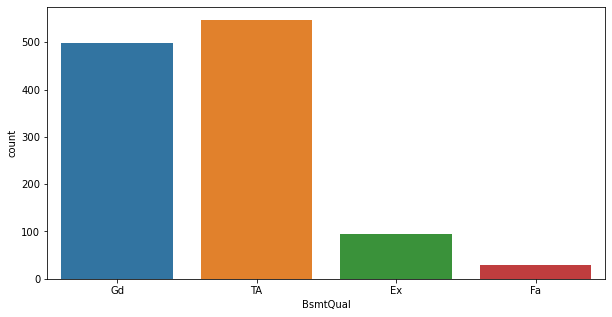

TA    1071
Gd      56
Fa      39
Po       2
Name: BsmtCond, dtype: int64


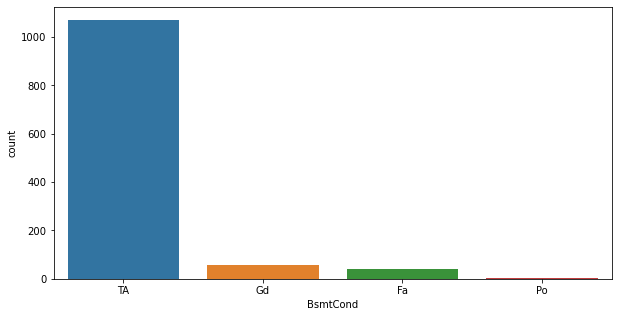

No    787
Av    180
Gd    108
Mn     93
Name: BsmtExposure, dtype: int64


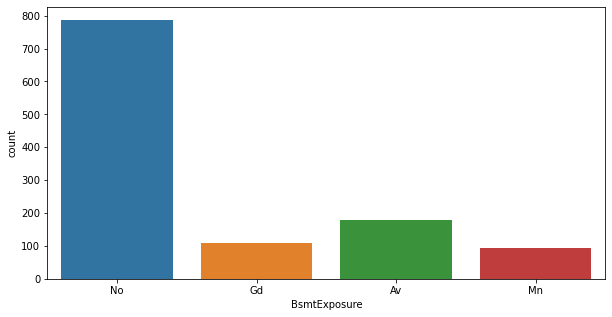

Unf    375
GLQ    330
ALQ    174
BLQ    121
Rec    109
LwQ     59
Name: BsmtFinType1, dtype: int64


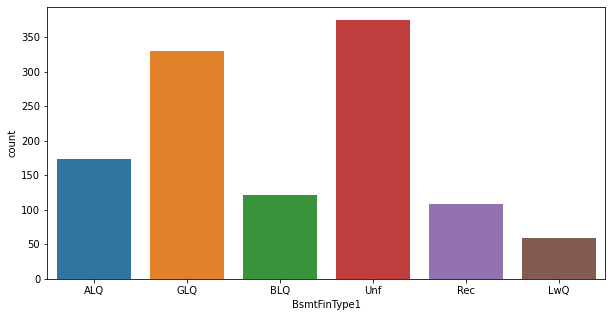

Unf    1033
Rec      43
LwQ      40
BLQ      24
ALQ      16
GLQ      12
Name: BsmtFinType2, dtype: int64


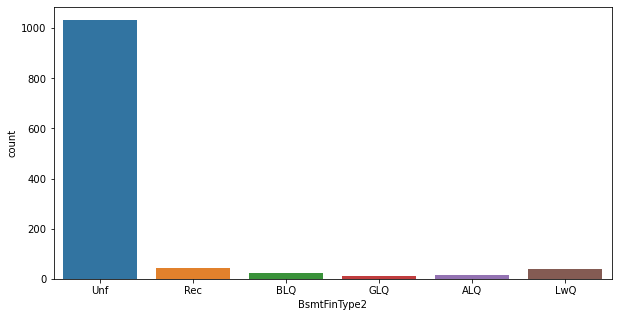

GasA     1143
GasW       14
Grav        5
Wall        4
Floor       1
OthW        1
Name: Heating, dtype: int64


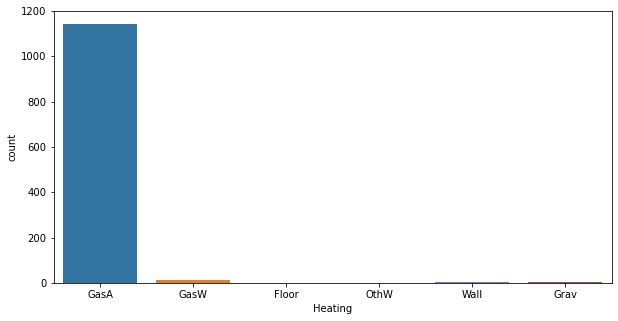

Ex    585
TA    352
Gd    192
Fa     38
Po      1
Name: HeatingQC, dtype: int64


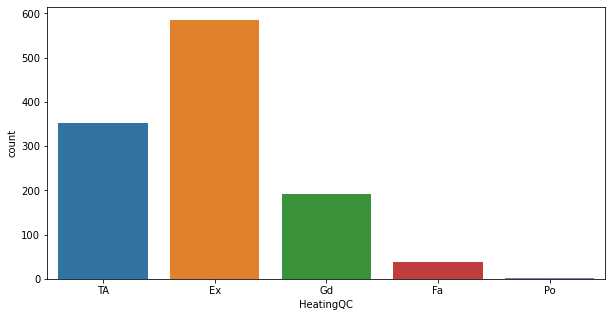

Y    1090
N      78
Name: CentralAir, dtype: int64


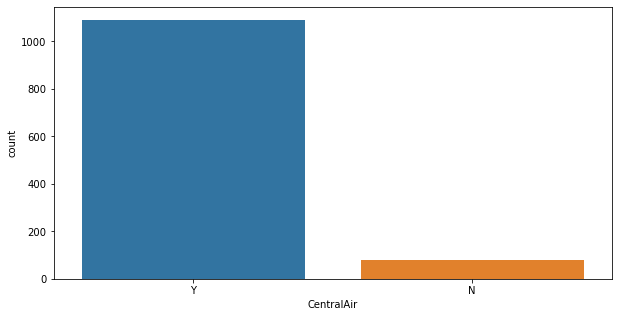

SBrkr    1070
FuseA      74
FuseF      21
FuseP       2
Mix         1
Name: Electrical, dtype: int64


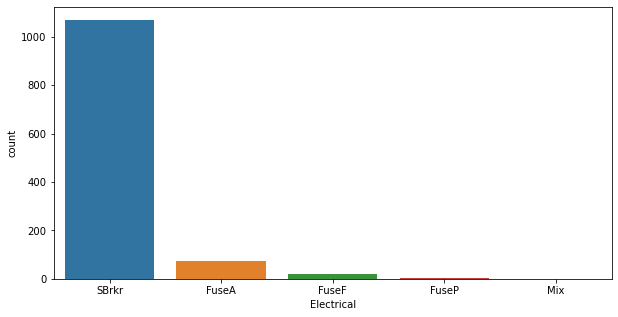

TA    578
Gd    478
Ex     82
Fa     30
Name: KitchenQual, dtype: int64


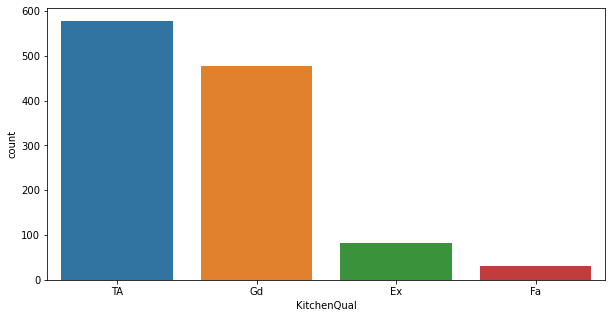

Typ     1085
Min2      30
Min1      25
Mod       12
Maj1      11
Maj2       4
Sev        1
Name: Functional, dtype: int64


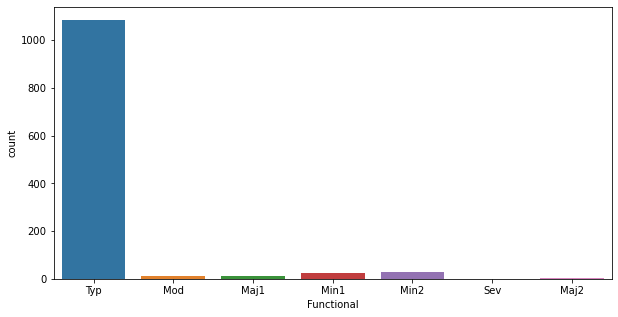

Gd    852
TA    252
Fa     25
Ex     21
Po     18
Name: FireplaceQu, dtype: int64


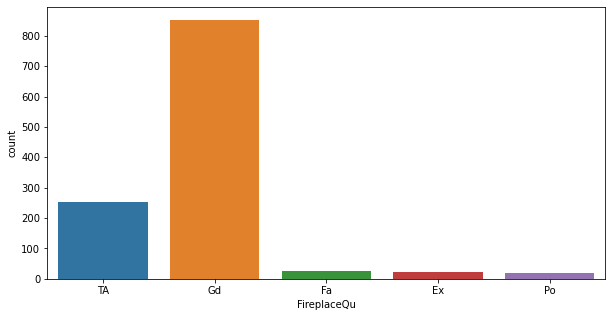

Attchd     755
Detchd     314
BuiltIn     70
Basment     16
CarPort      8
2Types       5
Name: GarageType, dtype: int64


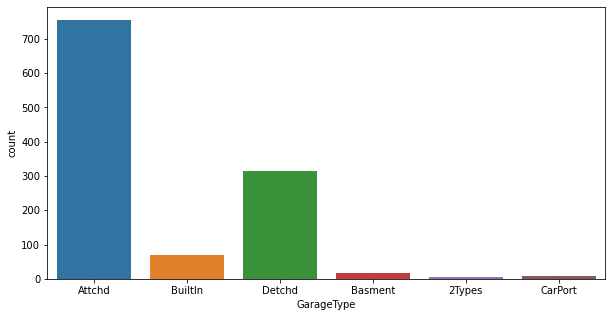

Unf    551
RFn    339
Fin    278
Name: GarageFinish, dtype: int64


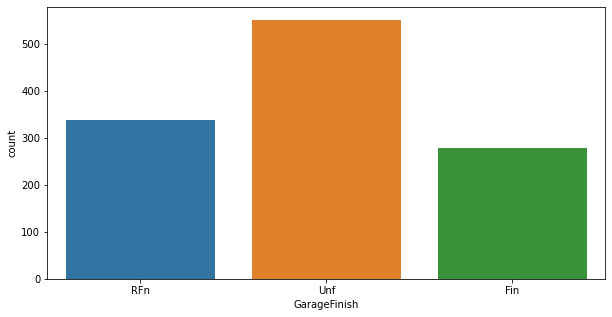

TA    1114
Fa      39
Gd      11
Ex       2
Po       2
Name: GarageQual, dtype: int64


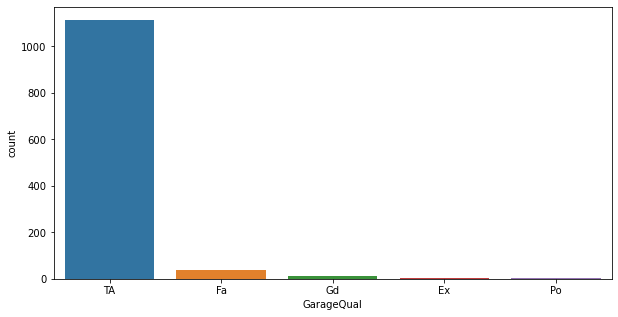

TA    1125
Fa      28
Gd       8
Po       6
Ex       1
Name: GarageCond, dtype: int64


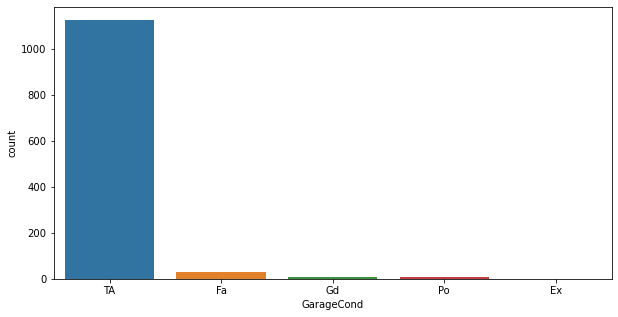

Y    1071
N      74
P      23
Name: PavedDrive, dtype: int64


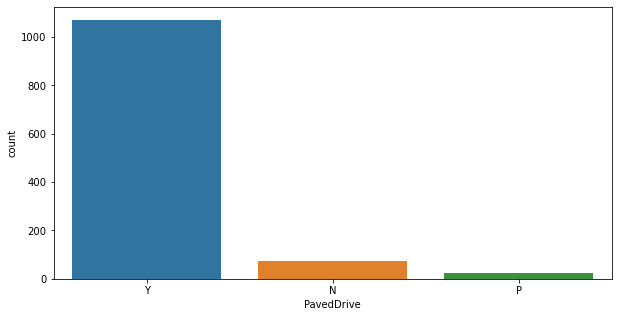

WD       999
New      106
COD       38
ConLD      8
ConLI      5
ConLw      4
Oth        3
CWD        3
Con        2
Name: SaleType, dtype: int64


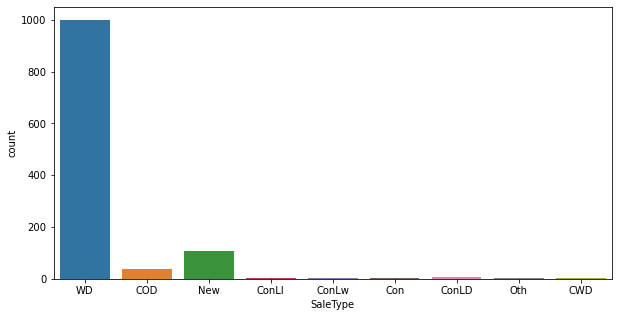

Normal     945
Partial    108
Abnorml     81
Family      18
Alloca      12
AdjLand      4
Name: SaleCondition, dtype: int64


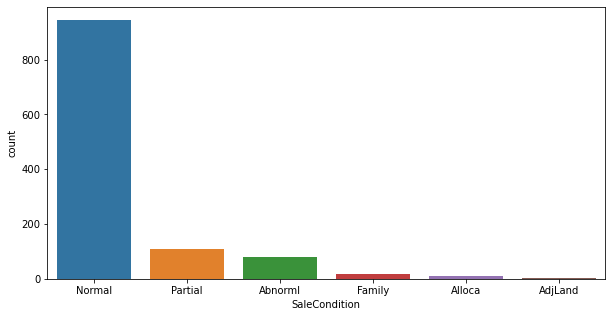

In [171]:
#plotting countplot for cat_features
for i in cat_features:
    print(data[i].value_counts())
    plt.figure(figsize=(10,5))
    sns.countplot(x=data[i],data=data)
    plt.show()

**Observation**
* **Avove plots are the counts plots for categorical features.**

* **Residential Low Density count is high as compare to other MSZoning**
* **In the Stree Pave count is high, in increase of sales it also depends on the type of street**
* **In the general shape of the property, the regural shape has the maximum count, Single Regular count is also little high next to regular shape.**
* **If we see the flatness of the property, the property which is having the Near Flat level has maximum count. In the Depression flatness of propery has very less count.**
* **In the lot configuration, inside lot configuration has the maximum count.**
* **In the slope of propety, the gentle slope has the maximum count.**
* **In the Neighborhood: Physical locations within Ames city limits, NAMES has the maximum count as compare to others.**
* **In Condition1, proximity to various condition the normal condition has the maximum count. Many people to have normal proximity condition. So, its count is high.**
* **In Condition2, Proximity to various conditions (if more than one is present) also people prefer the normal condition. So, it has the maximum count.**
* **In BldgType, the type of dwelling, 1 Farm-Single Family Detached has the maximum count.**
* **For Vinyl Siding exterior-2 covering on house has maximum counts for the feature Exterior covering on house (if more than one material)(Exterior2nd).**

* **For Masonry veneer type(MasVnrType) None has maximum count.**
* **For Typical/Average(TA) quality of the material on the exterior has maximum count, for the feature Evaluates the quality of the material on the exterior (ExterQual).**
* **For Typical/Average(TA) condition of the material on the exterior has maximum count for the feature Evaluates the present condition of the material on the exterior(ExterCond).**
* **For Cinder Block and Poured Contrete foundations the count is maximum for the feature Type of foundation(Foundation).**
* **For good and average quality heights of the basement the count is high for the feature Evaluates the height of the basement(BsmtQual).**
* **For Typical/Average(TA) general condition of the basement the count is high for the feature Evaluates the general condition of the basement(BsmtCond)**
* **For No Exposure garden level walls the count is maximum for the feature Refers to walkout or garden level walls(BsmtExposure).**
* **For unfinished Rating of basement finished area-1 the count is maximum for the feature Rating of basement finished area(BsmtFinType1).**
* **For unfinished Rating of basement finished area-2 the count is maximum for the feature Rating of basement finished area (if multiple types)(BsmtFinType2).**
* **For Gas forced warm air furnace type of heating the count is maximum for the feature Type of heating(Heating).**
* **For Excellent Heating quality and condition the count is high for the feature Heating quality and condition(HeatingQC).**
* **For Central air conditioning-yes has maximum count for the feature Central air conditioning(CentralAir).**
* **For Standard Circuit Breakers & Romex Electrical system the count is high for the feature Electrical system(Electrical).**
* **For Typical/Average(TA) and good Kitchen quality the count is maximum for the feature Kitchen quality(KitchenQual).**
* **Typical Functionality has highest count for Home functionality (Assume typical unless deductions are warranted)(Functional).**
* **For good Fireplace quality the count is high for the feature Fireplace quality(FireplaceQu).**
* **If Garage location Attached to home then the count is high, for the feature Garage location(GarageType).**
* **For Unfinished Interior of the garage the count is maximum, for the feature Interior finish of the garage(GarageFinish).**
* **For Typical/Average(TA) Garage quality the count is high, for the feature Garage quality(GarageQual).**
* **For Typical/Average(TA) Garage condition the count is high, for the feature Garage condition(GarageCond).**
* **For Paved driveway the count is maximum, for the feature Paved driveway(PavedDrive).**
* **For Warranty Deed - Conventional type of sales the count is maximum, for the feature Type of sale(SaleType).**
* **For Normal sales condition the count is high, for the feature Condition of sale(SaleCondition).**

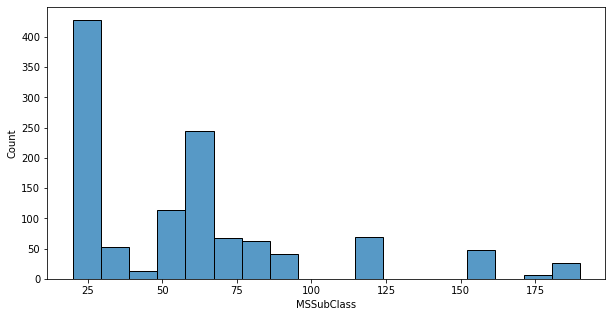

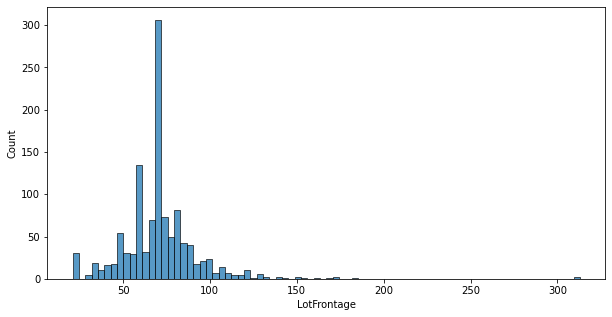

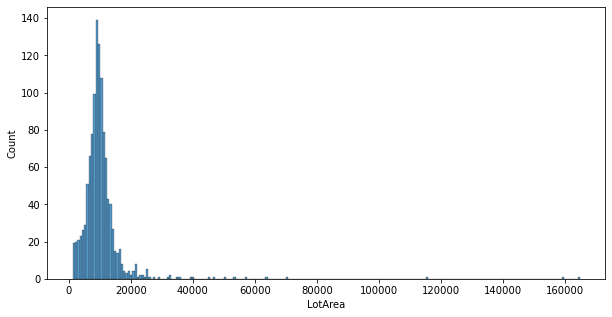

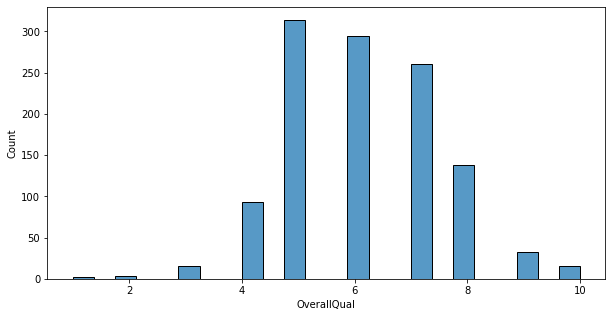

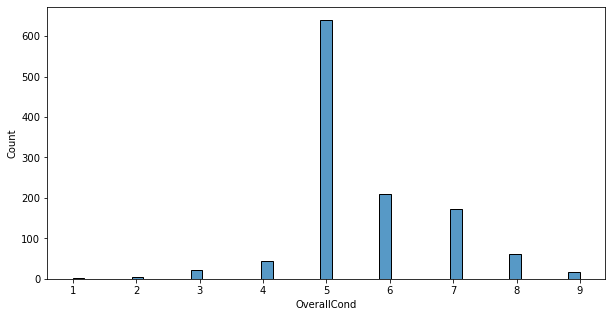

...

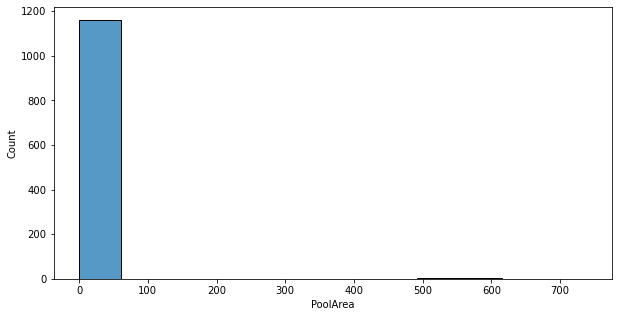

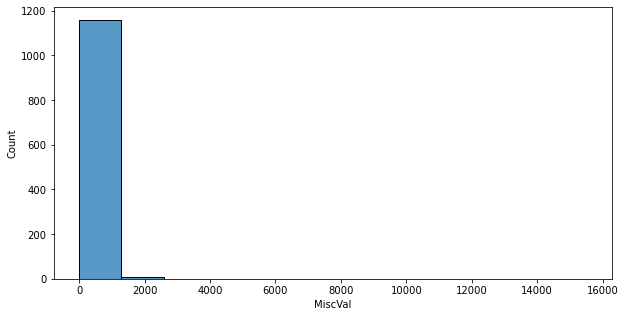

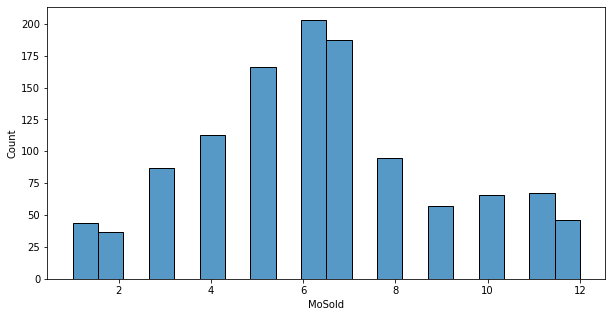

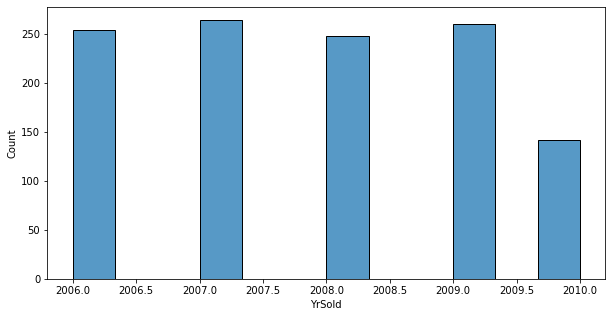

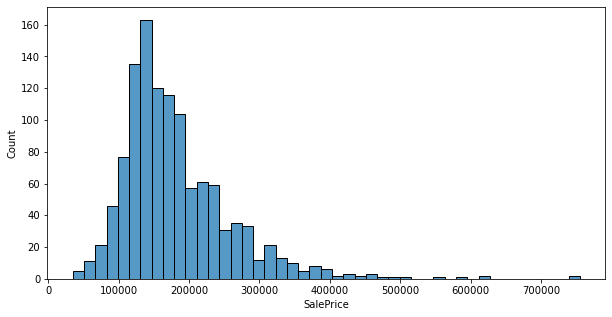

In [124]:
#plotting countplot for cont_features
for i in cont_features:
    plt.figure(figsize=(10,5))
    sns.histplot(x=data[i],data=data)
    plt.show()

**Above plots are the histogram plots for the continuous data.**

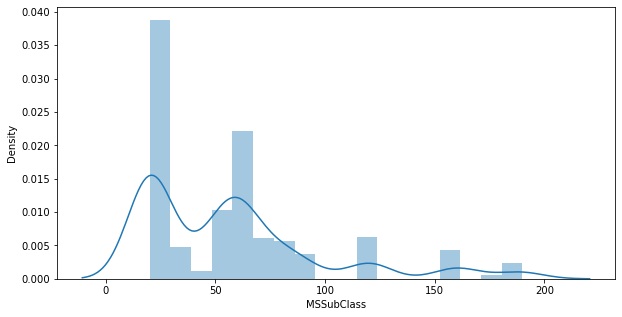

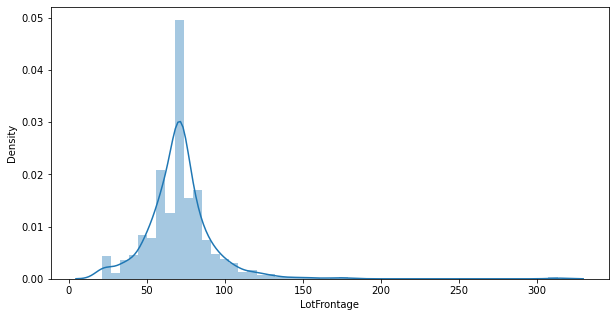

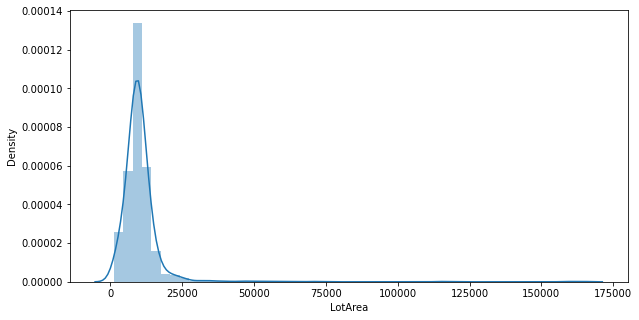

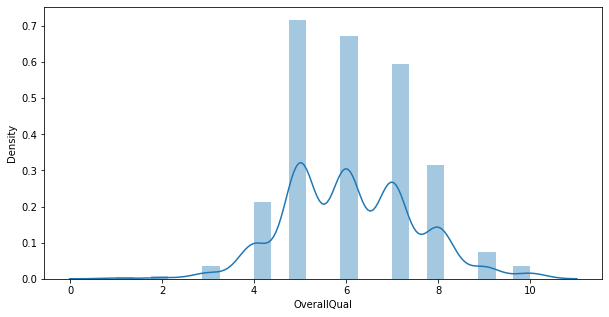

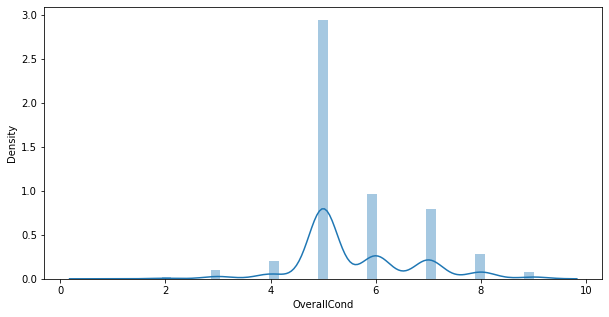

...

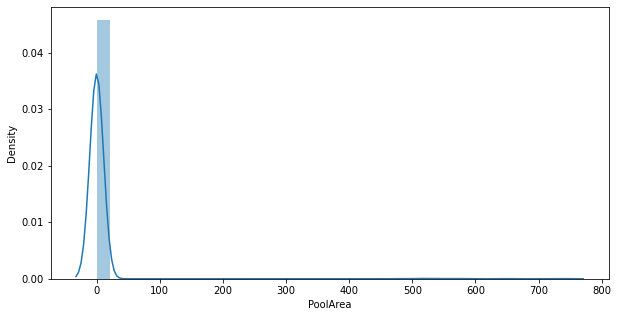

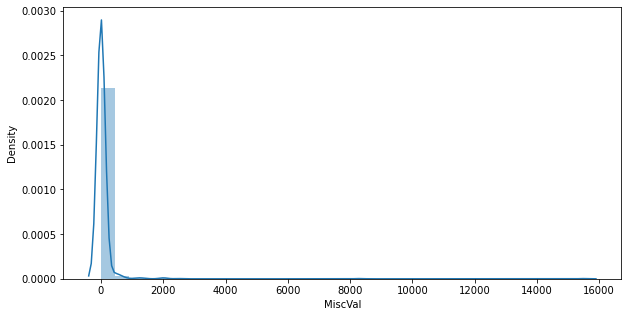

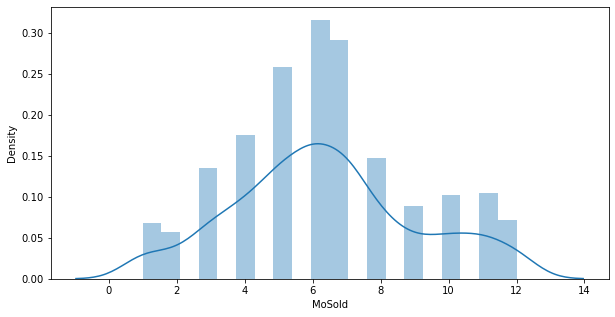

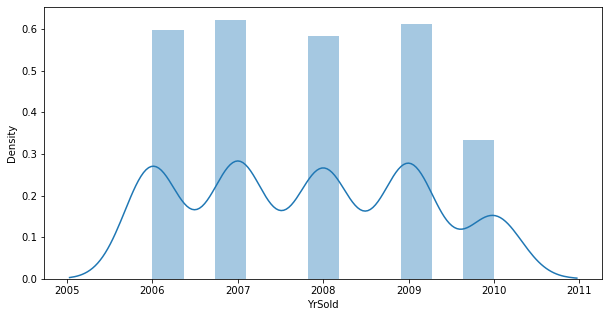

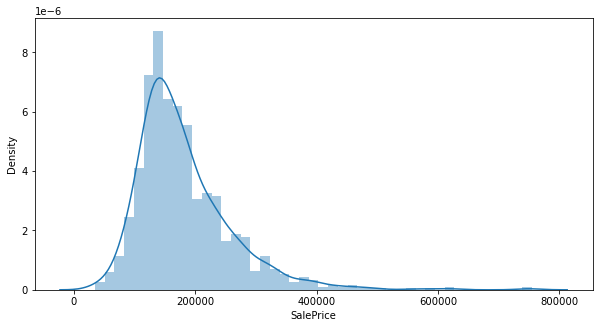

In [125]:
#plotting ditribution plot for continuous features
for i in cont_features:
    plt.figure(figsize=(10,5))
    sns.distplot(data[i],kde=True)
    plt.show()

**Observations**
* **Above plots are distribution plots for continuous data.**
* **In this we can see that almost in all the skewness is present,and data is not distributed normally.i may be wrong, so we will cross verify it while checking for skewness.**

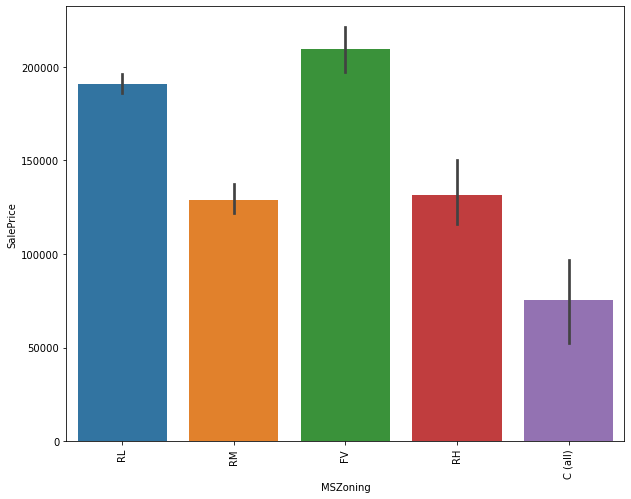

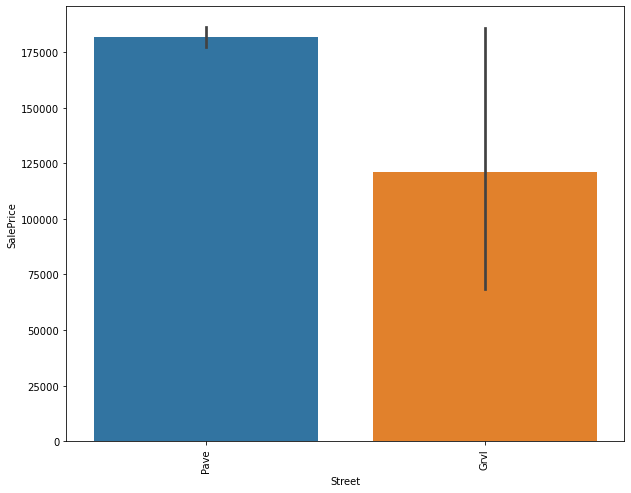

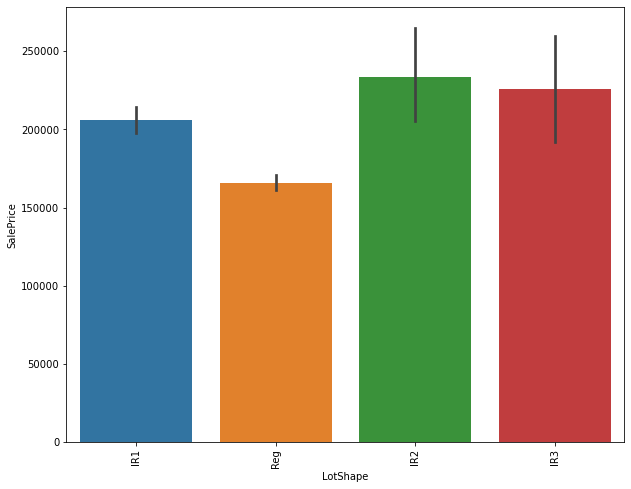

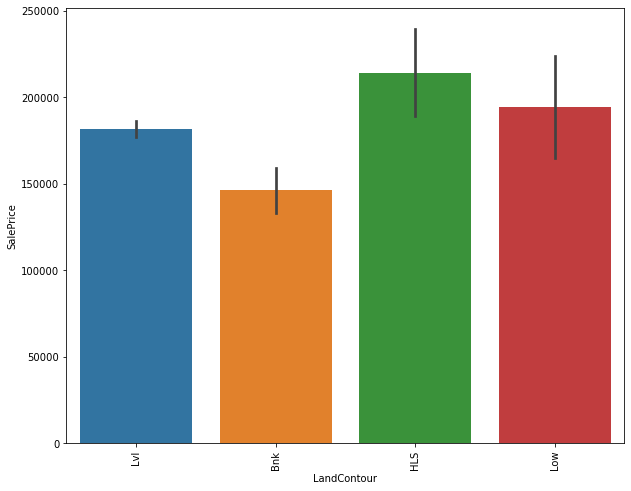

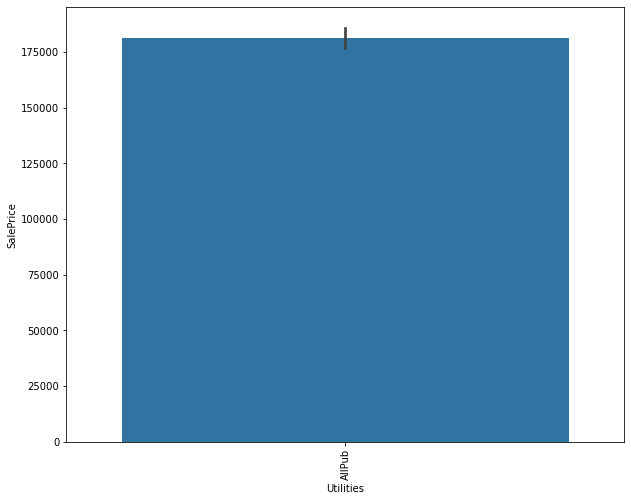

...

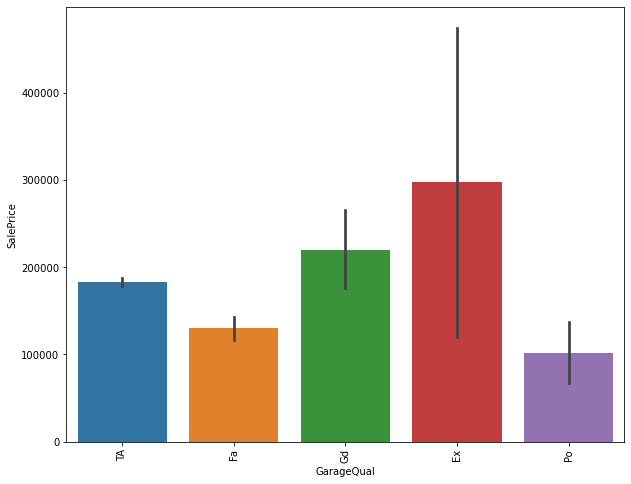

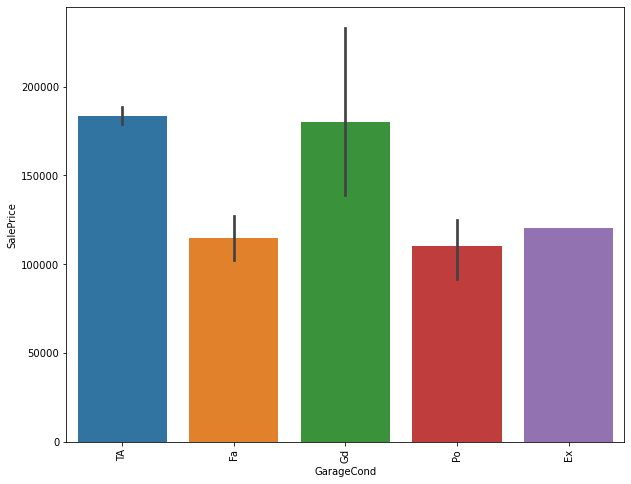

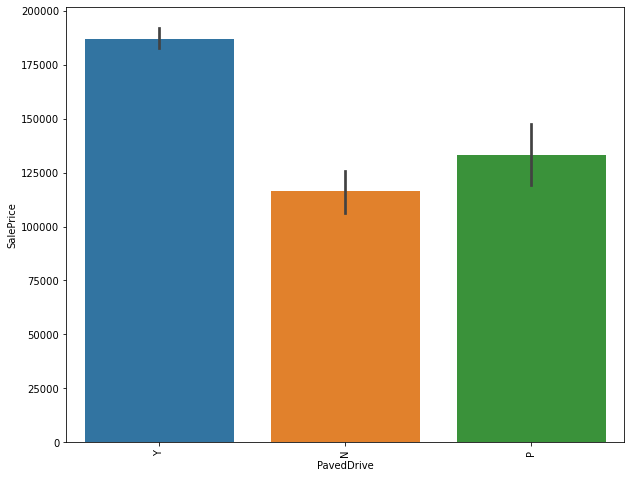

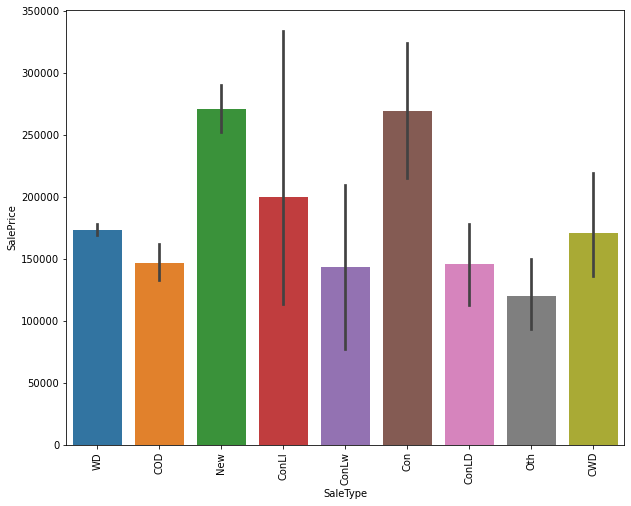

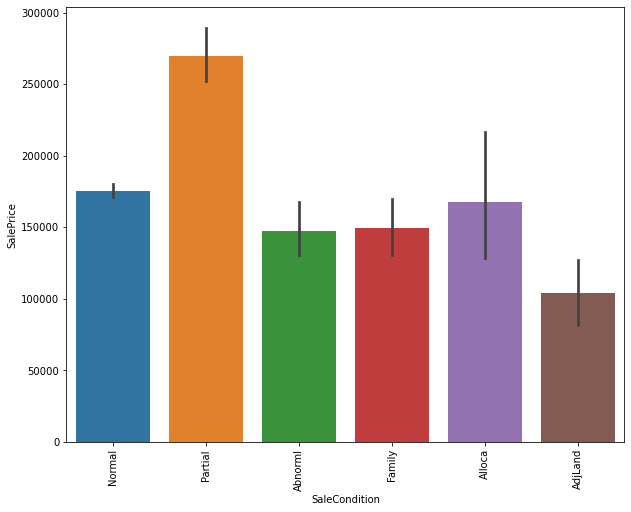

In [126]:
#plotting bar plot for categorical features with the label that is Sale price
for i in cat_features:
    plt.figure(figsize=(10,8))
    sns.barplot(x=data[i],y='SalePrice',data=data)
    plt.xticks(rotation='vertical')
    plt.show()

**Above plots are Bar plots for categorical features agains the label.**

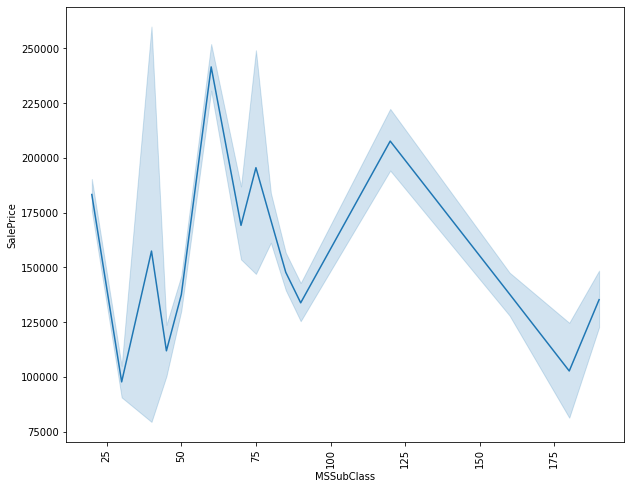

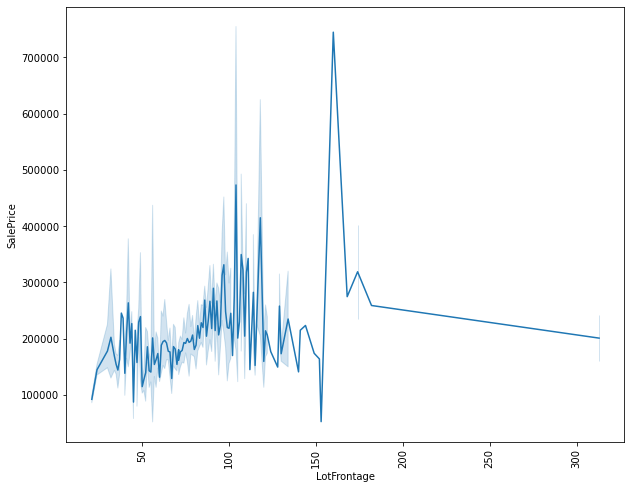

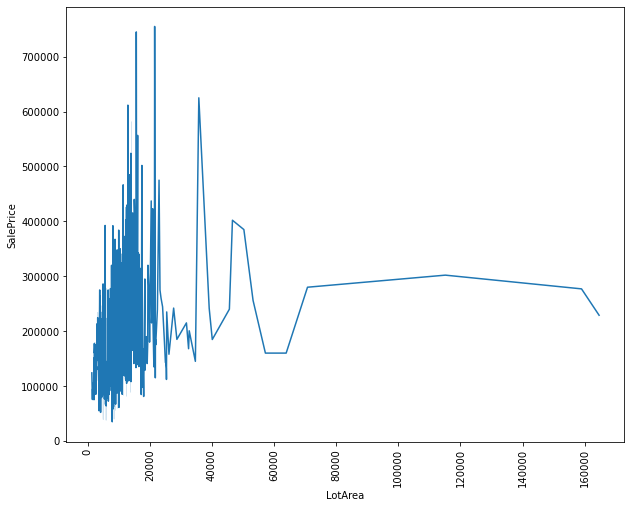

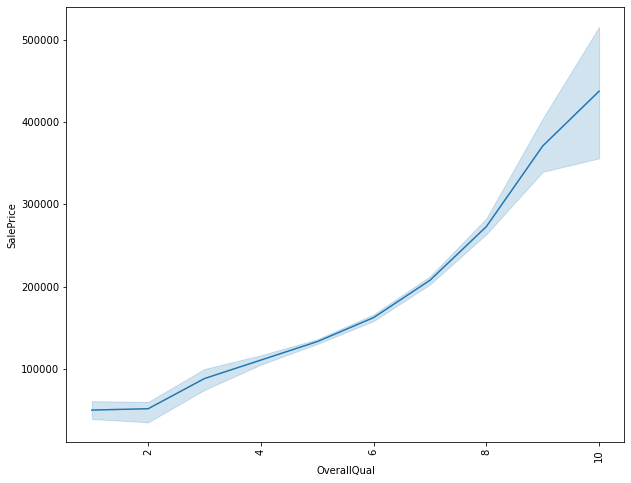

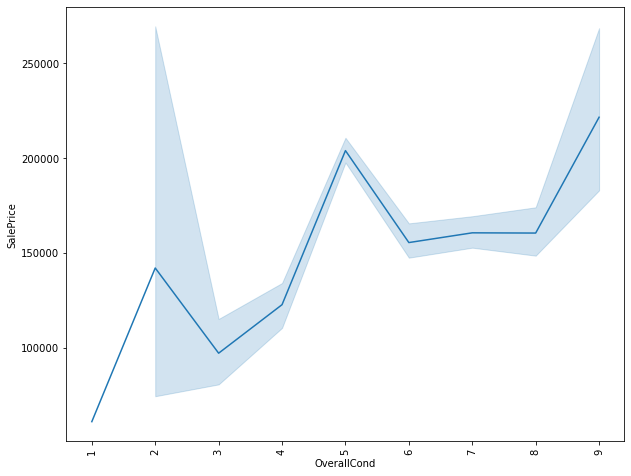

...

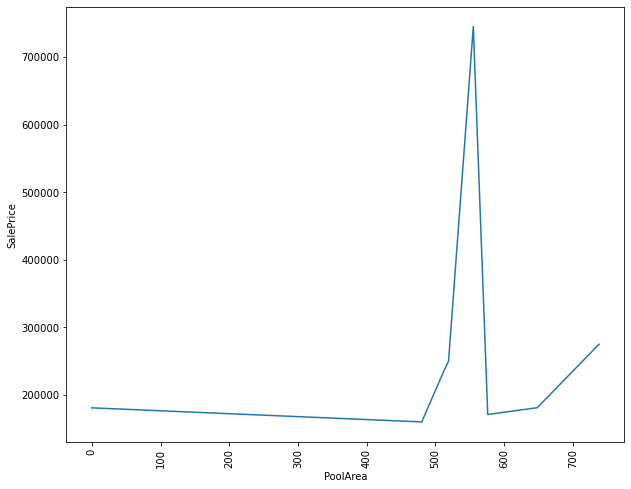

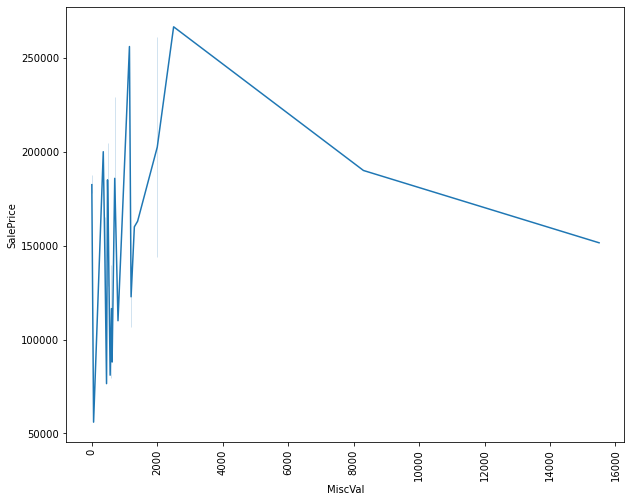

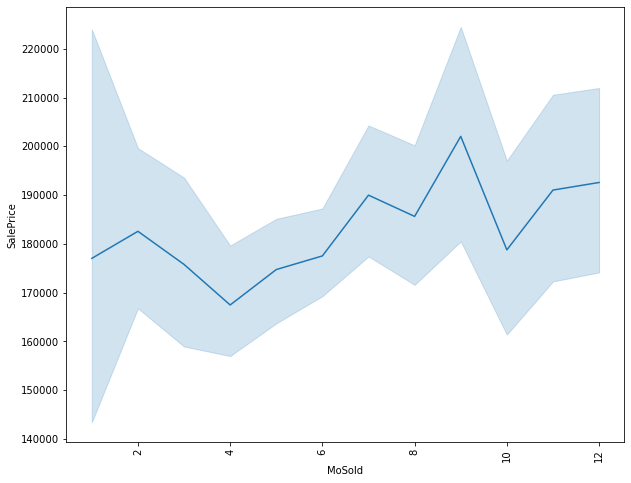

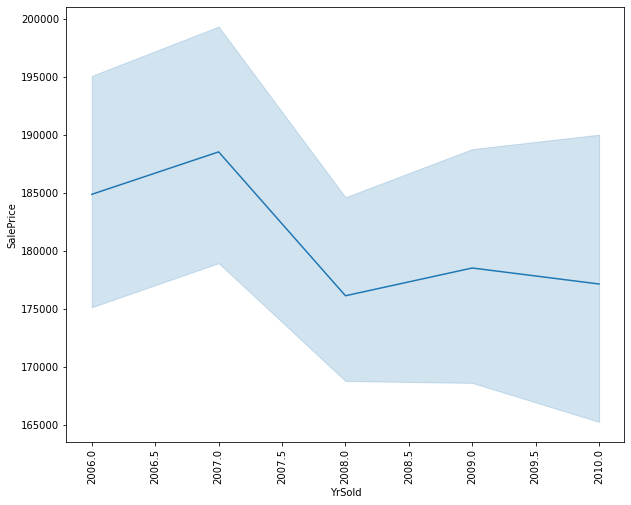

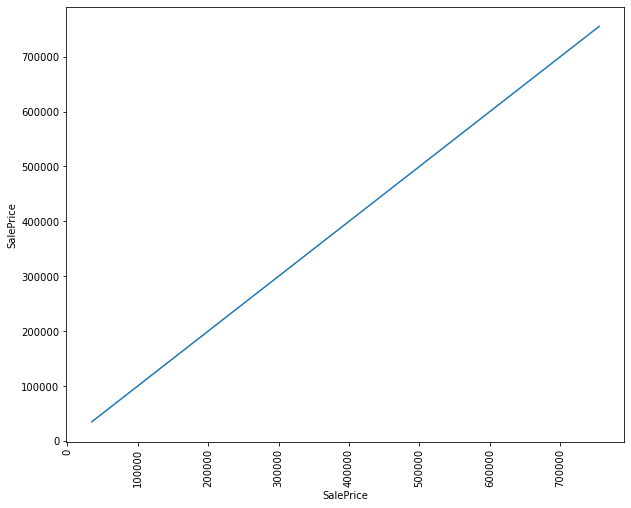

In [127]:
#plotting line plot for continuous features with the label that is Sale price
for i in cont_features:
    plt.figure(figsize=(10,8))
    sns.lineplot(x=data[i],y='SalePrice',data=data)
    plt.xticks(rotation='vertical')
    plt.show()

**Above plots are the line plots for continuous data against the label that is sale price.**

MSZoning


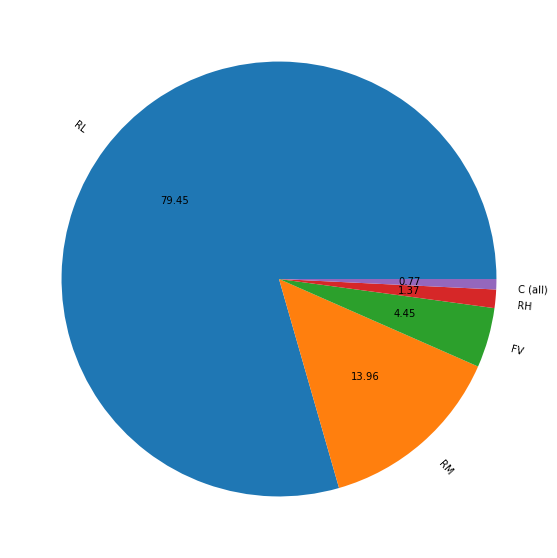

Street


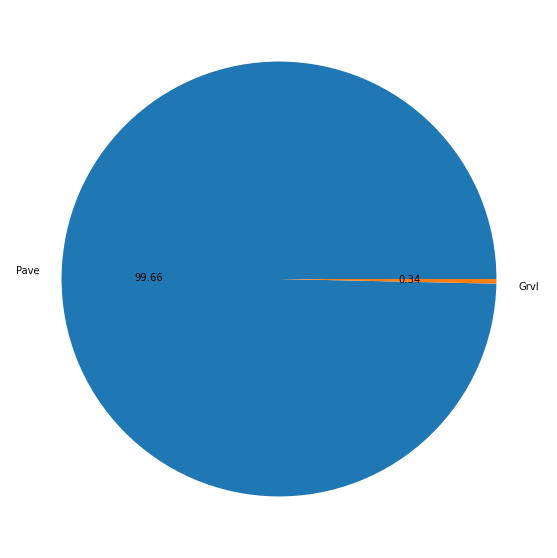

LotShape


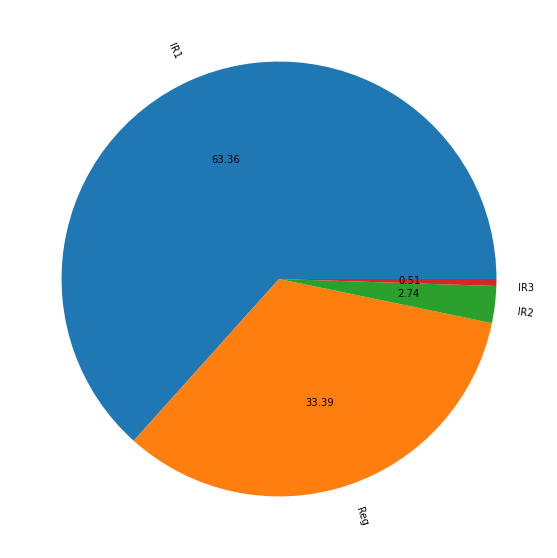

LandContour


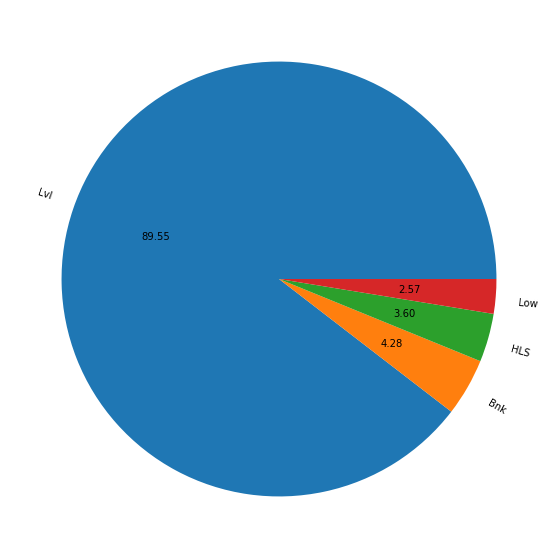

Utilities


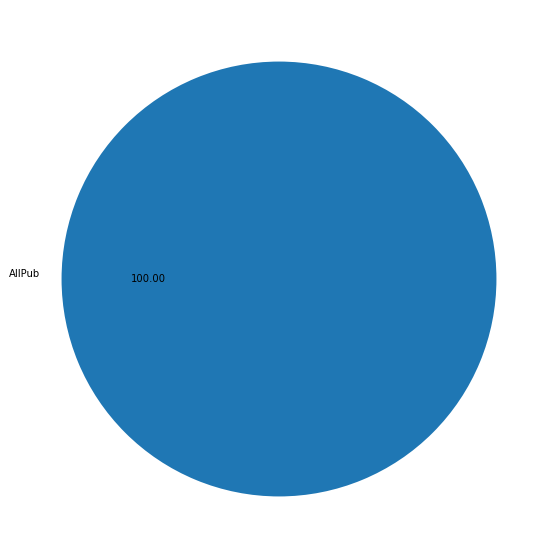

LotConfig


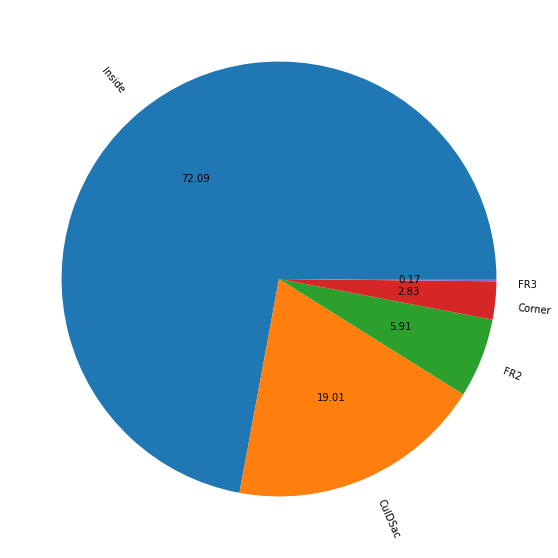

LandSlope


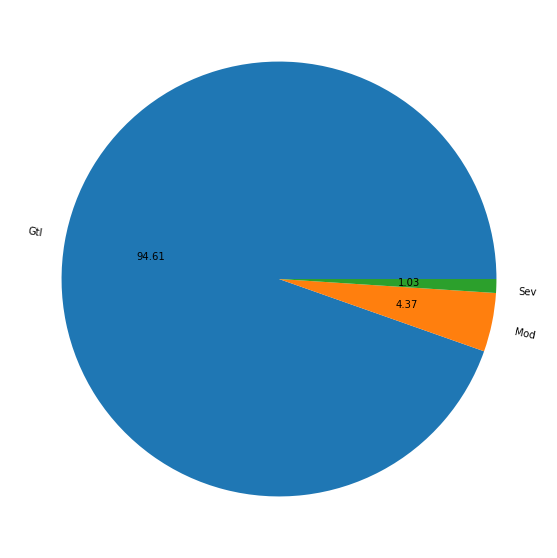

Neighborhood


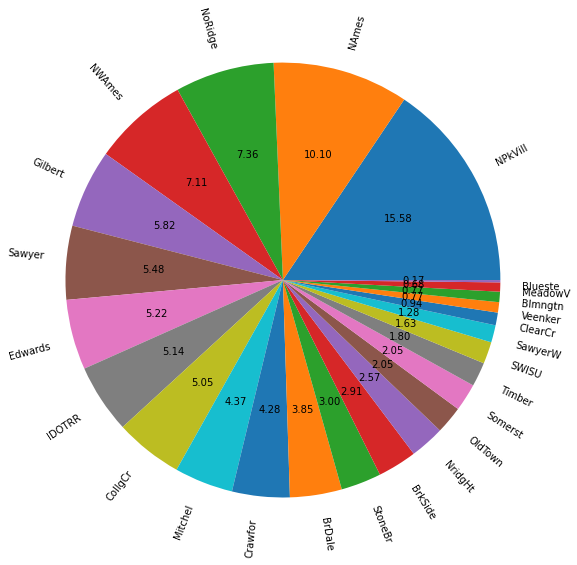

Condition1


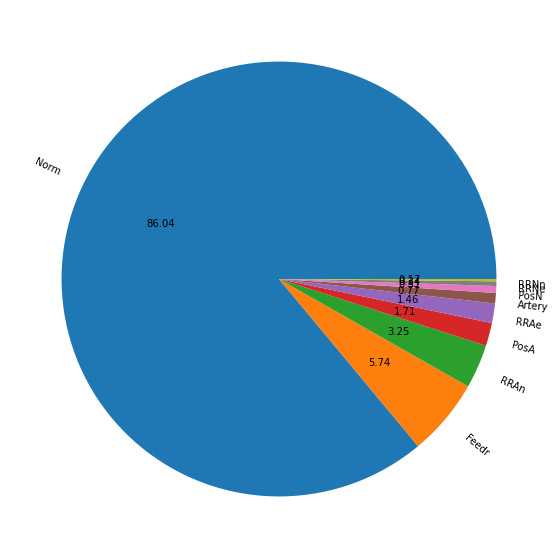

Condition2


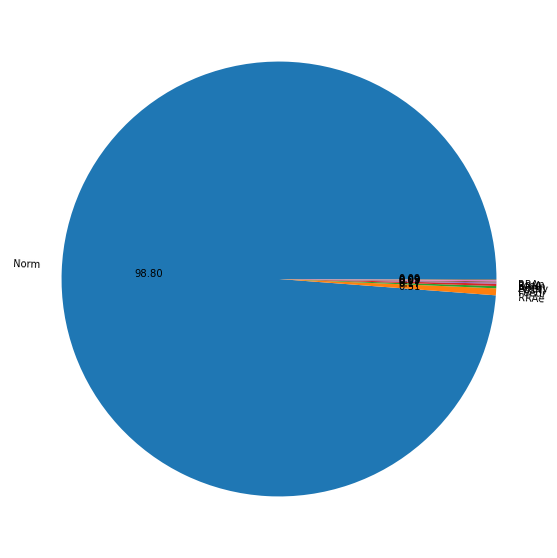

BldgType


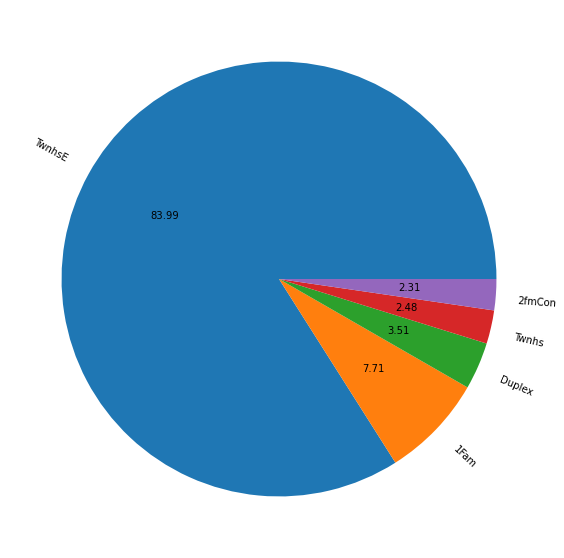

HouseStyle


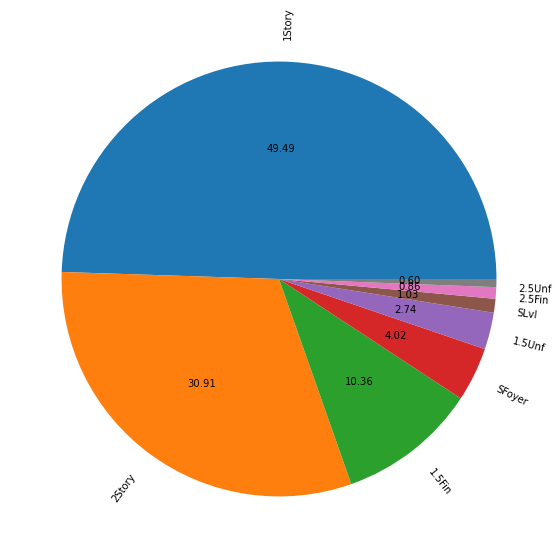

RoofStyle


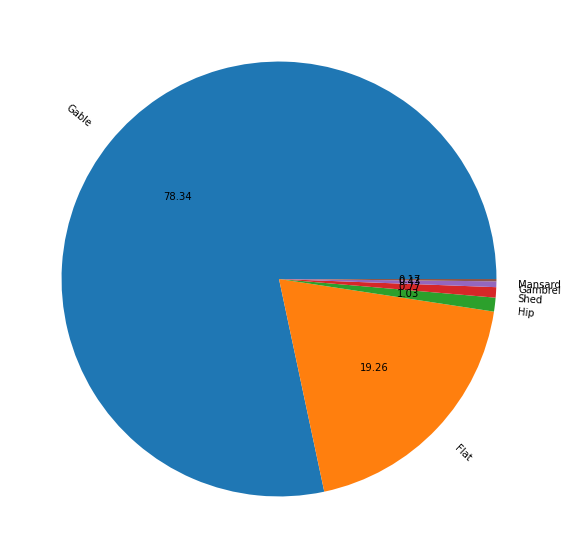

RoofMatl


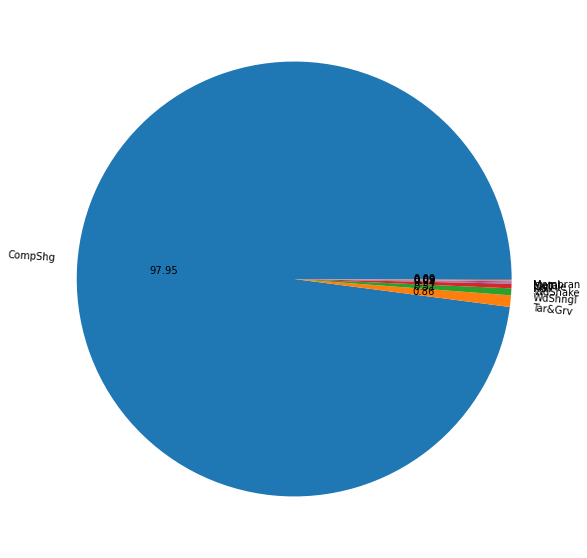

Exterior1st


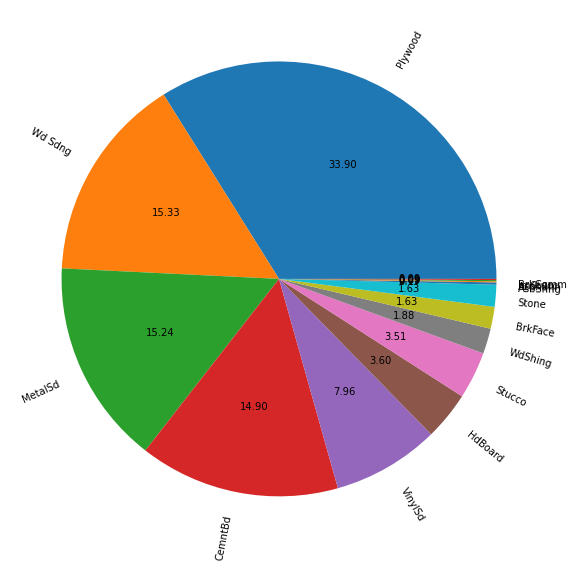

Exterior2nd


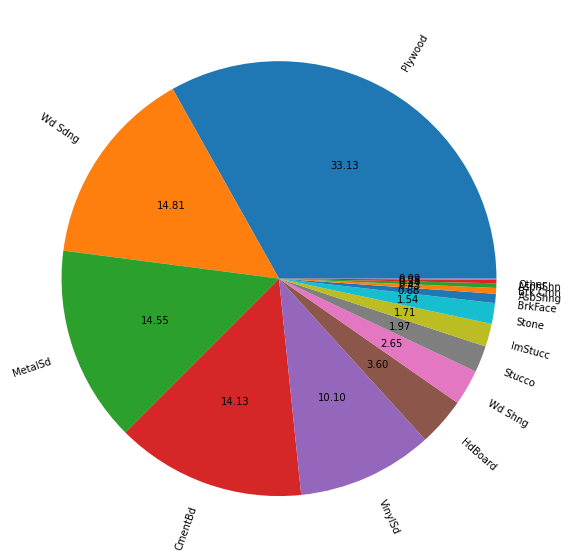

MasVnrType


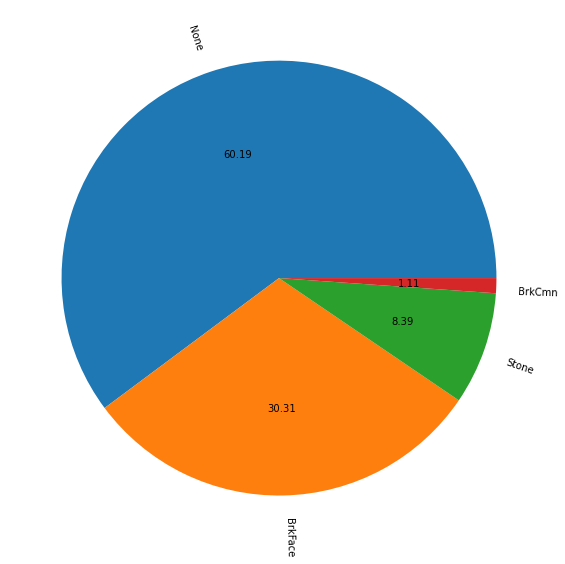

ExterQual


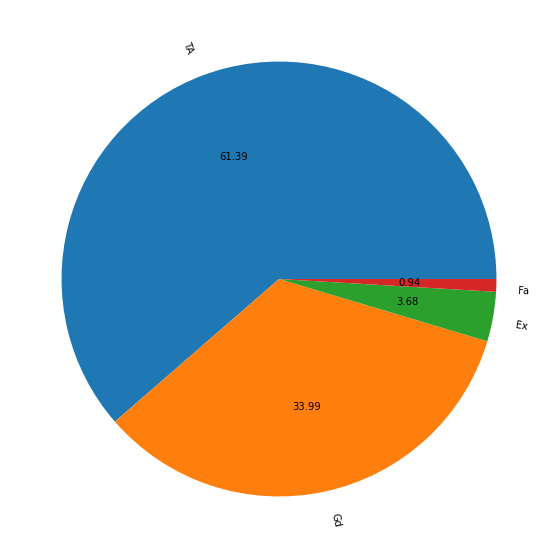

ExterCond


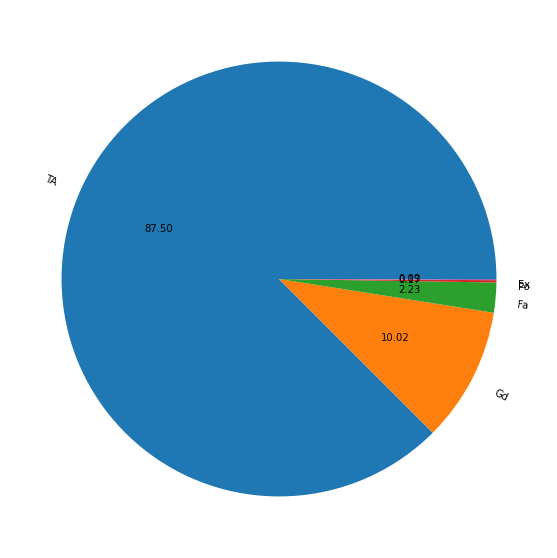

Foundation


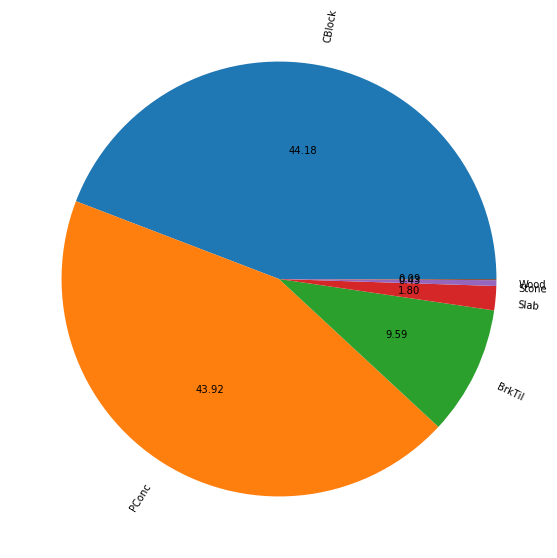

BsmtQual


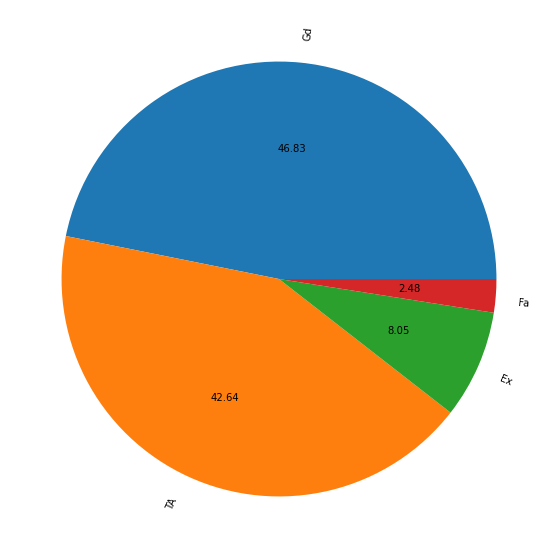

BsmtCond


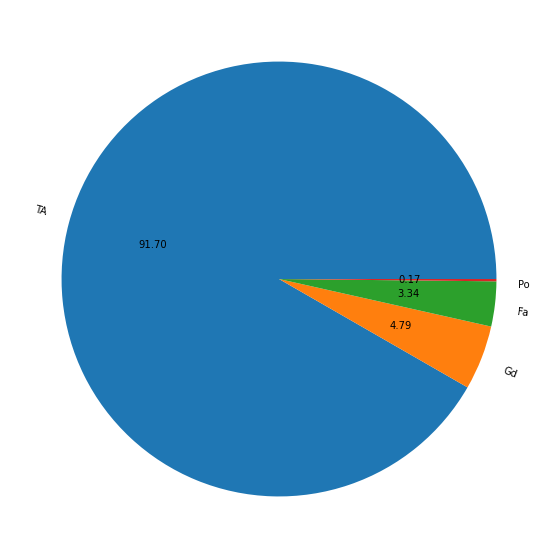

BsmtExposure


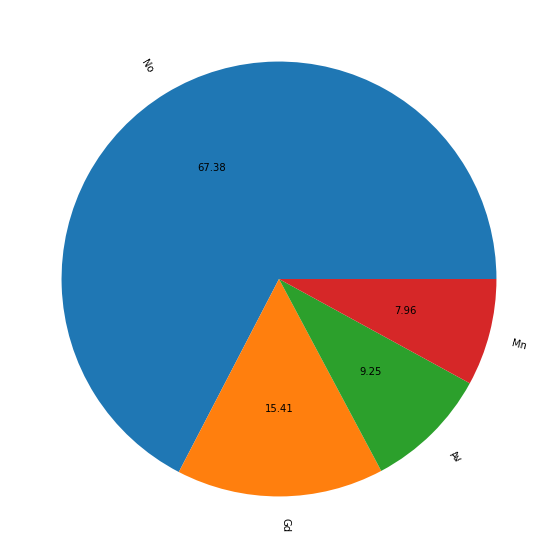

BsmtFinType1


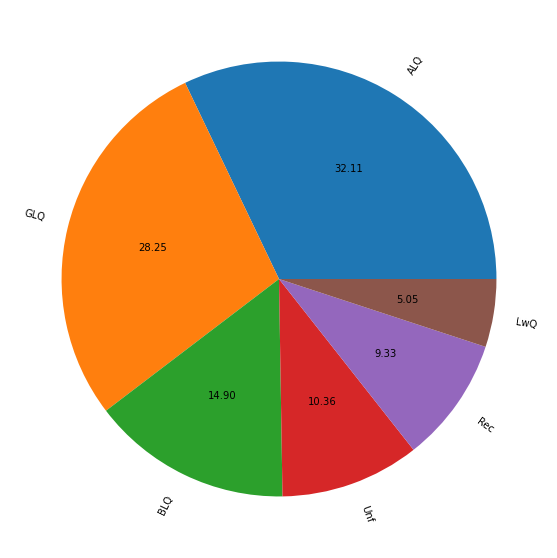

BsmtFinType2


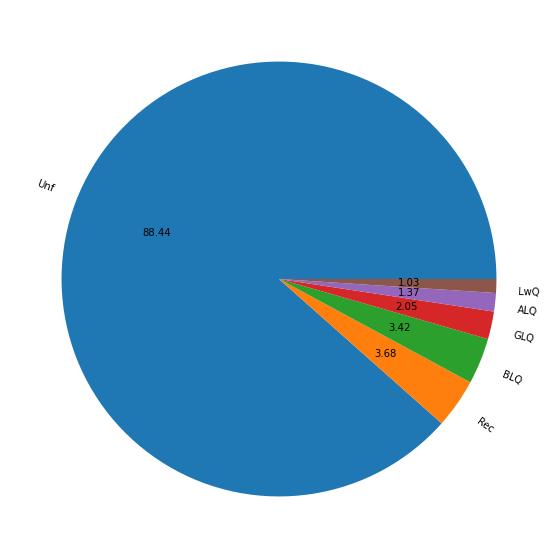

Heating


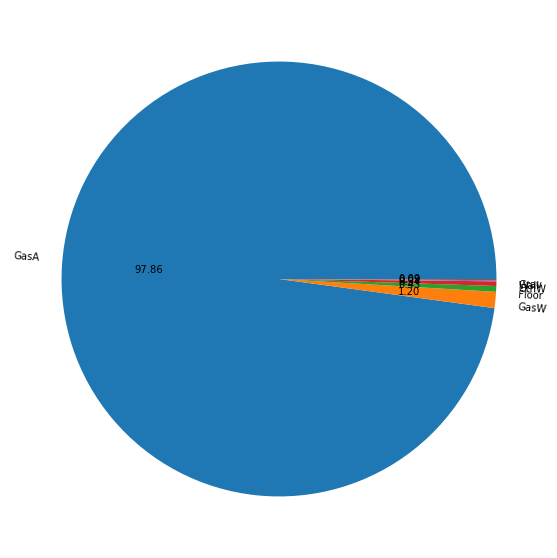

HeatingQC


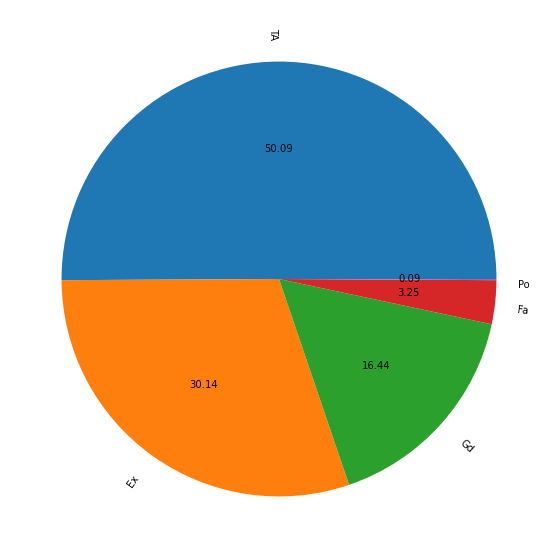

CentralAir


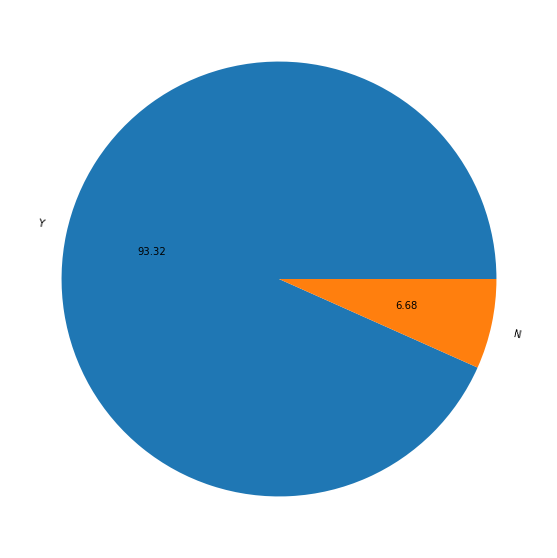

Electrical


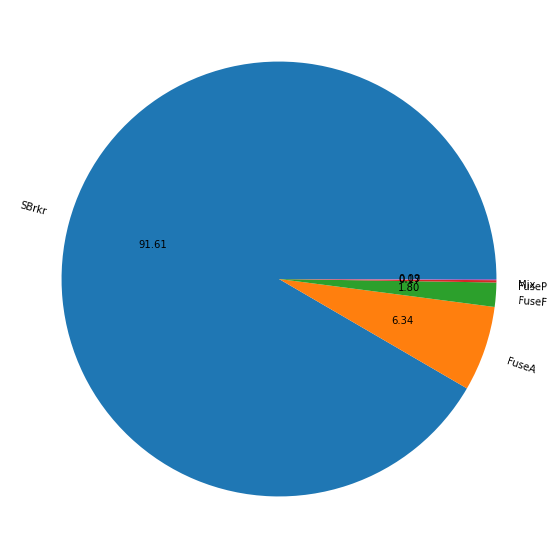

KitchenQual


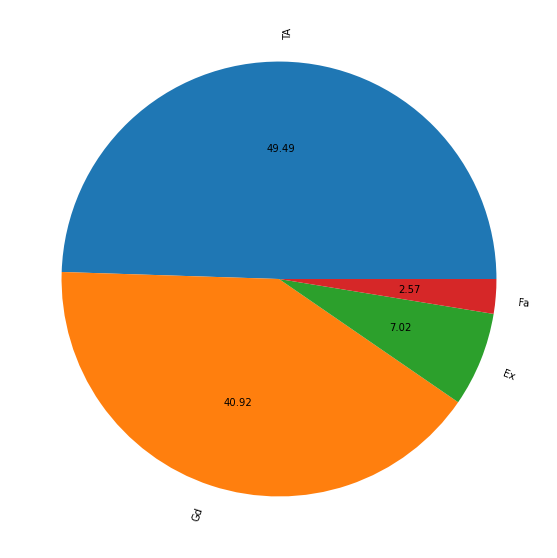

Functional


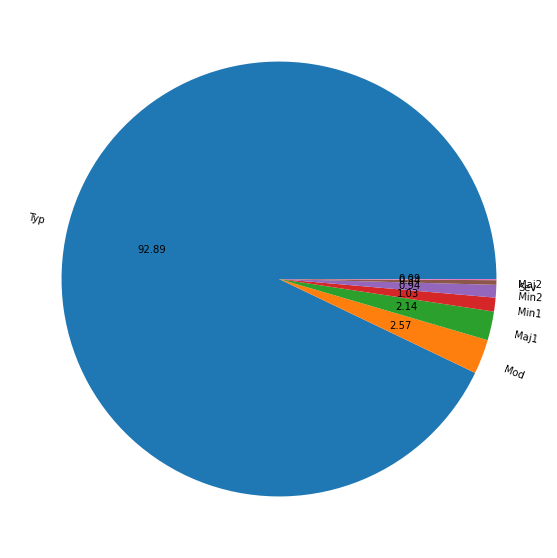

FireplaceQu


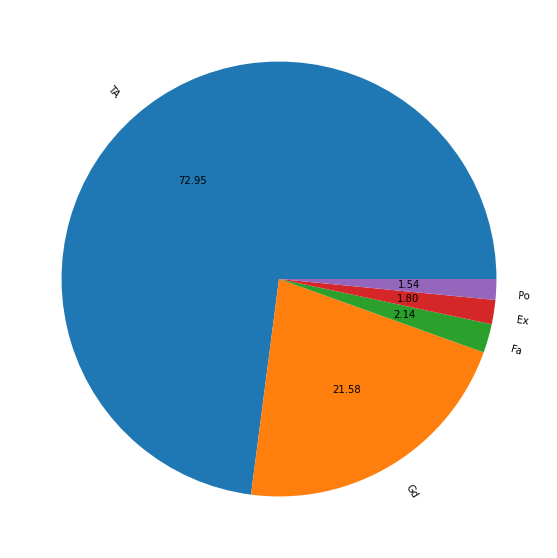

GarageType


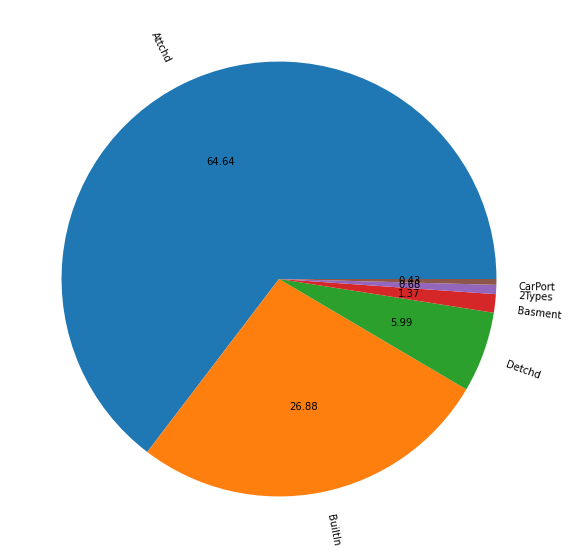

GarageFinish


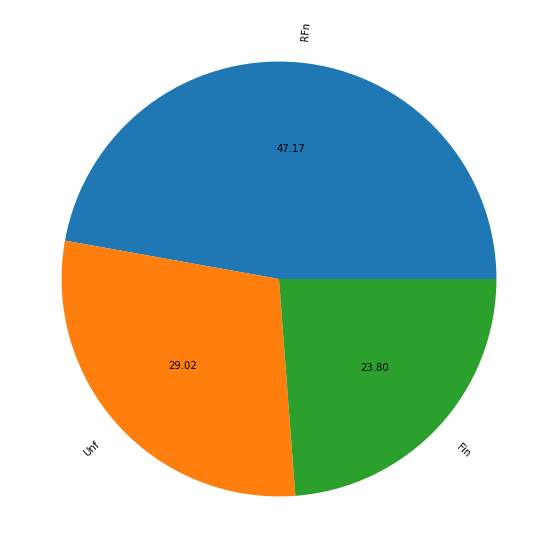

GarageQual


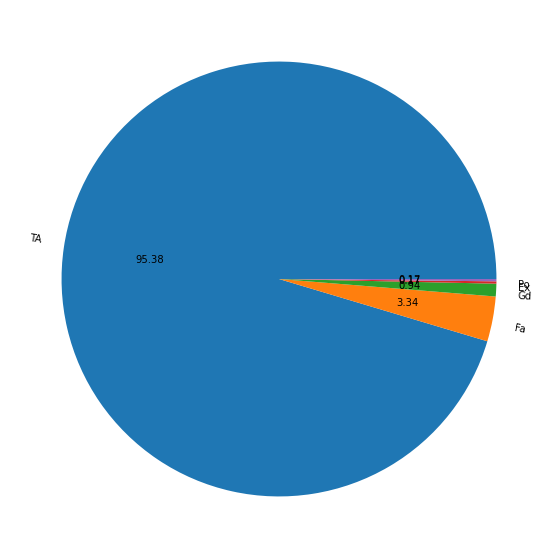

GarageCond


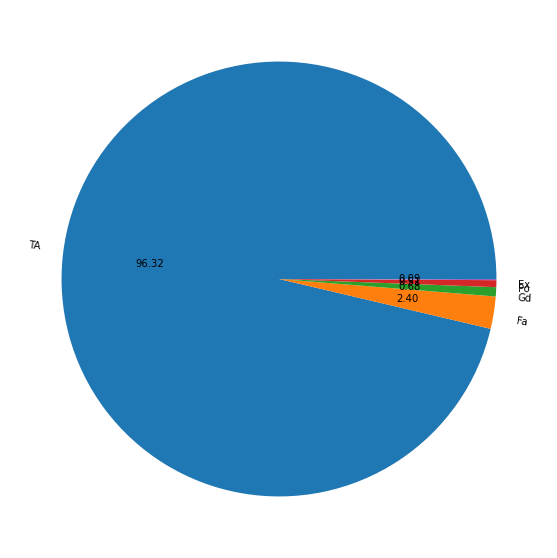

PavedDrive


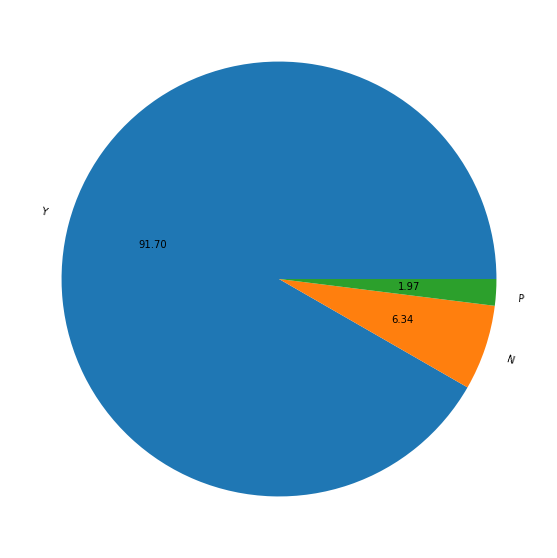

SaleType


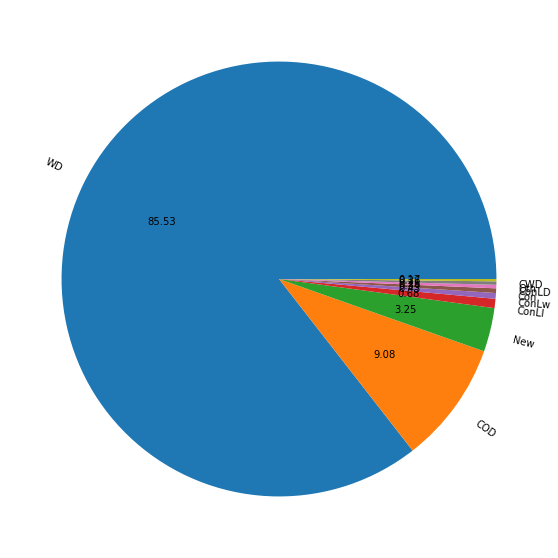

SaleCondition


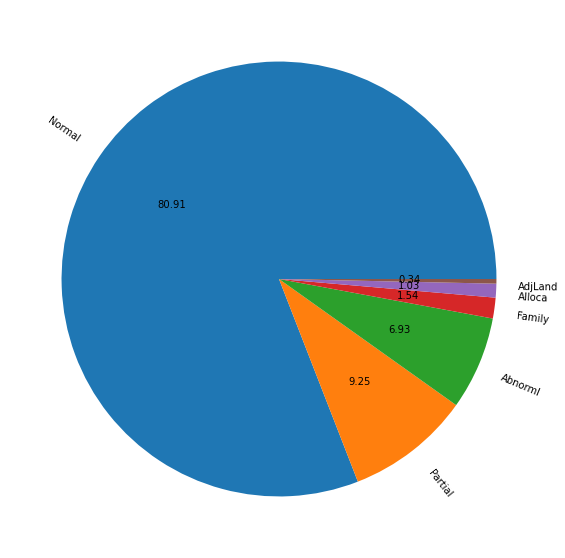

In [128]:
#plotting pie plot
for i in data:
    if data[i].dtype=='object':
        print(i)
        plt.figure(figsize=(10,10))
        labels=data[i].unique()
        plt.pie(x=data[i].value_counts(),labels=labels,autopct='%.2f',rotatelabels=True)
        plt.show()

**Above plots are the pie plots for categorical features.**

In [162]:
#checking top top 10 highest sale prices
top_10=data.sort_values(by='SalePrice',ascending =True)[:10]
top_10

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
956,30,C (all),60.0,7879,Pave,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,4,5,1920,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,495,Unf,0,225,720,GasA,TA,N,FuseA,720,0,0,720,0,0,1,0,2,1,TA,4,Typ,0,Gd,Attchd,1978.193841,Unf,0,0,TA,TA,N,0,523,115,0,0,0,0,11,2009,WD,Abnorml,34900
249,20,C (all),50.0,9000,Pave,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,2,3,1949,1950,Gable,CompShg,AsbShng,AsbShng,None,0.0,TA,TA,CBlock,TA,TA,Av,BLQ,50,Unf,0,430,480,GasA,TA,N,FuseA,480,0,0,480,1,0,0,0,1,1,TA,4,Typ,0,Gd,Detchd,1958.000000,Unf,1,308,TA,TA,Y,0,0,0,0,0,0,0,10,2006,WD,Abnorml,35311
396,50,RM,50.0,5925,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,1Fam,1.5Fin,3,6,1910,1950,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,600,600,Grav,Fa,N,SBrkr,600,368,0,968,0,0,1,0,2,1,TA,6,Typ,0,Gd,Attchd,1978.193841,Unf,0,0,TA,TA,Y,0,0,0,0,0,0,0,5,2009,WD,Abnorml,37900
48,20,RL,50.0,5000,Pave,Reg,Low,AllPub,Inside,Mod,BrkSide,Norm,Norm,1Fam,1Story,1,3,1946,1950,Gable,CompShg,VinylSd,VinylSd,None,0.0,Fa,Fa,Slab,TA,TA,No,Unf,0,Unf,0,0,0,GasA,Fa,N,FuseF,334,0,0,334,0,0,1,0,1,1,Fa,2,Typ,0,Gd,Attchd,1978.193841,Unf,0,0,TA,TA,N,0,0,0,0,0,0,0,1,2007,WD,Normal,39300
1166,70,C (all),50.0,8500,Pave,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Feedr,Norm,1Fam,2Story,4,4,1920,1950,Gambrel,CompShg,BrkFace,BrkFace,None,0.0,TA,Fa,BrkTil,TA,TA,No,Unf,0,Unf,0,649,649,GasA,TA,N,SBrkr,649,668,0,1317,0,0,1,0,3,1,TA,6,Typ,0,Gd,Detchd,1920.000000,Unf,1,250,TA,Fa,N,0,54,172,0,0,0,0,7,2008,WD,Normal,40000
726,30,RL,56.0,4130,Pave,IR1,Lvl,AllPub,Inside,Gtl,BrkSide,Norm,Norm,1Fam,1Story,3,6,1935,2003,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,CBlock,TA,TA,No,Unf,0,Unf,0,270,270,GasA,Gd,Y,SBrkr,729,0,0,729,0,0,1,0,2,1,TA,5,Maj2,0,Gd,Attchd,1978.193841,Unf,0,0,TA,TA,N,0,0,0,0,0,0,0,7,2008,WD,Normal,52000
1046,30,RM,153.0,4118,Pave,IR1,Bnk,AllPub,Corner,Mod,OldTown,Feedr,Norm,1Fam,1Story,4,4,1941,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,CBlock,TA,TA,No,Unf,0,Unf,0,693,693,Grav,Fa,N,FuseA,693,0,0,693,0,0,1,0,2,1,Fa,4,Typ,0,Gd,Attchd,1978.193841,Unf,0,0,TA,TA,N,0,20,0,0,0,0,0,3,2006,WD,Normal,52500
180,30,RM,40.0,3636,Pave,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,4,4,1922,1950,Gable,CompShg,AsbShng,AsbShng,None,0.0,TA,TA,BrkTil,TA,Fa,No,Unf,0,Unf,0,796,796,GasA,Fa,N,SBrkr,796,0,0,796,0,0,1,0,2,1,TA,5,Typ,0,Gd,Attchd,1978.193841,Unf,0,0,TA,TA,N,0,0,100,0,0,0,0,1,2008,WD,Normal,55000
759,20,C (all),66.0,8712,Grvl,Reg,Bnk,AllPub,Inside,Mod,IDOTRR,Norm,Norm,1Fam,1Story,5,5,1952,1952,Hip,CompShg,Wd Sdng,Wd Sdng,None,0.0,Fa,TA,CBlock,TA,TA,Av,Unf,0,Unf,0,540,540,GasA,TA,N,FuseA,1044,0,0,1044,0,0,1,0,2,1,Fa,4,Typ,0,Gd,Basment,1952.000000,Unf,2,504,TA,TA,N,0,0,0,0,0,0,54,6,2010,WD,Alloca,55993
1162,30,RL,45.0,8212,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,3,3,1914,1950,Gable,CompShg,Stucco,Stucco,None,0.0,TA,Fa,BrkTil,TA,Fa,No,Rec,203,Unf,0,661,864,GasA,TA,N,FuseF,864,0,0,864,1,0,1,0,2,1,TA,5,Typ,0,Gd,Detchd,1938.000000,Unf,1,200,TA,Fa,Y,0,0,96,0,0,0,0,6,2010,WD,Normal,58500


In [166]:
#splitting categorical features
top_10_categorical=[]
for i in top_10:
    if data[i].dtype=='object':
        top_10_categorical.append(i)
print(top_10_categorical)

['MSZoning', 'Street', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition']


In [165]:
#splitting continuous features
top_10_continuous=[]
for i in top_10:
    if data[i].dtype!='object':
        top_10_continuous.append(i)
print(top_10_continuous)

['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold', 'SalePrice']


RL         928
RM         163
FV          52
RH          16
C (all)      9
Name: MSZoning, dtype: int64


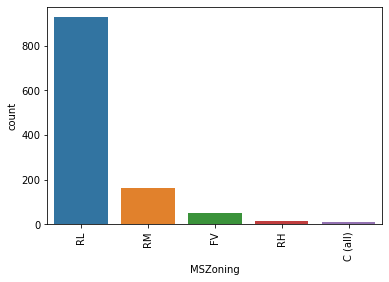

Pave    1164
Grvl       4
Name: Street, dtype: int64


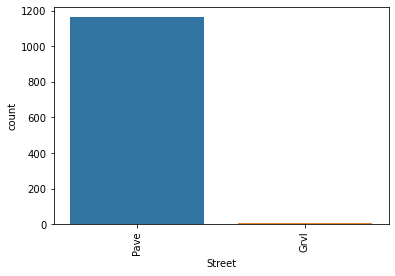

Reg    740
IR1    390
IR2     32
IR3      6
Name: LotShape, dtype: int64


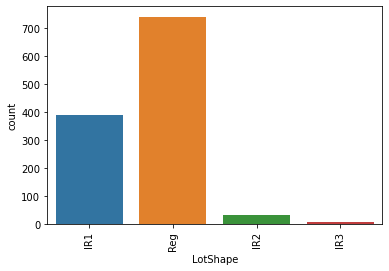

Lvl    1046
Bnk      50
HLS      42
Low      30
Name: LandContour, dtype: int64


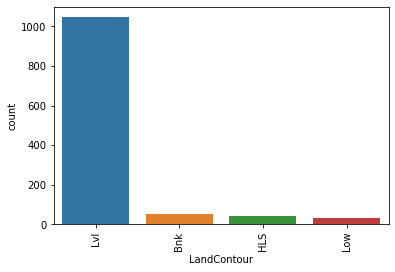

AllPub    1168
Name: Utilities, dtype: int64


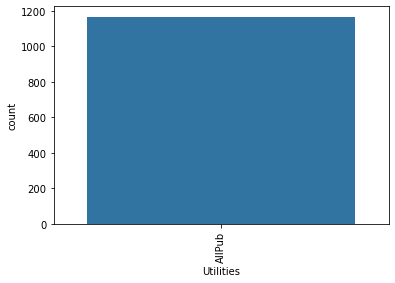

Inside     842
Corner     222
CulDSac     69
FR2         33
FR3          2
Name: LotConfig, dtype: int64


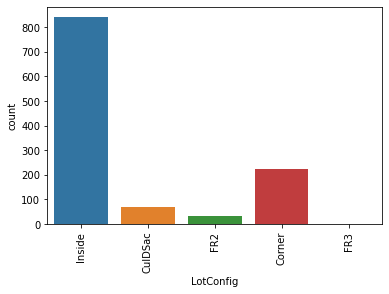

Gtl    1105
Mod      51
Sev      12
Name: LandSlope, dtype: int64


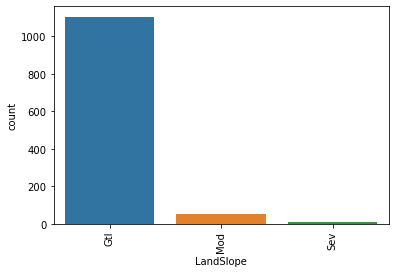

NAmes      182
CollgCr    118
OldTown     86
Edwards     83
Somerst     68
Gilbert     64
NridgHt     61
Sawyer      60
NWAmes      59
SawyerW     51
BrkSide     50
Crawfor     45
NoRidge     35
Mitchel     34
IDOTRR      30
Timber      24
ClearCr     24
SWISU       21
StoneBr     19
Blmngtn     15
BrDale      11
MeadowV      9
Veenker      9
NPkVill      8
Blueste      2
Name: Neighborhood, dtype: int64


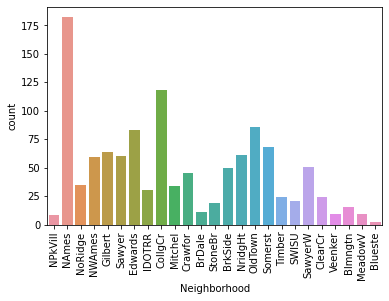

Norm      1005
Feedr       67
Artery      38
RRAn        20
PosN        17
RRAe         9
PosA         6
RRNn         4
RRNe         2
Name: Condition1, dtype: int64


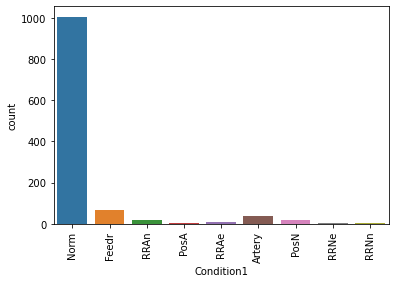

Norm      1154
Feedr        6
PosN         2
Artery       2
RRAe         1
RRNn         1
PosA         1
RRAn         1
Name: Condition2, dtype: int64


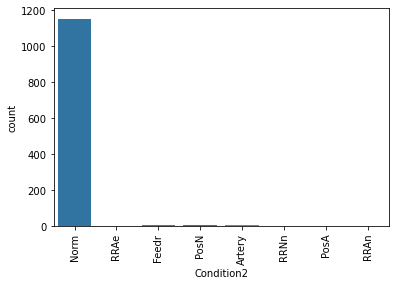

1Fam      981
TwnhsE     90
Duplex     41
Twnhs      29
2fmCon     27
Name: BldgType, dtype: int64


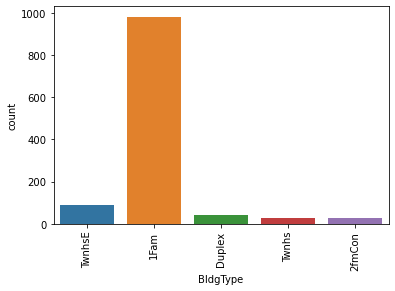

1Story    578
2Story    361
1.5Fin    121
SLvl       47
SFoyer     32
1.5Unf     12
2.5Unf     10
2.5Fin      7
Name: HouseStyle, dtype: int64


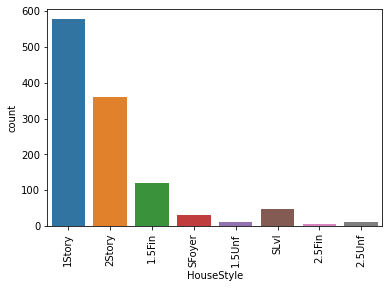

Gable      915
Hip        225
Flat        12
Gambrel      9
Mansard      5
Shed         2
Name: RoofStyle, dtype: int64


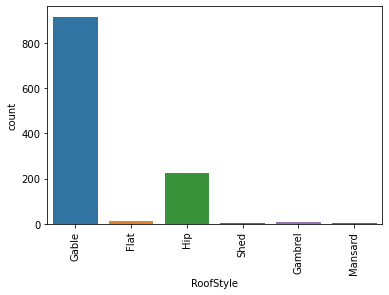

CompShg    1144
Tar&Grv      10
WdShngl       6
WdShake       4
Roll          1
ClyTile       1
Metal         1
Membran       1
Name: RoofMatl, dtype: int64


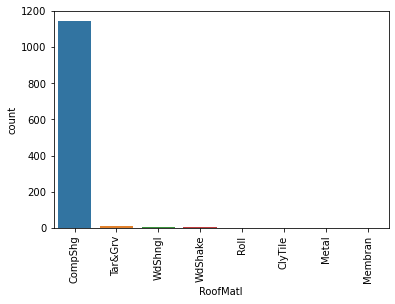

VinylSd    396
HdBoard    179
MetalSd    178
Wd Sdng    174
Plywood     93
CemntBd     42
BrkFace     41
Stucco      22
WdShing     19
AsbShng     19
Stone        2
AsphShn      1
ImStucc      1
BrkComm      1
Name: Exterior1st, dtype: int64


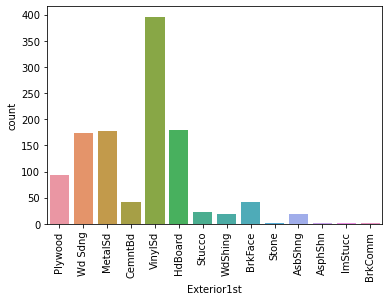

VinylSd    387
MetalSd    173
HdBoard    170
Wd Sdng    165
Plywood    118
CmentBd     42
Wd Shng     31
Stucco      23
BrkFace     20
AsbShng     18
ImStucc      8
Brk Cmn      5
Stone        4
AsphShn      3
Other        1
Name: Exterior2nd, dtype: int64


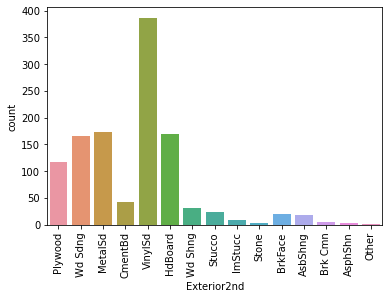

None       703
BrkFace    354
Stone       98
BrkCmn      13
Name: MasVnrType, dtype: int64


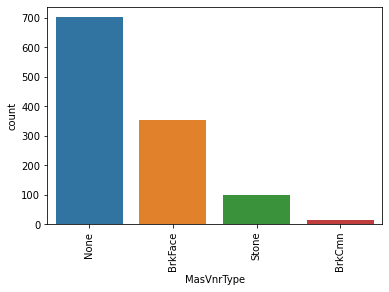

TA    717
Gd    397
Ex     43
Fa     11
Name: ExterQual, dtype: int64


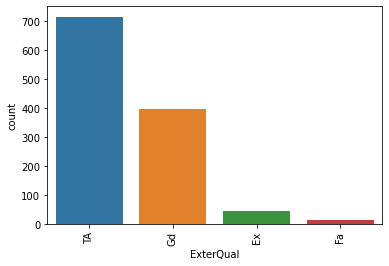

TA    1022
Gd     117
Fa      26
Ex       2
Po       1
Name: ExterCond, dtype: int64


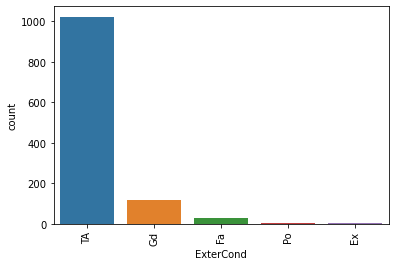

CBlock    516
PConc     513
BrkTil    112
Slab       21
Stone       5
Wood        1
Name: Foundation, dtype: int64


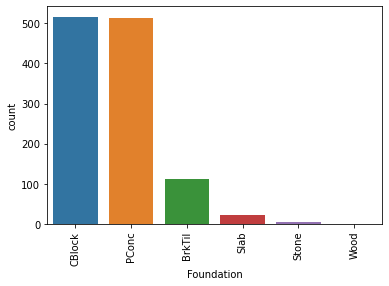

TA    547
Gd    498
Ex     94
Fa     29
Name: BsmtQual, dtype: int64


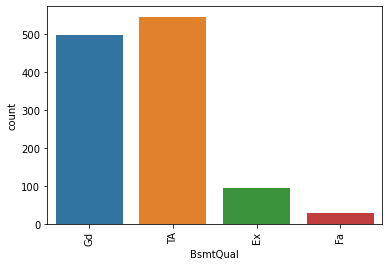

TA    1071
Gd      56
Fa      39
Po       2
Name: BsmtCond, dtype: int64


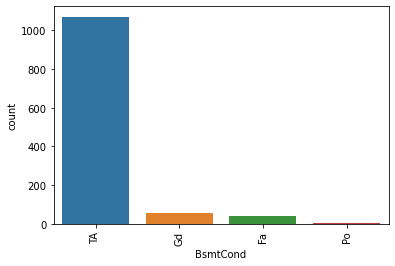

No    787
Av    180
Gd    108
Mn     93
Name: BsmtExposure, dtype: int64


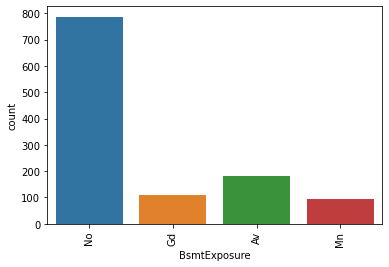

Unf    375
GLQ    330
ALQ    174
BLQ    121
Rec    109
LwQ     59
Name: BsmtFinType1, dtype: int64


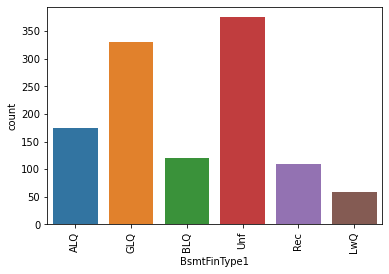

Unf    1033
Rec      43
LwQ      40
BLQ      24
ALQ      16
GLQ      12
Name: BsmtFinType2, dtype: int64


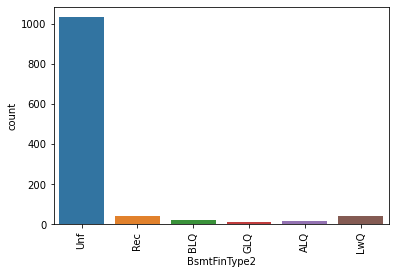

GasA     1143
GasW       14
Grav        5
Wall        4
Floor       1
OthW        1
Name: Heating, dtype: int64


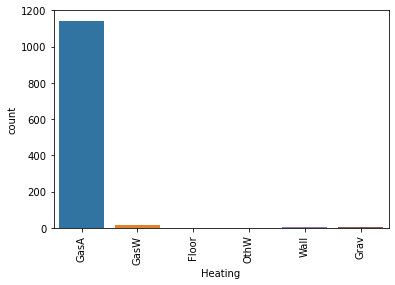

Ex    585
TA    352
Gd    192
Fa     38
Po      1
Name: HeatingQC, dtype: int64


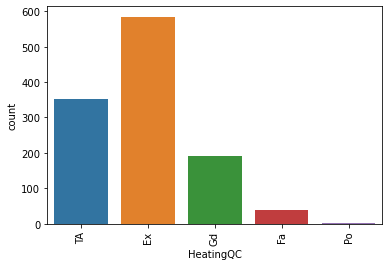

Y    1090
N      78
Name: CentralAir, dtype: int64


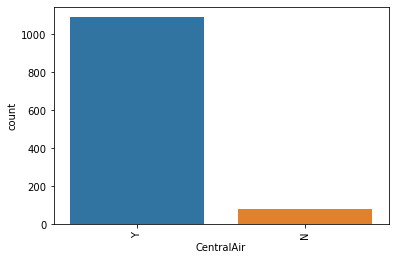

SBrkr    1070
FuseA      74
FuseF      21
FuseP       2
Mix         1
Name: Electrical, dtype: int64


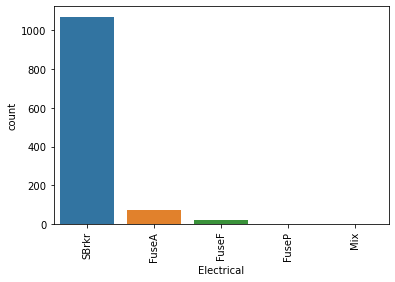

TA    578
Gd    478
Ex     82
Fa     30
Name: KitchenQual, dtype: int64


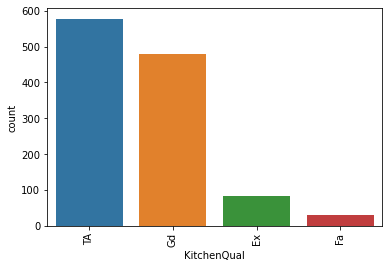

Typ     1085
Min2      30
Min1      25
Mod       12
Maj1      11
Maj2       4
Sev        1
Name: Functional, dtype: int64


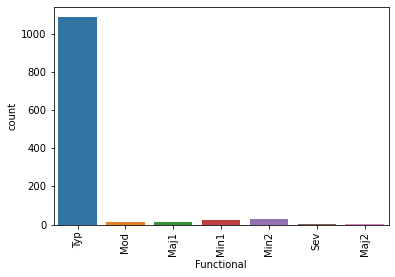

Gd    852
TA    252
Fa     25
Ex     21
Po     18
Name: FireplaceQu, dtype: int64


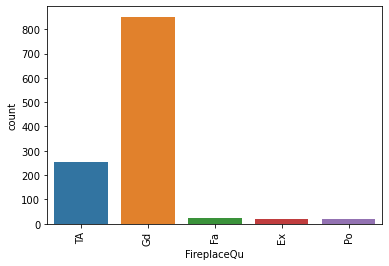

Attchd     755
Detchd     314
BuiltIn     70
Basment     16
CarPort      8
2Types       5
Name: GarageType, dtype: int64


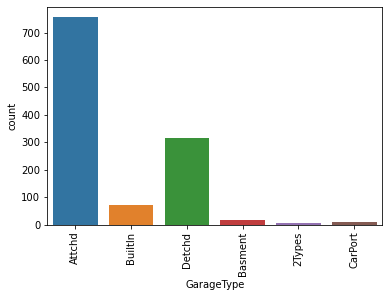

Unf    551
RFn    339
Fin    278
Name: GarageFinish, dtype: int64


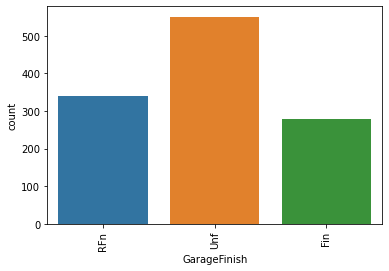

TA    1114
Fa      39
Gd      11
Ex       2
Po       2
Name: GarageQual, dtype: int64


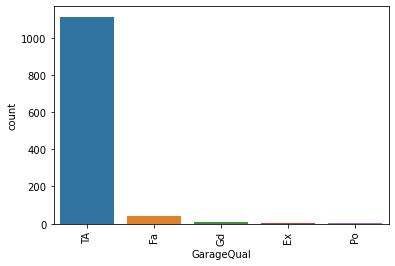

TA    1125
Fa      28
Gd       8
Po       6
Ex       1
Name: GarageCond, dtype: int64


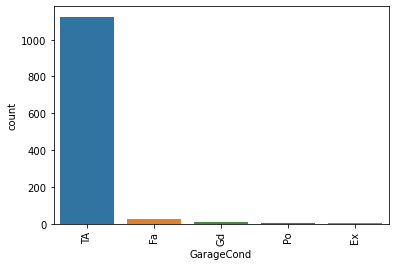

Y    1071
N      74
P      23
Name: PavedDrive, dtype: int64


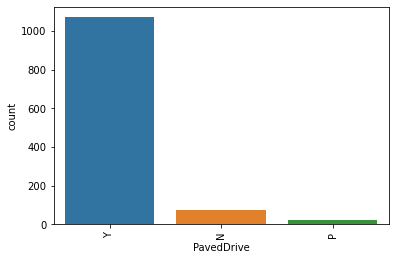

WD       999
New      106
COD       38
ConLD      8
ConLI      5
ConLw      4
Oth        3
CWD        3
Con        2
Name: SaleType, dtype: int64


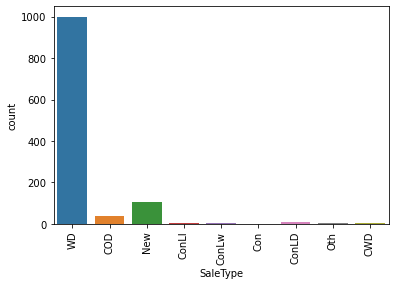

Normal     945
Partial    108
Abnorml     81
Family      18
Alloca      12
AdjLand      4
Name: SaleCondition, dtype: int64


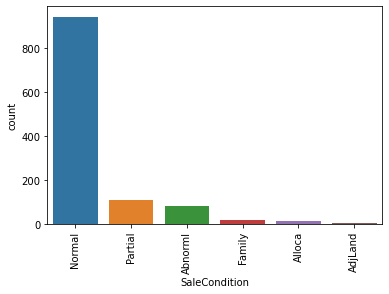

In [170]:
#plotting countplots for top 10 highest sale prices
for i in top_10_categorical:
    print(data[i].value_counts())
    sns.countplot(x=data[i])
    plt.xticks(rotation='vertical')
    plt.show()

**In this above plots we can see the count plots for categorical features for the Top 10 highest sale prices.**

MSZoning


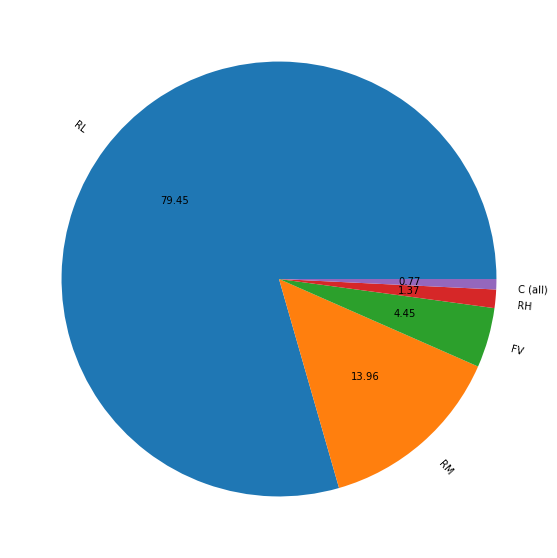

Street


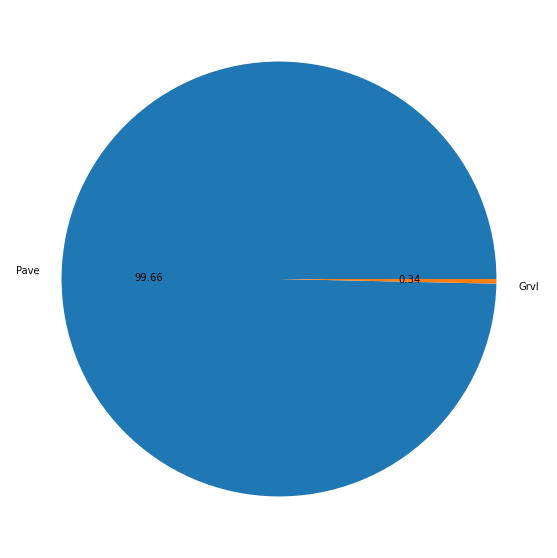

LotShape


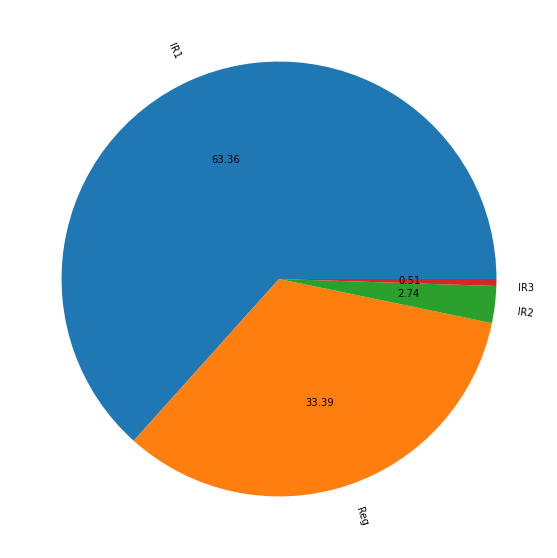

LandContour


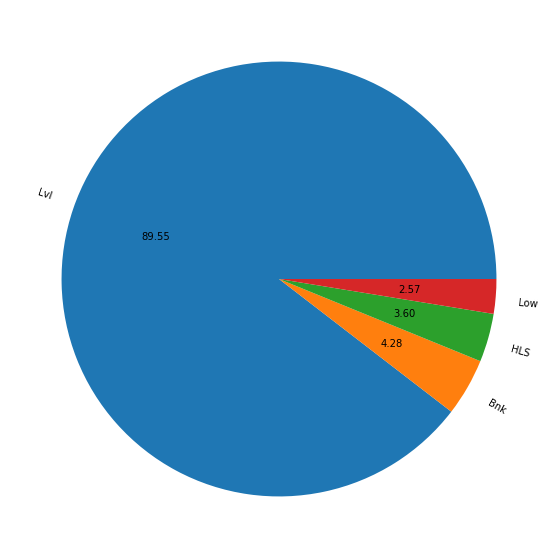

Utilities


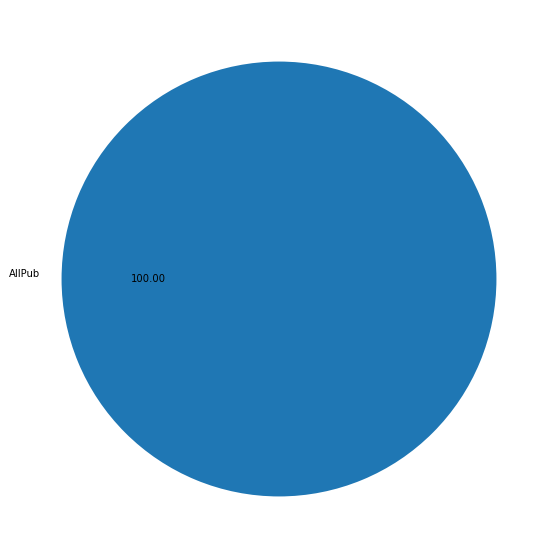

LotConfig


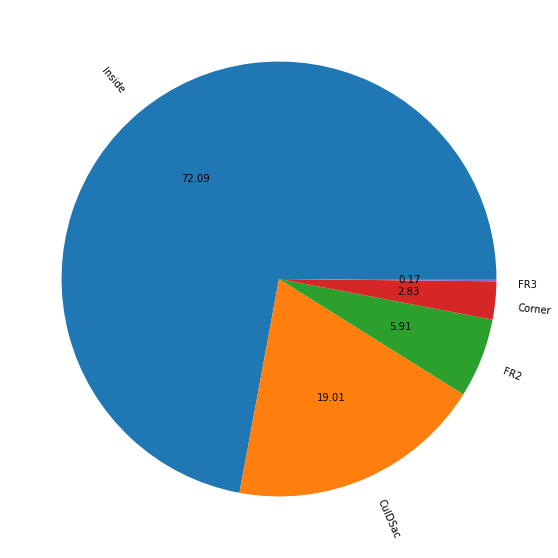

LandSlope


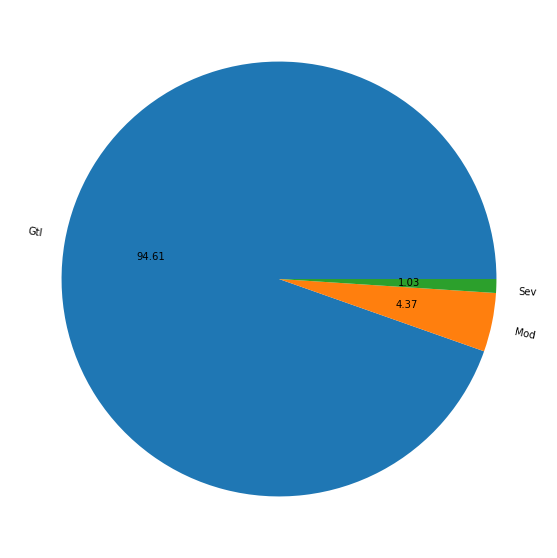

Neighborhood


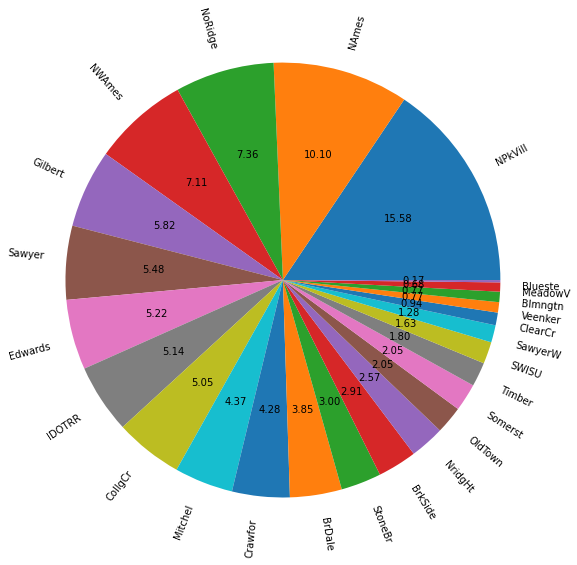

Condition1


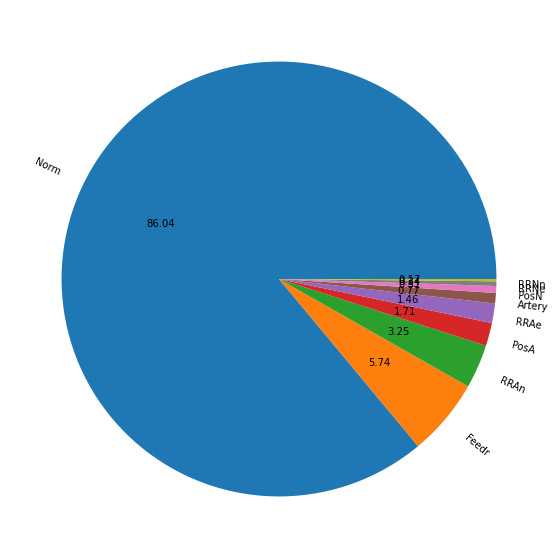

Condition2


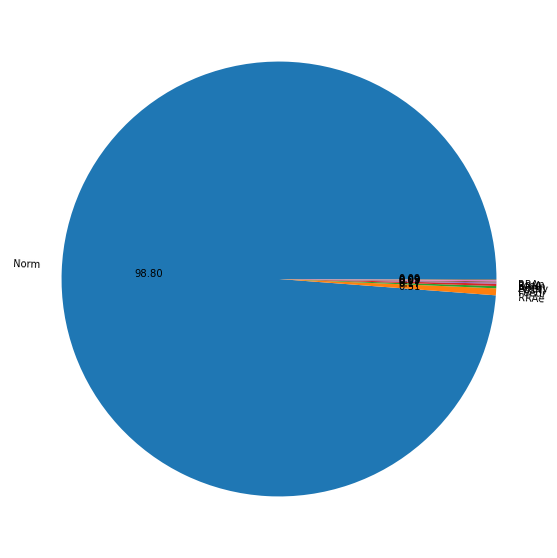

BldgType


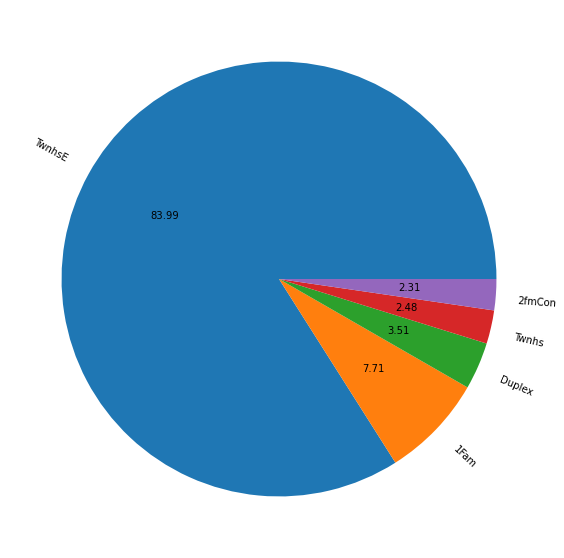

HouseStyle


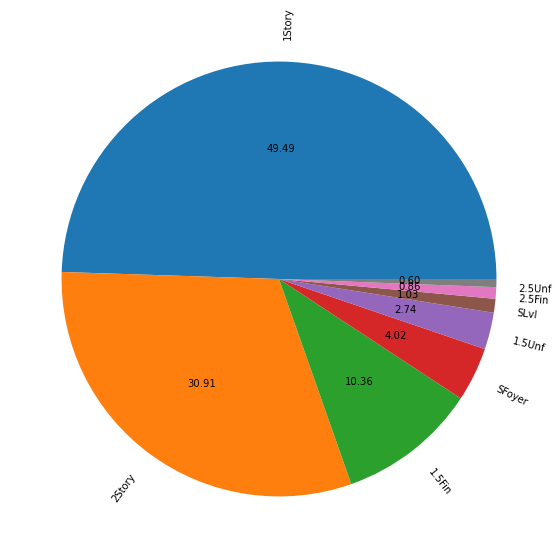

RoofStyle


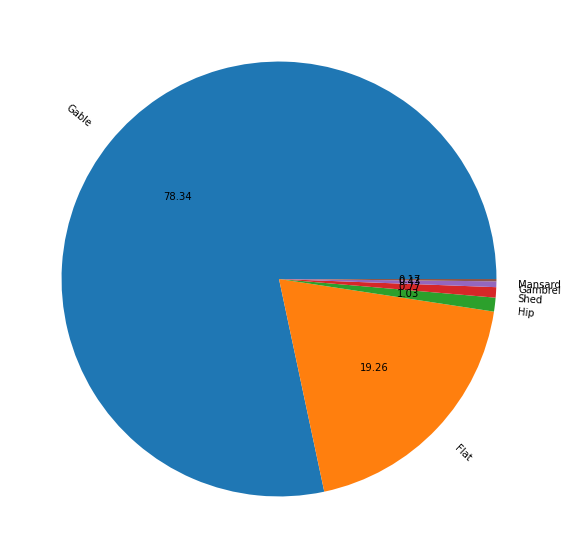

RoofMatl


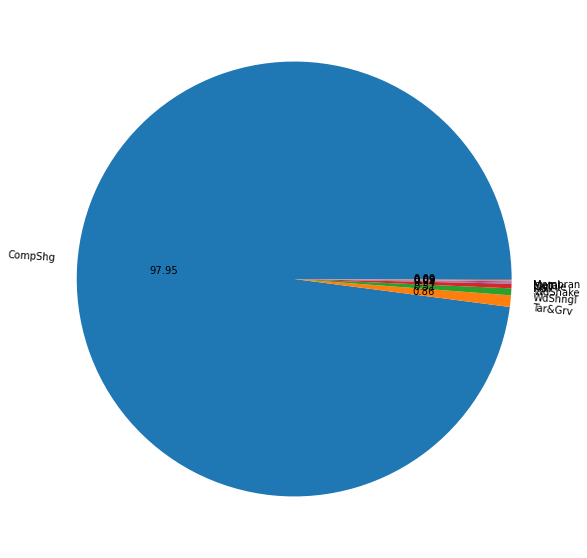

Exterior1st


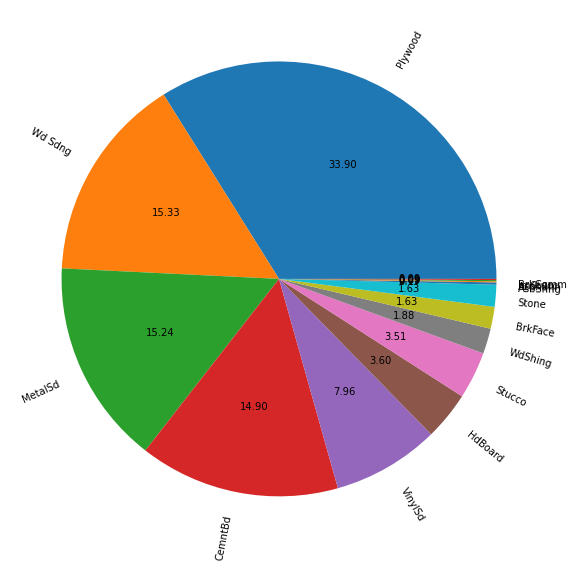

Exterior2nd


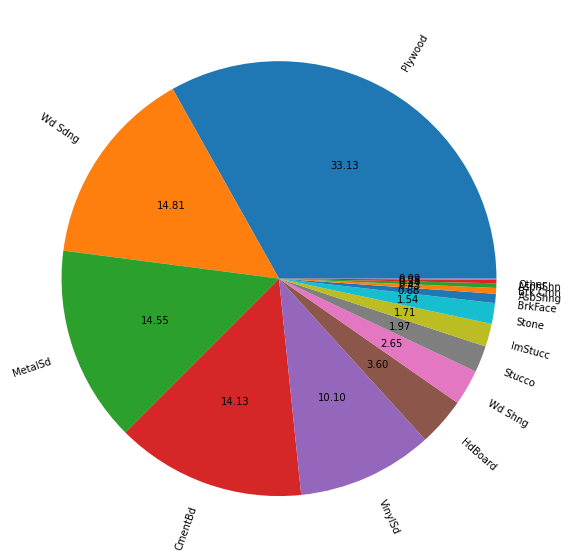

MasVnrType


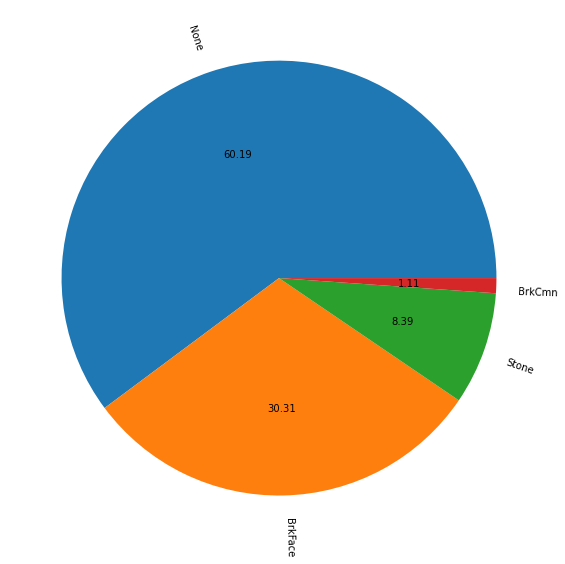

ExterQual


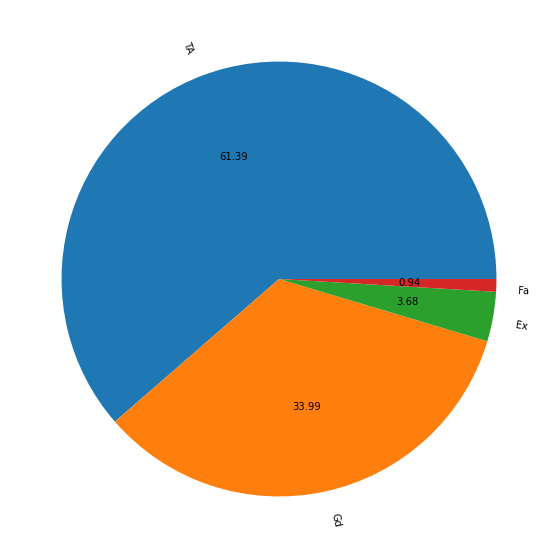

ExterCond


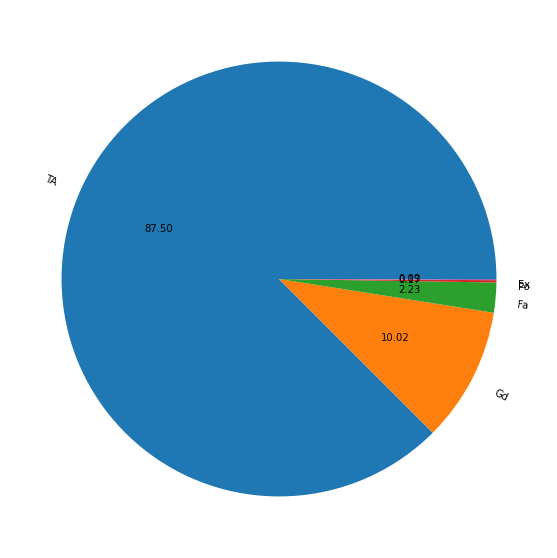

Foundation


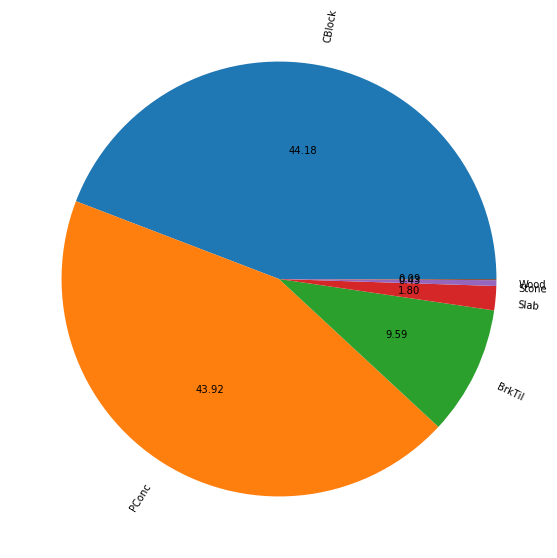

BsmtQual


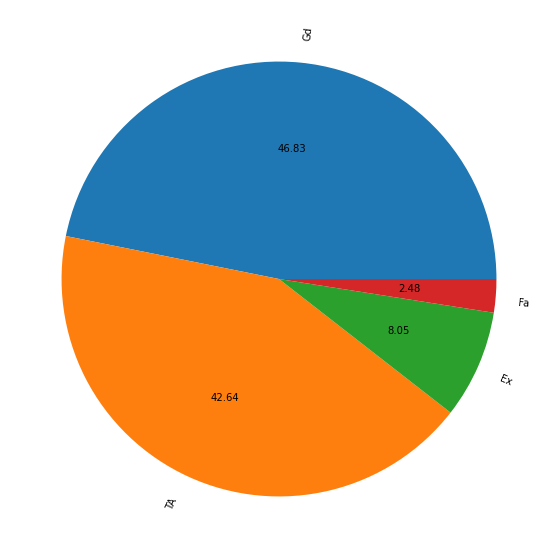

BsmtCond


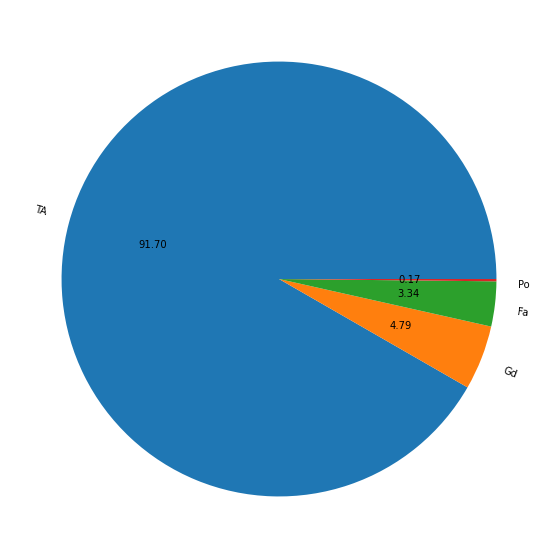

BsmtExposure


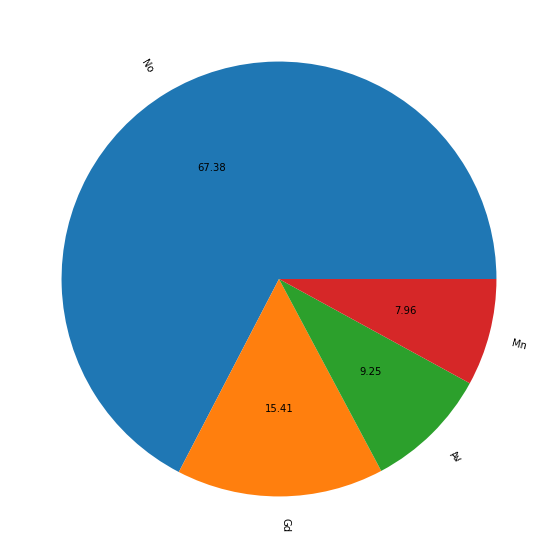

BsmtFinType1


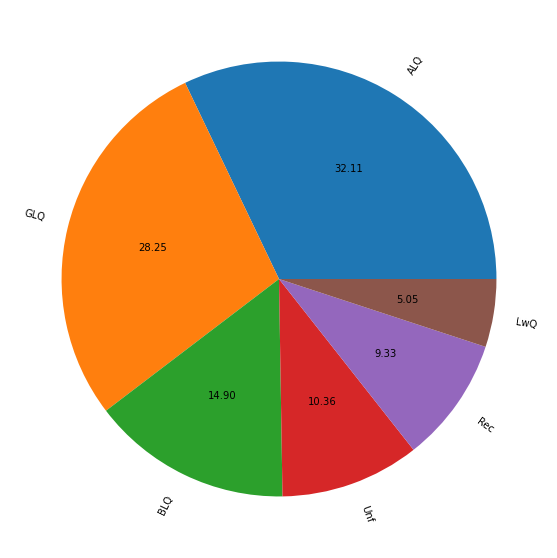

BsmtFinType2


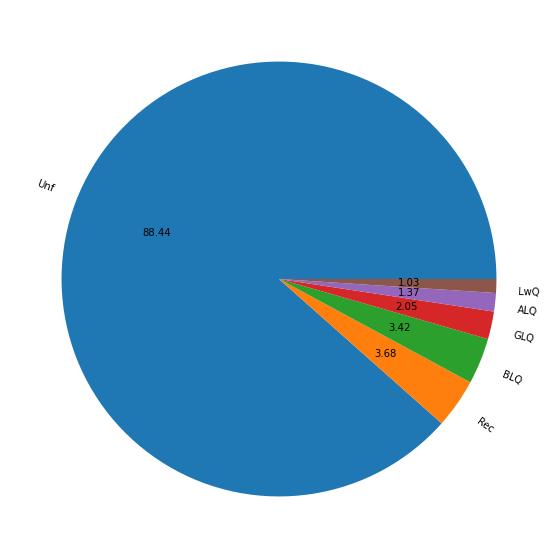

Heating


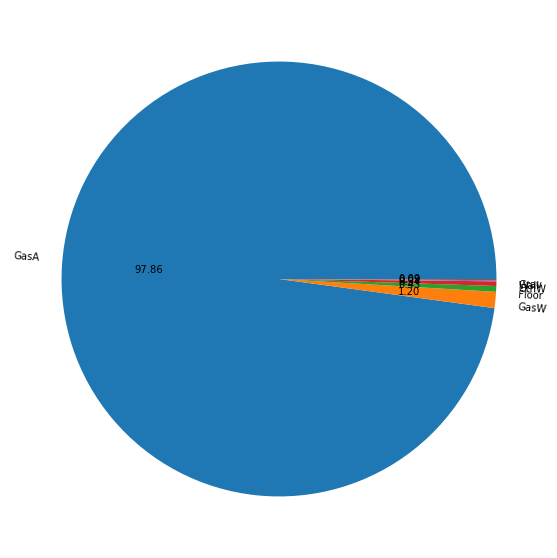

HeatingQC


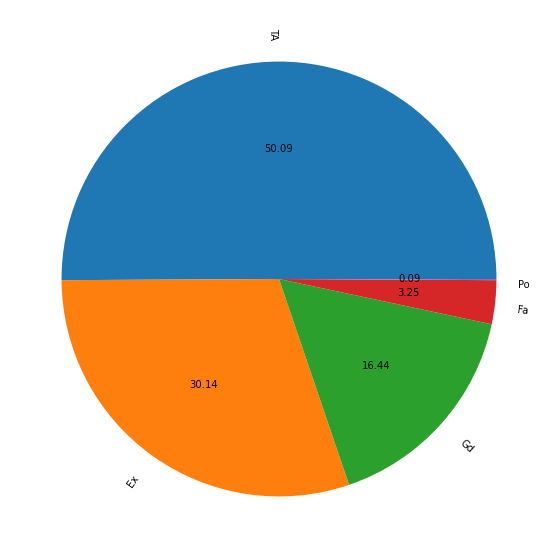

CentralAir


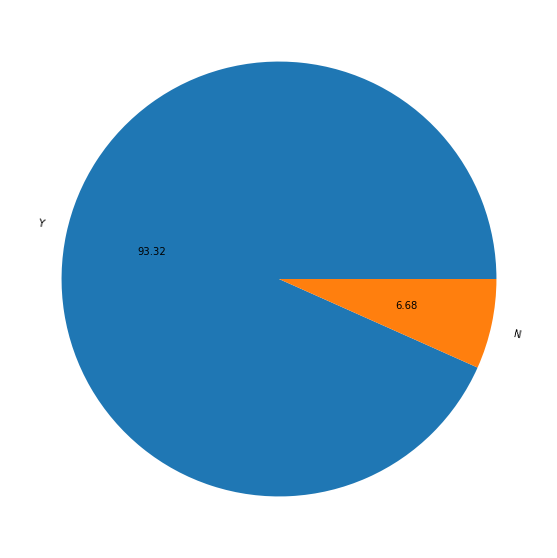

Electrical


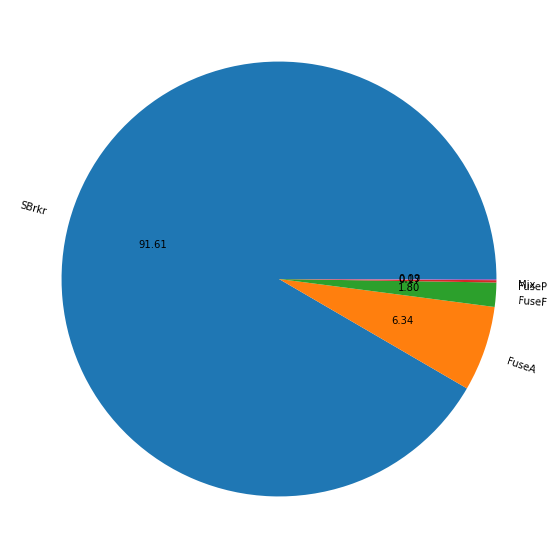

KitchenQual


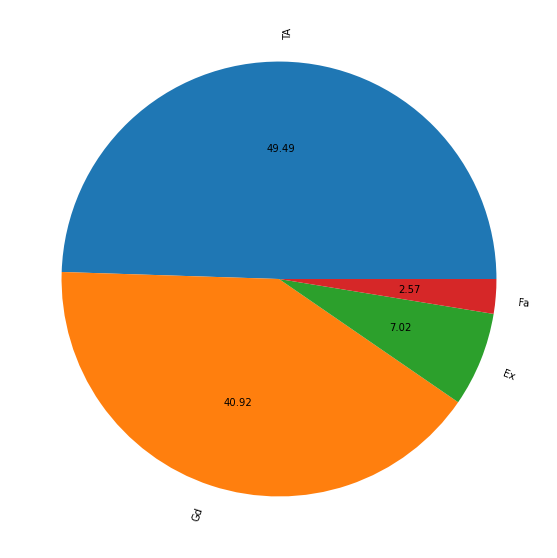

Functional


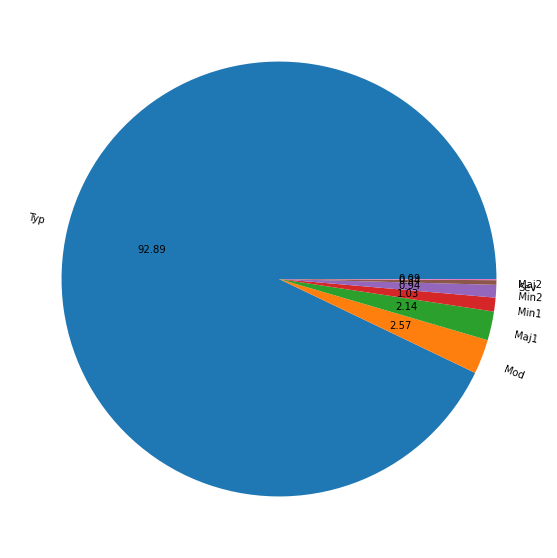

FireplaceQu


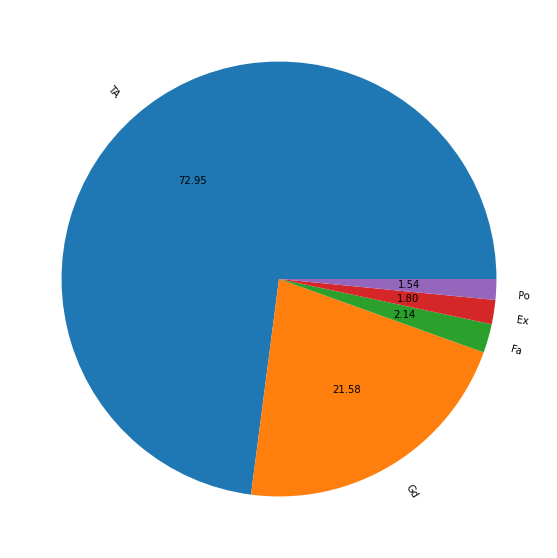

GarageType


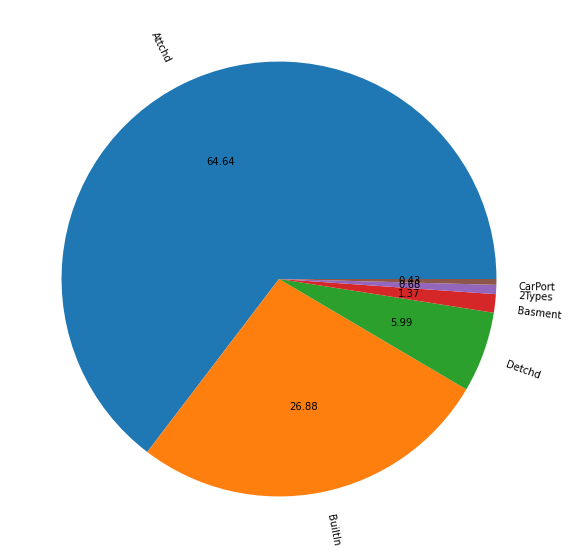

GarageFinish


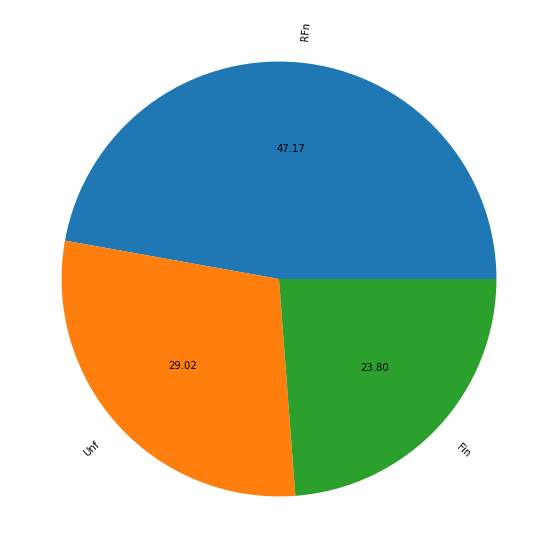

GarageQual


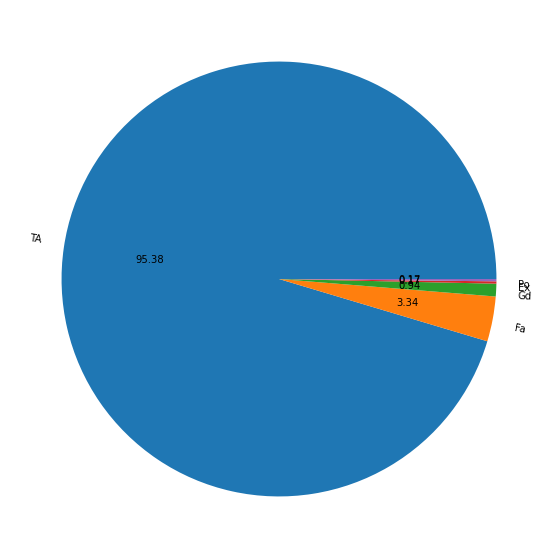

GarageCond


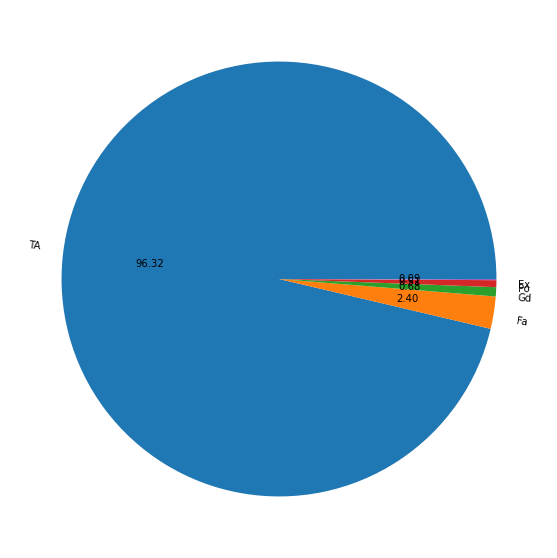

PavedDrive


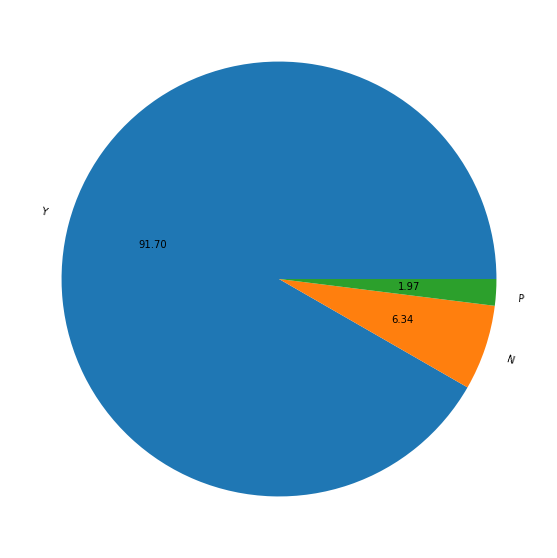

SaleType


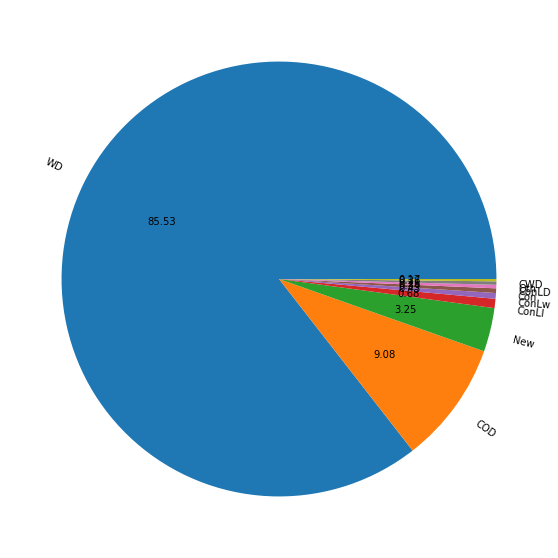

SaleCondition


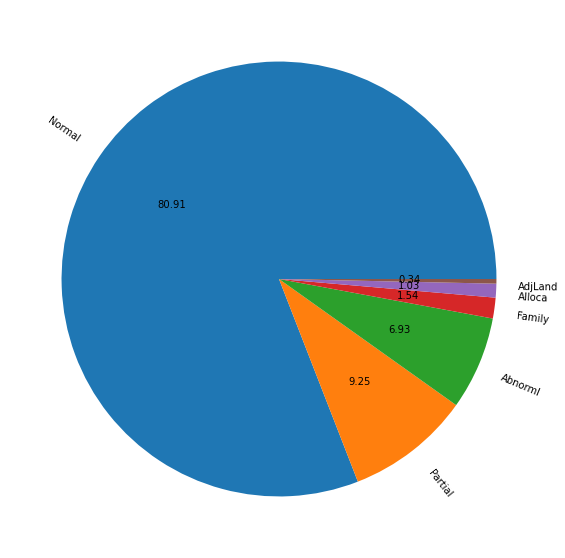

In [173]:
#plotting pie plot for top 10 highest sale prices
for i in top_10:
    if data[i].dtype=='object':
        print(i)
        plt.figure(figsize=(10,10))
        labels=data[i].unique()
        plt.pie(x=data[i].value_counts(),labels=labels,autopct='%.2f',rotatelabels=True)
        plt.show()

**In this above plots we can see the pie plots for categorical features for the Top 10 highest sale prices.**

In [174]:
#Importing required libraries
from sklearn.preprocessing import LabelEncoder

In [175]:
#Encoding column
lab_enc=LabelEncoder()

In [176]:
# Let's convert the categorical data to numerical data for test data
for i in cat_features:
    data[i]=lab_enc.fit_transform(data[i])

In [177]:
data.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,3,70.98847,4928,1,0,3,0,4,0,13,2,2,4,2,6,5,1976,1976,1,1,8,9,2,0.0,3,4,1,2,3,3,0,120,5,0,958,1078,1,4,1,4,958,0,0,958,0,0,2,0,2,1,3,5,6,1,4,1,1977.0,1,2,440,4,4,2,0,205,0,0,0,0,0,2,2007,8,4,128000
1,20,3,95.00000,15865,1,0,3,0,4,1,12,2,2,0,2,8,6,1970,1970,0,5,12,13,2,0.0,2,2,2,3,1,1,0,351,4,823,1043,2217,1,0,1,4,2217,0,0,2217,1,0,2,0,4,1,2,8,6,1,4,1,1970.0,2,2,621,4,4,2,81,207,0,0,224,0,0,10,2007,8,4,268000
2,60,3,92.00000,9920,1,0,3,0,1,0,15,2,2,0,5,7,5,1996,1997,1,1,7,7,2,0.0,2,4,2,2,3,0,2,862,5,0,255,1117,1,0,1,4,1127,886,0,2013,1,0,2,1,3,1,3,8,6,1,4,1,1997.0,2,2,455,4,4,2,180,130,0,0,0,0,0,6,2007,8,4,269790
3,20,3,105.00000,11751,1,0,3,0,4,0,14,2,2,0,2,6,6,1977,1977,3,1,8,9,1,480.0,3,4,1,2,3,3,1,705,5,0,1139,1844,1,0,1,4,1844,0,0,1844,0,0,2,0,3,1,3,7,6,1,4,1,1977.0,1,2,546,4,4,2,0,122,0,0,0,0,0,1,2010,0,4,190000
4,20,3,70.98847,16635,1,0,3,0,2,0,14,2,2,0,2,6,7,1977,2000,1,1,4,4,3,126.0,2,4,1,2,3,3,0,1246,5,0,356,1602,1,2,1,4,1602,0,0,1602,0,1,2,0,3,1,2,8,6,1,4,1,1977.0,0,2,529,4,4,2,240,0,0,0,0,0,0,6,2009,8,4,215000


**So we can see that categorical columns have been encoded.**

In [178]:
#dropping column utility
data=data.drop(['Utilities'],axis=1)
data.shape

(1168, 75)

**Dropping column utility has it has a single value through out the datatset.so i find it irrelevant for prediction.So i have dropped that column.**

**Correlation Matrix**

In [182]:
data_corr=data.corr().abs()
data_corr

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
MSSubClass,1.000000,0.007478,0.336681,0.124151,0.035981,0.104485,0.021387,0.076880,0.014930,0.013918,0.042474,0.044319,0.731815,0.381585,0.070462,0.056978,0.023988,0.056618,0.100641,0.032214,0.090178,0.120022,0.013252,0.027813,0.024133,0.004186,0.053951,0.052242,0.013220,0.068192,0.017515,0.052236,0.040573,0.062403,0.134170,0.214042,0.047734,0.001994,0.113883,0.045533,0.227927,0.300366,0.053737,0.086448,0.004556,0.008207,0.140807,0.168423,0.013283,0.283506,0.011378,0.051179,0.022913,0.035792,0.024708,0.077469,0.073130,0.000067,0.027639,0.092408,0.010568,0.025595,0.068702,0.022609,0.017468,0.004252,0.043210,0.013291,0.009583,0.023503,0.016015,0.038595,0.035050,0.028981,0.060775
MSZoning,0.007478,1.000000,0.069661,0.023328,0.140215,0.053655,0.001175,0.027246,0.023952,0.251833,0.025651,0.031959,0.024776,0.110991,0.134037,0.189553,0.299732,0.174586,0.000913,0.009719,0.012037,0.005548,0.033521,0.063862,0.184815,0.099269,0.244844,0.123822,0.002336,0.037414,0.021518,0.034161,0.031322,0.027055,0.032638,0.058896,0.051188,0.119852,0.015887,0.079205,0.033095,0.048968,0.012098,0.064125,0.007287,0.006345,0.188837,0.121209,0.001906,0.026744,0.111689,0.031062,0.091684,0.010658,0.005628,0.125155,0.261072,0.162566,0.126031,0.168364,0.168881,0.087375,0.077280,0.004509,0.152694,0.111221,0.004409,0.030793,0.001663,0.003416,0.051646,0.004964,0.079854,0.004501,0.133221
LotFrontage,0.336681,0.069661,1.000000,0.299452,0.035309,0.144523,0.073451,0.192468,0.046051,0.065824,0.025581,0.011761,0.403220,0.056321,0.229218,0.047573,0.112655,0.088799,0.146222,0.082566,0.087727,0.110762,0.034388,0.188758,0.169835,0.044582,0.090734,0.176402,0.043165,0.123896,0.031507,0.228996,0.007509,0.002159,0.113924,0.356107,0.026622,0.078262,0.077404,0.066868,0.403436,0.089675,0.007506,0.374251,0.094046,0.001389,0.171773,0.047816,0.237199,0.002729,0.174713,0.318771,0.039272,0.230610,0.073251,0.216237,0.055992,0.192961,0.260252,0.322644,0.041522,0.043699,0.092551,0.088334,0.151328,0.020902,0.051084,0.030405,0.196001,0.001329,0.022517,0.003885,0.035356,0.065091,0.323779
LotArea,0.124151,0.023328,0.299452,1.000000,0.263973,0.189201,0.159038,0.152063,0.395410,0.010707,0.029520,0.040096,0.215345,0.040637,0.107188,0.017513,0.005506,0.027228,0.038615,0.194142,0.048265,0.027328,0.005204,0.121086,0.057865,0.011438,0.021195,0.075262,0.010165,0.136900,0.053584,0.221851,0.084713,0.056656,0.006600,0.259733,0.020394,0.003337,0.051182,0.050388,0.312843,0.059803,0.001915,0.281360,0.142387,0.059282,0.123197,0.007271,0.117351,0.013075,0.064278,0.184546,0.033165,0.285983,0.112306,0.123746,0.034765,0.117373,0.158313,0.195162,0.005999,0.035657,0.021907,0.216720,0.093080,0.007446,0.025794,0.025256,0.097107,0.051679,0.015141,0.035399,0.005421,0.034236,0.249499
Street,0.035981,0.140215,0.035309,0.263973,1.000000,0.012941,0.105226,0.000153,0.141572,0.001420,0.002189,0.001406,0.013606,0.016793,0.057140,0.031082,0.020292,0.057866,0.006875,0.007889,0.012482,0.014618,0.000822,0.024583,0.044509,0.017738,0.032701,0.031959,0.017190,0.065253,0.006420,0.009066,0.045208,0.003550,0.024205,0.016422,0.006981,0.047968,0.043024,0.038720,0.011486,0.040957,0.007352,0.043322,0.036483,0.013788,0.033208,0.045146,0.027587,

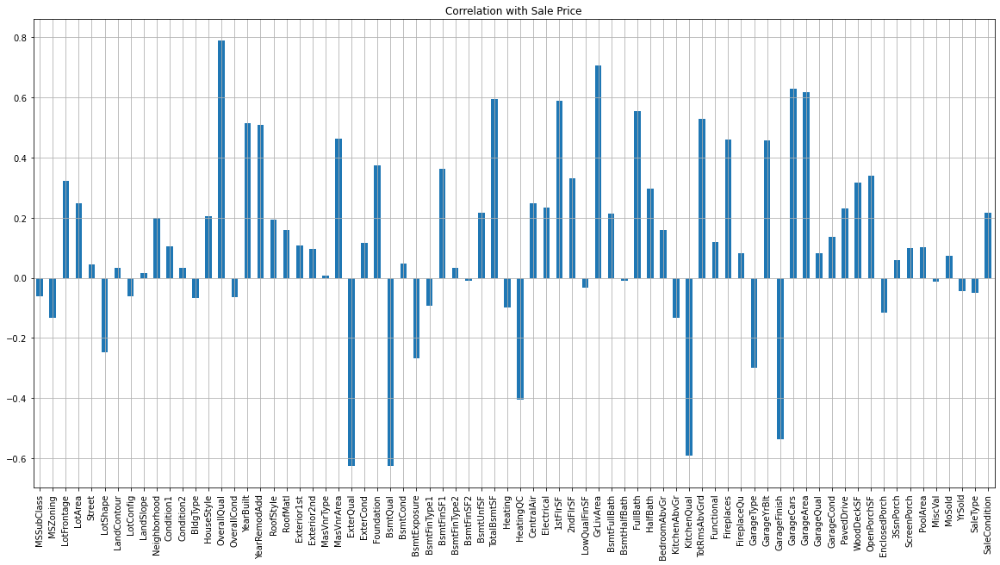

In [180]:
#Checking for correlation
data.drop(['SalePrice'],axis=1).corrwith(data['SalePrice']).plot(kind='bar',grid=True,figsize=(20,10),title='Correlation with Sale Price')
plt.show()

**In this plot we can see that Housestyle,GriLiveArea,Garagecars and Garage area are highly positively correlated to the label and Exterqual,bsmtqual are highly negatively correlated to the label.And Masvnrarea,bsmtfinsf2,bsmthalfbath and miscval are least correlated to the label.**

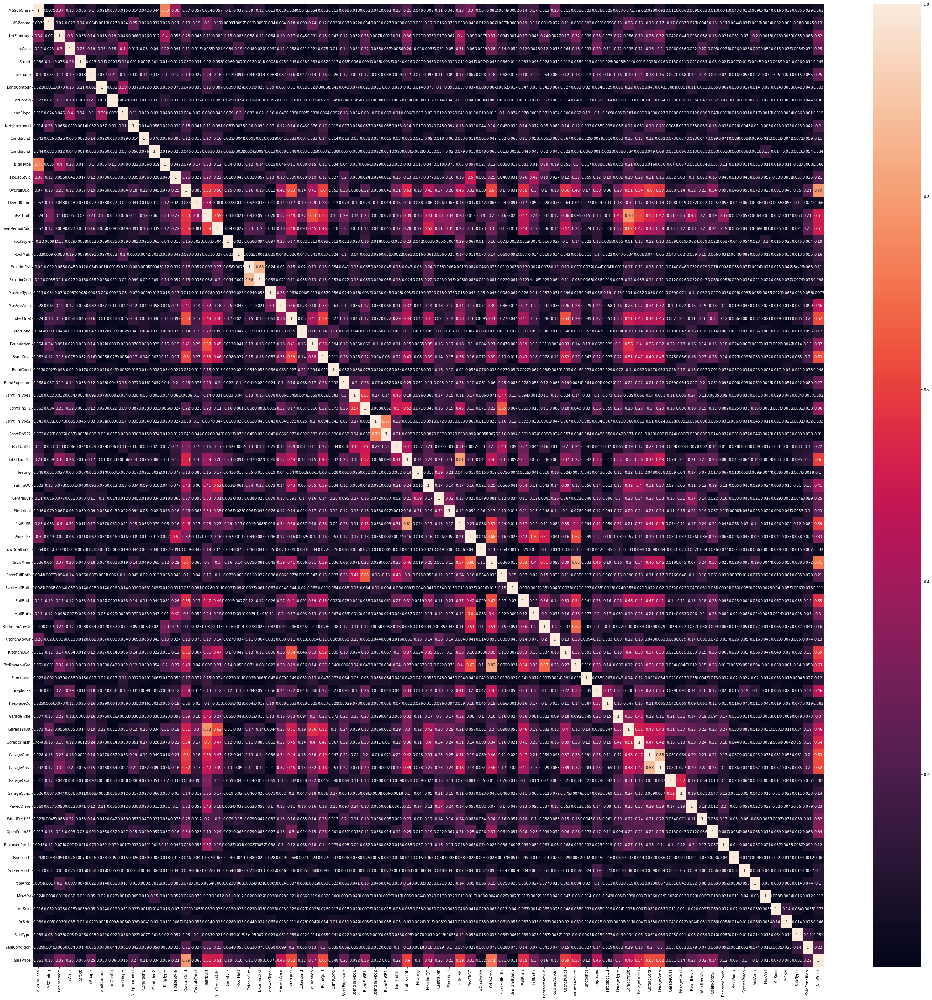

In [181]:
#Plotting heatmap
corr=data.corr().abs()
plt.figure(figsize=(48,48))
sns.heatmap(corr,annot=True)
plt.show()

**Checking outliers**

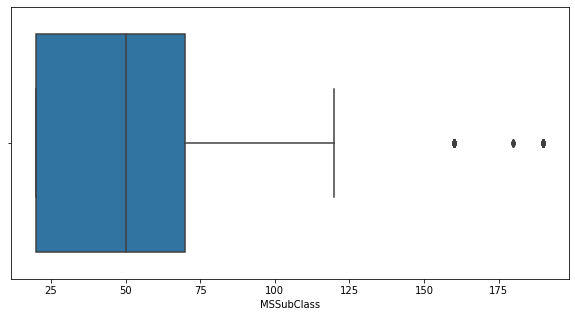

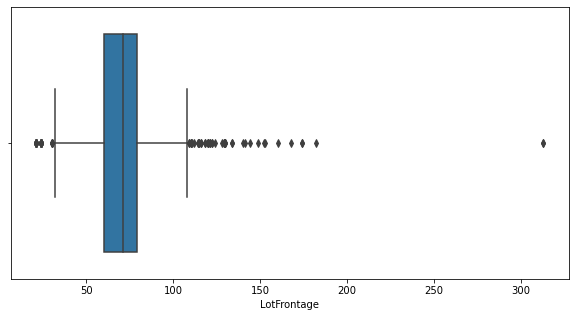

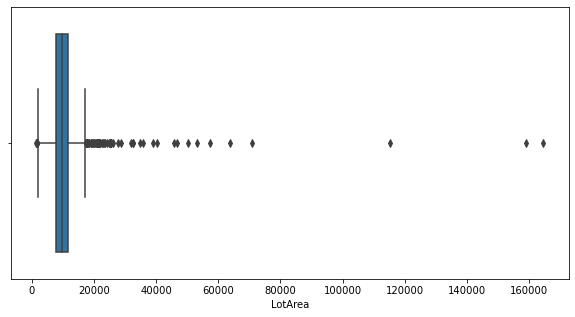

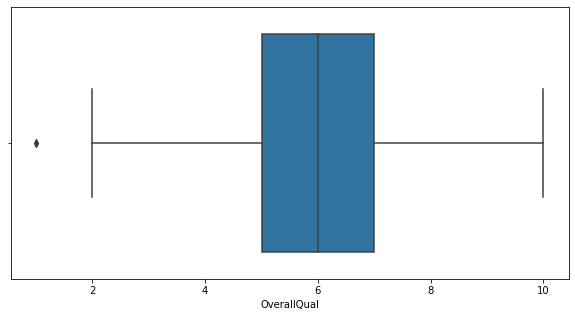

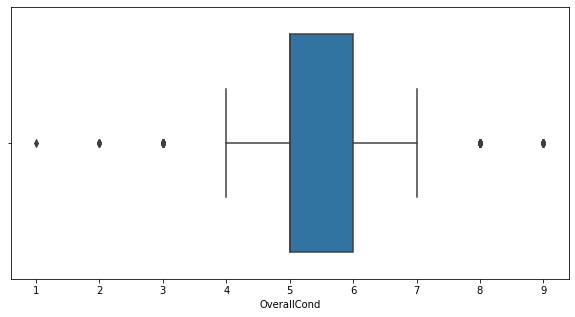

...

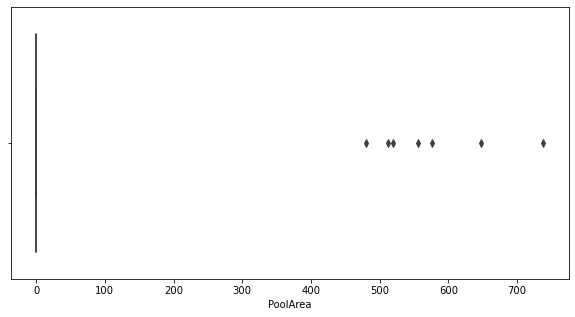

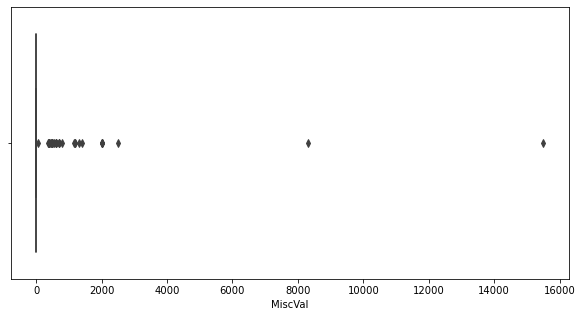

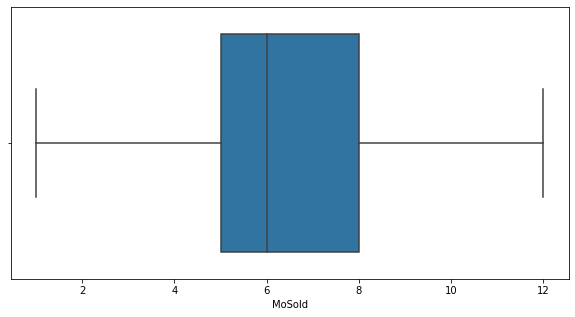

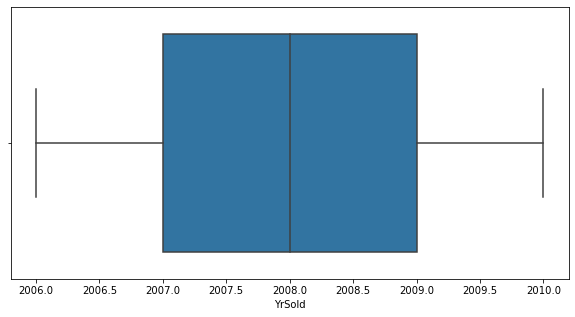

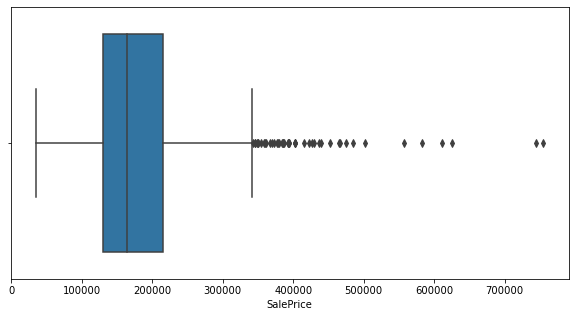

In [44]:
#plotting boxplot
for i in cont_features:
    plt.figure(figsize=(10,5))
    sns.boxplot(data[i])
    plt.show()

**In above plots we can see that columns 'MSSubClass','LotFrontage','LotArea','OverallQual','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','BedroomAbvGr','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea' and 'MiscVal' have outliers.So using z_score method to remove the outliers.**

In [183]:
#Importing required libraries
from scipy.stats import zscore

In [184]:
#Removing outliers
z_score=zscore(data[['MSSubClass','LotFrontage','LotArea','OverallQual','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','BedroomAbvGr','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea','MiscVal']])
abs_z_score=np.abs(z_score)
threshold=3
z=(abs_z_score<3).all(axis=1)

In [185]:
data[z].shape

(808, 75)

In [186]:
data.shape

(1168, 75)

In [187]:
#Percentage Loss of Data
data_loss=((1168-808)/1168)*100
print(f'Data Loss:{data_loss} %')

Data Loss:30.82191780821918 %


**Since the data loss is more that is why not removing the outliers.**

In [188]:
#checking skewness
data[cont_features].skew()

MSSubClass        1.422019
LotFrontage       2.710383
LotArea          10.659285
OverallQual       0.175082
OverallCond       0.580714
YearBuilt        -0.579204
YearRemodAdd     -0.495864
MasVnrArea        2.834658
BsmtFinSF1        1.871606
BsmtFinSF2        4.365829
BsmtUnfSF         0.909057
TotalBsmtSF       1.744591
1stFlrSF          1.513707
2ndFlrSF          0.823479
LowQualFinSF      8.666142
GrLivArea         1.449952
BsmtFullBath      0.627106
BsmtHalfBath      4.264403
FullBath          0.057809
HalfBath          0.656492
BedroomAbvGr      0.243855
KitchenAbvGr      4.365259
TotRmsAbvGrd      0.644657
Fireplaces        0.671966
GarageYrBlt      -0.662934
GarageCars       -0.358556
GarageArea        0.189665
WoodDeckSF        1.504929
OpenPorchSF       2.410840
EnclosedPorch     3.043610
3SsnPorch         9.770611
ScreenPorch       4.105741
PoolArea         13.243711
MiscVal          23.065943
MoSold            0.220979
YrSold            0.115765
SalePrice         1.953878
d

**In this we can see that in columns 'MSSubClass','LotFrontage','LotArea','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','HalfBath','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea','MiscVal'skewness is present. so using power transform method to treat the skewness.**

In [189]:
#Importing required libraries
from sklearn.preprocessing import power_transform

In [190]:
data[['MSSubClass','LotFrontage','LotArea','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','HalfBath','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea','MiscVal']]=power_transform(data[['MSSubClass','LotFrontage','LotArea','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','HalfBath','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea','MiscVal']],method='yeo-johnson')
data[['MSSubClass','LotFrontage','LotArea','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','HalfBath','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','PoolArea','MiscVal']]

,MSSubClass,LotFrontage,LotArea,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,HalfBath,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal
0,1.370435,0.093658,-1.213954,-0.496528,0.026859,-0.613054,-0.822734,-0.112649,-0.363019,0.903777,0.099335,-0.458345,-0.871745,-0.141730,-1.236502,-0.837006,-0.238775,-0.782707,-0.169259,-0.984125,0.777879,-0.219139,0.259753,-0.959773,1.409990,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133
1,-1.167999,1.117135,1.100521,0.407009,-0.185817,-0.854247,-0.822734,0.394677,2.756067,1.027313,2.374300,2.122554,-0.871745,-0.141730,1.295050,1.176812,-0.238775,-0.782707,-0.169259,0.943901,0.777879,-0.505658,0.259753,0.781991,1.414498,-0.411301,-0.138554,3.360787,-0.077648,-0.193133
2,0.490047,0.998803,0.158048,-0.496528,0.836680,0.495717,-0.822734,0.925416,-0.363019,-0.504500,0.185571,0.058641,1.176207,-0.141730,1.003880,1.176812,-0.238775,1.268421,-0.169259,0.943901,0.777879,0.769650,0.259753,1.043999,1.198911,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133
3,-1.167999,1.495566,0.496002,0.407009,0.063582,-0.569998,1.382984,0.797133,-0.363019,1.160517,1.674462,1.574554,-0.871745,-0.141730,0.739356,-0.837006,-0.238775,-0.782707,-0.169259,0.375729,0.777879,-0.219139,0.259753,-0.959773,1.169545,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133
4,-1.167999,0.093658,1.196626,1.234321,0.063582,0.694762,1.138552,1.176115,-0.363019,-0.226633,1.200095,1.149105,-0.871745,-0.141730,0.314931,-0.837006,4.188040,-0.782707,-0.169259,0.943901,0.777879,-0.219139,0.259753,1.135369,-1.061392,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133
5,0.490047,-0.552490,0.855555,-0.496528,1.306916,1.129584,-0.822734,-1.347679,-0.363019,0.783582,-0.354679,-0.735659,1.195992,-0.141730,0.770280,-0.837006,-0.238775,1.268421,-0.169259,1.457867,0.777879,1.311036,1.755634,0.852307,0.275826,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133
6,-1.167999,0.093658,0.424957,0.407009,-0.604366,0.431920,1.211377,1.207441,-0.363019,-1.139284,0.772662,0.718084,-0.871745,-0.141730,-0.109011,1.176812,-0.238775,1.268421,-0.169259,-0.984125,0.777879,-0.969263,0.259753,-0.959773,-1.061392,-0.411301,-0.138554,3.360729,-0.077648,-0.193133
7,-1.167999,0.837233,0.717859,-1.498082,-0.604366,0.694762,0.994089,0.033227,2.756025,-0.419477,0.222909,1.506962,-0.871745,-0.141730,0.671524,1.176812,-0.238775,-0.782707,-0.169259,0.943901,0.777879,-0.969263,0.259753,-0.959773,-1.061392,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133
8,-1.167999,0.047197,0.001967,1.234321,-0.353399,-1.034450,-0.822734,0.790917,2.753010,-0.072115,0.396651,0.292451,-0.871745,-0.141730,-0.521850,1.176812,-0.238775,-0.782707,-0.169259,-0.260346,-1.028333,-0.693948,0.259753,-0.959773,-1.061392,2.433545,-0.138554,-0.297551,-0.077648,5.177791
9,0.237618,0.499839,-0.152859,-0.496528,-0.890493,-1.478940,-0.822734,0.520753,-0.363019,-0.142851,-0.465773,-0.913990,1.008871,-0.141730,-0.516883,-0.837006,-0.238775,-0.782707,-0.169259,-0.260346,-1.028333,-1.272862,-1.063204,1.002061,-1.061392,2.430968,-0.138554,-0.297551,-0.077648,-0.193133


In [191]:
#checking skewness
data[cont_features].skew()

MSSubClass        0.064007
LotFrontage       0.161368
LotArea           0.032509
OverallQual       0.175082
OverallCond       0.048063
YearBuilt        -0.126641
YearRemodAdd     -0.225131
MasVnrArea        0.416370
BsmtFinSF1       -0.404528
BsmtFinSF2        2.394737
BsmtUnfSF        -0.284390
TotalBsmtSF       0.286779
1stFlrSF         -0.002391
2ndFlrSF          0.280208
LowQualFinSF      6.922843
GrLivArea        -0.000054
BsmtFullBath      0.365488
BsmtHalfBath      3.954345
FullBath          0.057809
HalfBath          0.498003
BedroomAbvGr      0.243855
KitchenAbvGr     -2.370593
TotRmsAbvGrd      0.002332
Fireplaces        0.084950
GarageYrBlt      -0.132523
GarageCars       -0.022970
GarageArea        0.189665
WoodDeckSF        0.113026
OpenPorchSF      -0.002749
EnclosedPorch     2.022616
3SsnPorch         7.087955
ScreenPorch       3.067153
PoolArea         12.817372
MiscVal           4.991071
MoSold            0.220979
YrSold            0.115765
SalePrice         1.953878
d

In [192]:
#Dividing dataset into features and label
#Features
x=data.drop(['SalePrice'],axis=1)
#Label
y=data['SalePrice']

In [193]:
#Standardiziing the data
#Importing require libraries
from sklearn.preprocessing import StandardScaler
Scaler=StandardScaler()
x_scaler=Scaler.fit_transform(x)
x_scaler

array([[ 1.37043472, -0.02164599,  0.09365762, ..., -0.60548713,
         0.33003329,  0.20793187],
       [-1.16799937, -0.02164599,  1.11713521, ..., -0.60548713,
         0.33003329,  0.20793187],
       [ 0.4900471 , -0.02164599,  0.99880298, ..., -0.60548713,
         0.33003329,  0.20793187],
       ...,
       [ 1.70079775, -0.02164599, -2.8528568 , ...,  0.8992128 ,
         0.33003329,  0.20793187],
       [ 0.69655685, -4.76211672, -0.99629595, ...,  0.14686284,
         0.33003329,  0.20793187],
       [ 0.4900471 , -0.02164599,  0.09365762, ..., -1.3578371 ,
         0.33003329,  0.20793187]])

In [194]:
x_scaler.shape

(1168, 74)

In [195]:
#Importing require libraries
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [196]:
vif=pd.DataFrame()
vif['vif']=[variance_inflation_factor(x_scaler,i)for i in range(x_scaler.shape[1])]
vif['feature']=x.columns
vif

,vif,feature
0,6.067636,MSSubClass
1,1.389783,MSZoning
2,2.187382,LotFrontage
3,2.889002,LotArea
4,1.180407,Street
5,1.299858,LotShape
6,1.330009,LandContour
7,1.161807,LotConfig
8,1.494803,LandSlope
9,1.277217,Neighborhood


In [198]:
x=data.drop(['MSSubClass','YearBuilt','BsmtFinSF1','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','GrLivArea','TotRmsAbvGrd','GarageYrBlt','GarageCars','GarageArea','SalePrice'],axis=1)
x

,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,BsmtFinSF2,Heating,HeatingQC,CentralAir,Electrical,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,Functional,Fireplaces,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,3,0.093658,-1.213954,1,0,3,4,0,13,2,2,4,2,6,-0.496528,-0.613054,1,1,8,9,2,-0.822734,3,4,1,2,3,3,0,5,-0.363019,1,4,1,4,-0.141730,-0.837006,-0.238775,2,-0.782707,2,-0.169259,3,6,0.777879,4,1,1,4,4,2,-0.959773,1.409990,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133,2,2007,8,4
1,3,1.117135,1.100521,1,0,3,4,1,12,2,2,0,2,8,0.407009,-0.854247,0,5,12,13,2,-0.822734,2,2,2,3,1,1,0,4,2.756067,1,0,1,4,-0.141730,1.176812,-0.238775,2,-0.782707,4,-0.169259,2,6,0.777879,4,1,2,4,4,2,0.781991,1.414498,-0.411301,-0.138554,3.360787,-0.077648,-0.193133,10,2007,8,4
2,3,0.998803,0.158048,1,0,3,1,0,15,2,2,0,5,7,-0.496528,0.495717,1,1,7,7,2,-0.822734,2,4,2,2,3,0,2,5,-0.363019,1,0,1,4,-0.141730,1.176812,-0.238775,2,1.268421,3,-0.169259,3,6,0.777879,4,1,2,4,4,2,1.043999,1.198911,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133,6,2007,8,4
3,3,1.495566,0.496002,1,0,3,4,0,14,2,2,0,2,6,0.407009,-0.569998,3,1,8,9,1,1.382984,3,4,1,2,3,3,1,5,-0.363019,1,0,1,4,-0.141730,-0.837006,-0.238775,2,-0.782707,3,-0.169259,3,6,0.777879,4,1,1,4,4,2,-0.959773,1.169545,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133,1,2010,0,4
4,3,0.093658,1.196626,1,0,3,2,0,14,2,2,0,2,6,1.234321,0.694762,1,1,4,4,3,1.138552,2,4,1,2,3,3,0,5,-0.363019,1,2,1,4,-0.141730,-0.837006,4.188040,2,-0.782707,3,-0.169259,2,6,0.777879,4,1,0,4,4,2,1.135369,-1.061392,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133,6,2009,8,4
5,3,-0.552490,0.855555,1,0,3,4,0,8,2,2,0,5,7,-0.496528,1.129584,1,1,11,12,2,-0.822734,2,4,2,2,3,0,5,5,-0.363019,1,0,1,4,-0.141730,-0.837006,-0.238775,2,1.268421,4,-0.169259,2,6,0.777879,2,3,0,4,4,2,0.852307,0.275826,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133,11,2006,6,5
6,3,0.093658,0.424957,1,0,3,4,0,19,2,2,0,2,5,0.407009,0.431920,3,1,12,13,1,1.211377,3,4,1,2,3,3,0,5,-0.363019,1,4,1,4,-0.141730,1.176812,-0.238775,1,1.268421,3,-0.169259,3,4,0.777879,2,5,2,4,4,2,-0.959773,-1.061392,-0.411301,-0.138554,3.360729,-0.077648,-0.193133,5,2010,8,4
7,3,0.837233,0.717859,1,3,3,0,0,19,2,2,0,2,5,-1.498082,0.694762,1,1,12,13,0,0.994089,3,4,1,3,3,3,4,1,2.756025,1,0,1,4,-0.141730,1.176812,-0.238775,2,-0.782707,3,-0.169259,3,0,0.777879,4,1,1,4,4,2,-0.959773,-1.061392,-0.411301,-0.138554,-0.297551,-0.077648,-0.193133,1,2006,8,4
8,3,0.047197,0.001967,1,3,3,0,0,7,1,2,0,2,5,1.234321,-1.034450,3,1,7,7,2,-0.822734,3,4,1,3,3,3,0,2,2.753010,1,0,1,4,-0.141730,1.176812,-0.238775,1,-0.782707,2,-0.169259,3,6,-1.028333,2,5,2,1,1,2,-0.959773,-1.061392,2.433545,-0.138554,-0.297551,-0.077648,5.177791,4,2007,8,4
9,3,0.499839,-0.152859,1,3,3,4,0,12,2,2,0,0,5,-0.496528,-1.478940,1,1,7,7,2,-0.822734,3,4,1,3,3,3,4,5,-0.363019,1,4,1,4,-0.141730,-0.837006,-0.238775,1,-0.782707,2,-0.169259,3,6,-1.028333,2,5,2,4,4,2,1.002061,-1.061392,2.430968,-0.138554,-0.297551,-0.077648,-0.193133,10,2008,0,0


In [200]:
x.shape

(1168, 62)

In [201]:
#importing required libraries
from sklearn.feature_selection import SelectKBest, f_classif

In [203]:
best_features=SelectKBest(score_func=f_classif,k=50)
fit=best_features.fit(x,y)
data_scores=pd.DataFrame(fit.scores_)
data_columns=pd.DataFrame(x.columns)
feature_scores=pd.concat([data_columns,data_scores],axis=1)
feature_scores.columns=['Feature_Name','Score']
print(feature_scores.nlargest(50,'Score'))

     Feature_Name     Score
13    OverallQual  5.303071
22      ExterQual  3.514221
25       BsmtQual  2.876879
42    KitchenQual  2.617125
38       FullBath  2.435854
47   GarageFinish  2.187163
15   YearRemodAdd  1.871641
3          Street  1.835751
31        Heating  1.707885
44     Fireplaces  1.647757
0        MSZoning  1.640044
52    OpenPorchSF  1.613273
33     CentralAir  1.557680
24     Foundation  1.528516
4        LotShape  1.407526
2         LotArea  1.405080
32      HeatingQC  1.358939
39       HalfBath  1.324900
8    Neighborhood  1.281079
21     MasVnrArea  1.271172
51     WoodDeckSF  1.246439
27   BsmtExposure  1.214154
1     LotFrontage  1.212723
45    FireplaceQu  1.203591
26       BsmtCond  1.190161
17       RoofMatl  1.179426
20     MasVnrType  1.171156
46     GarageType  1.169772
40   BedroomAbvGr  1.146460
34     Electrical  1.145835
11       BldgType  1.115411
14    OverallCond  1.086256
16      RoofStyle  1.072146
18    Exterior1st  1.055598
7       LandSlope  1

In [204]:
new_feature=data[['OverallQual','ExterQual','GrLivArea','BsmtQual','KitchenQual','FullBath','GarageFinish','YearRemodAdd','Street','Heating','Fireplaces','MSZoning','OpenPorchSF','CentralAir','Foundation','LotShape','LotArea','HeatingQC','HalfBath','Neighborhood','MasVnrArea','WoodDeckSF','BsmtExposure','LotFrontage','FireplaceQu','BsmtCond','RoofMatl','MasVnrType','GarageType','BedroomAbvGr','Electrical','BldgType','OverallCond','RoofStyle','Exterior1st','LandSlope','Exterior2nd','BsmtFullBath','LandContour','SaleCondition','YrSold','PavedDrive','GarageQual','LotConfig','BsmtFinType1','EnclosedPorch','ExterCond','MiscVal','LowQualFinSF','MoSold','HouseStyle']]
new_feature

,OverallQual,ExterQual,GrLivArea,BsmtQual,KitchenQual,FullBath,GarageFinish,YearRemodAdd,Street,Heating,Fireplaces,MSZoning,OpenPorchSF,CentralAir,Foundation,LotShape,LotArea,HeatingQC,HalfBath,Neighborhood,MasVnrArea,WoodDeckSF,BsmtExposure,LotFrontage,FireplaceQu,BsmtCond,RoofMatl,MasVnrType,GarageType,BedroomAbvGr,Electrical,BldgType,OverallCond,RoofStyle,Exterior1st,LandSlope,Exterior2nd,BsmtFullBath,LandContour,SaleCondition,YrSold,PavedDrive,GarageQual,LotConfig,BsmtFinType1,EnclosedPorch,ExterCond,MiscVal,LowQualFinSF,MoSold,HouseStyle
0,6,3,-1.236502,2,3,2,1,-0.613054,1,1,0.777879,3,1.409990,1,1,0,-1.213954,4,-0.782707,13,-0.822734,-0.959773,3,0.093658,4,3,1,2,1,2,4,4,-0.496528,1,8,0,9,-0.837006,3,4,2007,2,4,4,0,-0.411301,4,-0.193133,-0.141730,2,2
1,8,2,1.295050,3,2,2,2,-0.854247,1,1,0.777879,3,1.414498,1,2,0,1.100521,0,-0.782707,12,-0.822734,0.781991,1,1.117135,4,1,5,2,1,4,4,0,0.407009,0,12,1,13,1.176812,3,4,2007,2,4,4,0,-0.411301,2,-0.193133,-0.141730,10,2
2,7,2,1.003880,2,3,2,2,0.495717,1,1,0.777879,3,1.198911,1,2,0,0.158048,0,1.268421,15,-0.822734,1.043999,0,0.998803,4,3,1,2,1,3,4,0,-0.496528,1,7,0,7,1.176812,3,4,2007,2,4,1,2,-0.411301,4,-0.193133,-0.141730,6,5
3,6,3,0.739356,2,3,2,1,-0.569998,1,1,0.777879,3,1.169545,1,1,0,0.496002,0,-0.782707,14,1.382984,-0.959773,3,1.495566,4,3,1,1,1,3,4,0,0.407009,3,8,0,9,-0.837006,3,4,2010,2,4,4,1,-0.411301,4,-0.193133,-0.141730,1,2
4,6,2,0.314931,2,2,2,0,0.694762,1,1,0.777879,3,-1.061392,1,1,0,1.196626,2,-0.782707,14,1.138552,1.135369,3,0.093658,4,3,1,3,1,3,4,0,1.234321,1,4,0,4,-0.837006,3,4,2009,2,4,2,0,-0.411301,4,-0.193133,-0.141730,6,2
5,7,2,0.770280,2,2,2,0,1.129584,1,1,0.777879,3,0.275826,1,2,0,0.855555,0,1.268421,8,-0.822734,0.852307,0,-0.552490,2,3,1,2,3,4,4,0,-0.496528,1,11,0,12,-0.837006,3,5,2006,2,4,4,5,-0.411301,4,-0.193133,-0.141730,11,5
6,5,3,-0.109011,2,3,1,2,0.431920,1,1,0.777879,3,-1.061392,1,1,0,0.424957,4,1.268421,19,1.211377,-0.959773,3,0.093658,2,3,1,1,5,3,4,0,0.407009,3,12,0,13,1.176812,3,4,2010,2,4,4,0,-0.411301,4,-0.193133,-0.141730,5,2
7,5,3,0.671524,3,3,2,1,0.694762,1,1,0.777879,3,-1.061392,1,1,3,0.717859,0,-0.782707,19,0.994089,-0.959773,3,0.837233,4,3,1,0,1,3,4,0,-1.498082,1,12,0,13,1.176812,3,4,2006,2,4,0,4,-0.411301,4,-0.193133,-0.141730,1,2
8,5,3,-0.521850,3,3,1,2,-1.034450,1,1,-1.028333,3,-1.061392,1,1,3,0.001967,0,-0.782707,7,-0.822734,-0.959773,3,0.047197,2,3,1,2,5,2,4,0,1.234321,3,7,0,7,1.176812,3,4,2007,2,1,0,0,2.433545,4,5.177791,-0.141730,4,2
9,5,3,-0.516883,3,3,1,2,-1.478940,1,1,-1.028333,3,-1.061392,1,1,3,-0.152859,4,-0.782707,12,-0.822734,1.002061,3,0.499839,2,3,1,2,5,2,4,0,-0.496528,1,7,0,7,-0.837006,3,0,2008,2,4,4,4,2.430968,4,-0.193133,-0.141730,10,0


In [205]:
#Standardiziing the data
#Importing require libraries
from sklearn.preprocessing import StandardScaler
Scaler=StandardScaler()
x_scaler=Scaler.fit_transform(new_feature)
x_scaler

array([[-0.07516928,  0.67109308, -1.23650212, ..., -0.1417298 ,
        -1.61782184, -0.54993041],
       [ 1.36413763, -0.7592659 ,  1.29505029, ..., -0.1417298 ,
         1.3614701 , -0.54993041],
       [ 0.64448417, -0.7592659 ,  1.00388038, ..., -0.1417298 ,
        -0.12817587,  1.03083757],
       ...,
       [-0.07516928,  0.67109308,  0.02661708, ..., -0.1417298 ,
         0.24423562,  1.03083757],
       [-1.5144762 ,  0.67109308, -0.27612505, ..., -0.1417298 ,
         0.24423562,  1.03083757],
       [-0.07516928, -0.7592659 ,  0.13449301, ..., -0.1417298 ,
        -0.12817587,  1.03083757]])

In [206]:
#Importing required libraries
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
import xgboost as xgb
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from sklearn.metrics import r2_score
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_absolute_error,mean_squared_error

**Xtreme Gradient Regressor**

In [207]:
xgb=xgb.XGBRegressor()

In [208]:
#using range fucntion to find the best random state using Logestic regression
for i in range(0,200):
    x_train,x_test,y_train,y_test=train_test_split(x_scaler,y,test_size=0.25,random_state=i)
    xgb.fit(x_train,y_train)
    pred=xgb.predict(x_train)
    y_pred=xgb.predict(x_test)
    print(f'at random state {i}, training accuracy is {metrics.r2_score(y_train,pred)*100}')
    print(f'at random state {i}, testing accuracy is {metrics.r2_score(y_test,y_pred)*100}')
    print('\n')

at random state 0, training accuracy is 99.99385679605129
at random state 0, testing accuracy is 86.0847331635874


at random state 1, training accuracy is 99.99386833107555
at random state 1, testing accuracy is 83.83691276916369


at random state 2, training accuracy is 99.99062867312708
at random state 2, testing accuracy is 83.92285313638486


at random state 3, training accuracy is 99.99275659132344
at random state 3, testing accuracy is 85.95845044694302


at random state 4, training accuracy is 99.99082068213744
at random state 4, testing accuracy is 86.81664265298231


at random state 5, training accuracy is 99.99417808695581
at random state 5, testing accuracy is 58.307553817619564


at random state 6, training accuracy is 99.99326159052248
at random state 6, testing accuracy is 87.67547644652748


at random state 7, training accuracy is 99.98931760976392
at random state 7, testing accuracy is 85.03781067972143


at random state 8, training accuracy is 99.99374639987089
at ran

**Taking random state=135**

In [215]:
#since random state  has highest testing score,so taking random state as 
x_train,x_test,y_train,y_test=train_test_split(x_scaler,y,test_size=0.25,random_state=135)

In [216]:
#Training the Model
xgb.fit(x_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, ...)

In [217]:
pred=xgb.predict(x_train)
y_pred=xgb.predict(x_test)

In [218]:
#Printing the training and testing score
print('\n Training Score:',metrics.r2_score(y_train,pred)*100)
print('\n Testing Score:',metrics.r2_score(y_test,y_pred)*100)


 Training Score: 99.99032532302934

 Testing Score: 90.97878191275495


In [219]:
train_accuracy=metrics.r2_score(y_train,pred)
test_accuracy=metrics.r2_score(y_test,y_pred)

In [220]:
#Checking cross validation score for Gradient Boosting
for j in range(2,6):
    cv_score=cross_val_score(xgb,x_scaler,y,cv=j)
    cv_mean=cv_score.mean()
    print(f'at cross fold {j} the cv score is {cv_mean}and accuracy for the testing is {test_accuracy}')
    print('\n')

at cross fold 2 the cv score is 0.7922563487573138and accuracy for the testing is 0.9097878191275495


at cross fold 3 the cv score is 0.8390049282376558and accuracy for the testing is 0.9097878191275495


at cross fold 4 the cv score is 0.8079337281604266and accuracy for the testing is 0.9097878191275495


at cross fold 5 the cv score is 0.8199486438206277and accuracy for the testing is 0.9097878191275495




**taking cv=3**

In [221]:
#mean absolute error
mean_absolute_error(y_test,y_pred)

18617.24954516267

In [222]:
#mean squared error
mean_squared_error(y_test,y_pred)

659125462.0218775

In [223]:
#Root mean squared error
np.sqrt(mean_squared_error(y_test,y_pred))

25673.4388429341

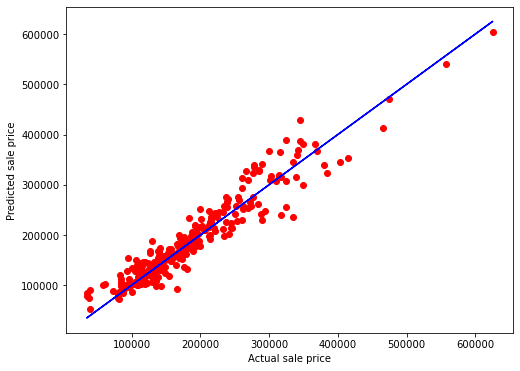

In [224]:
#Plotting the best fit line
plt.figure(figsize=(8,6))
plt.scatter(x=y_test,y=y_pred,color='red')
plt.plot(y_test,y_test,color='blue')
plt.xlabel('Actual sale price',fontsize=10)
plt.ylabel('Predicted sale price',fontsize=10)
plt.show()

**Gradient Boosting**

In [257]:
#Instantiating Gradient Boosting
gb=GradientBoostingRegressor()

In [258]:
#since random state  has highest testing score,so taking random state as 
x_train,x_test,y_train,y_test=train_test_split(x_scaler,y,test_size=0.25,random_state=135)

In [259]:
#Training the Model
gb.fit(x_train,y_train)

GradientBoostingRegressor()

In [260]:
pred=gb.predict(x_train)
y_pred=gb.predict(x_test)

In [261]:
#Printing Training and testing score
print('\n Training Score:',metrics.r2_score(y_train,pred)*100)
print('\n Testing score:',metrics.r2_score(y_test,y_pred)*100)


 Training Score: 95.56101098754579

 Testing score: 91.2862131362734


In [262]:
train_accuracy=metrics.r2_score(y_train,pred)
test_accuracy=metrics.r2_score(y_test,y_pred)

In [263]:
#Checking cross validation score for XGBoost
cv_score=cross_val_score(gb,x_scaler,y,cv=3).mean()
cv_score

0.8492358888670711

In [264]:
#Mean Absolute Error
mean_absolute_error(y_test,y_pred)

18300.582066591644

In [265]:
#Mean Squared Error
mean_squared_error(y_test,y_pred)

636663334.9253095

In [266]:
#Root mean squared error
np.sqrt(mean_squared_error(y_test,y_pred))

25232.188468805267

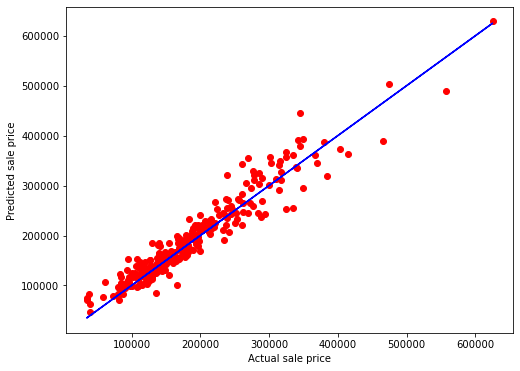

In [267]:
#Plotting the best fit line
plt.figure(figsize=(8,6))
plt.scatter(x=y_test,y=y_pred,color='red')
plt.plot(y_test,y_test,color='blue')
plt.xlabel('Actual sale price',fontsize=10)
plt.ylabel('Predicted sale price',fontsize=10)
plt.show()

**Ada Boost**

In [268]:
#Instantiating Ada Boost Regressor
ada=AdaBoostRegressor()

In [269]:
#since random state  has highest testing score,so taking random state as 
x_train,x_test,y_train,y_test=train_test_split(x_scaler,y,test_size=0.25,random_state=135)

In [270]:
#Training the data
ada.fit(x_train,y_train)

AdaBoostRegressor()

In [271]:
pred=ada.predict(x_train)
y_pred=ada.predict(x_test)

In [272]:
#Printing Training and Testing score
print('\n Training Score:',metrics.r2_score(y_train,pred)*100)
print('\n Testing Score:',metrics.r2_score(y_test,y_pred)*100)


 Training Score: 85.59733202911501

 Testing Score: 83.503365161354


In [273]:
train_accuracy=metrics.r2_score(y_train,pred)
test_accuracy=metrics.r2_score(y_test,y_pred)

In [274]:
#Checking cross validation score for XGBoost
cv_score=cross_val_score(ada,x_scaler,y,cv=3).mean()
cv_score

0.7958411918131584

In [275]:
#Mean Absolute Error
mean_absolute_error(y_test,y_pred)

25143.88420523422

In [276]:
#Mean Squared Error
mean_squared_error(y_test,y_pred)

1205308635.116848

In [277]:
#Root mean squared error
np.sqrt(mean_squared_error(y_test,y_pred))

34717.55514313829

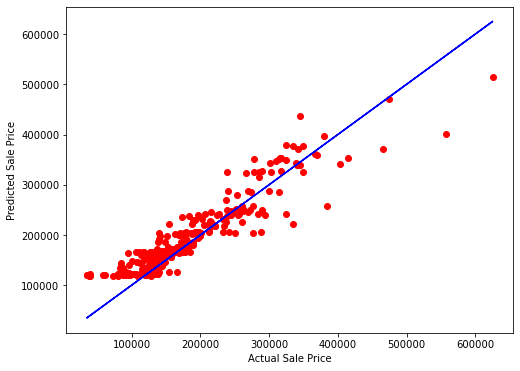

In [278]:
#Plotting the best fit line
plt.figure(figsize=(8,6))
plt.scatter(x=y_test,y=y_pred,color='red')
plt.plot(y_test,y_test,color='blue')
plt.xlabel('Actual Sale Price',fontsize=10)
plt.ylabel('Predicted Sale Price',fontsize=10)
plt.show()

**Random Forest Classifier**

In [279]:
#Instantiating XGBoost
rf=RandomForestRegressor()

In [280]:
#since random state  has highest testing score,so taking random state as 
x_train,x_test,y_train,y_test=train_test_split(x_scaler,y,test_size=0.25,random_state=135)

In [281]:
#Training data
rf.fit(x_train,y_train)

RandomForestRegressor()

In [282]:
pred=rf.predict(x_train)
y_pred=rf.predict(x_test)

In [283]:
#Printing Training and Testing Score
print('\n Training Score:',metrics.r2_score(y_train,pred)*100)
print('\n Testing Score:',metrics.r2_score(y_test,y_pred)*100)


 Training Score: 96.49362658287126

 Testing Score: 89.26454217199294


In [284]:
#Checking cross validation score for XGBoost
cv_score=cross_val_score(rf,x_scaler,y,cv=3).mean()
cv_score

0.8315485809742528

In [285]:
#Mean Absolute Error
mean_absolute_error(y_test,y_pred)

19573.800445205477

In [286]:
#Mean Squared Error
mean_squared_error(y_test,y_pred)

784374519.3241906

In [287]:
#Root mean squared error
np.sqrt(mean_squared_error(y_test,y_pred))

28006.687046564264

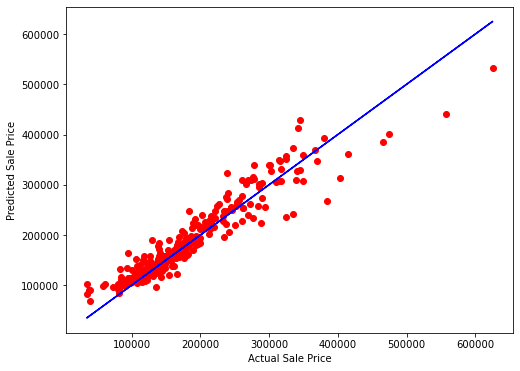

In [288]:
#Plotting the best fit line
plt.figure(figsize=(8,6))
plt.scatter(x=y_test,y=y_pred,color='red')
plt.plot(y_test,y_test,color='blue')
plt.xlabel('Actual Sale Price',fontsize=10)
plt.ylabel('Predicted Sale Price',fontsize=10)
plt.show()

In [289]:
#Making dataframe of all the models
data=pd.DataFrame({
    'Models':['XGBoost','Gradient Boosting','Ada Boost','Random forest'],
    'Training Score':[99.99,95.56,85.59,96.49],
    'Testing Score':[90.47,91.28,83.50,89.26],
    'Cros val score':[83.90,84.92,79.58,83.15],
    'RMSE':[25673.43,25232.18,34717.55,28006.68]
})
data

,Models,Training Score,Testing Score,Cros val score,RMSE
0,XGBoost,99.99,90.47,83.90,25673.43
1,Gradient Boosting,95.56,91.28,84.92,25232.18
2,Ada Boost,85.59,83.50,79.58,34717.55
3,Random forest,96.49,89.26,83.15,28006.68


**Observation**
* **After comparing the training score testing score and cross validation score Gradient bossting is the best model to go forward as it also have less root mean square error and highest testing score and cross validation score.**

In [290]:
#Using Grid Search cv for hyperparameter tuning for Gradient Boosting
from sklearn.model_selection import GridSearchCV

In [291]:
param_grid=({
    'loss':['squared_error','absolute_error','huber','quantile'],
    'learning_rate': [0.1,0.2],
    'n_estimators':[100,150],
    'subsample':[0.1,0.2,0.3],
    'criterion':['friedman_mse','squared_error','mse']
})

In [292]:
grid_search=GridSearchCV(gb,param_grid=param_grid,cv=3)

In [293]:
#Training
grid_search.fit(x_train,y_train)

GridSearchCV(cv=3, estimator=GradientBoostingRegressor(),
             param_grid={'criterion': ['friedman_mse', 'squared_error', 'mse'],
                         'learning_rate': [0.1, 0.2],
                         'loss': ['squared_error', 'absolute_error', 'huber',
                                  'quantile'],
                         'n_estimators': [100, 150],
                         'subsample': [0.1, 0.2, 0.3]})

In [294]:
#best Parameters
grid_search.best_params_ 

{'criterion': 'mse',
 'learning_rate': 0.1,
 'loss': 'absolute_error',
 'n_estimators': 150,
 'subsample': 0.2}

In [295]:
#Training with the best parameters
gb1=GradientBoostingRegressor(criterion='mse',learning_rate=0.1,loss='absolute_error',n_estimators=150,subsample=0.2)
gb1.fit(x_train,y_train)

GradientBoostingRegressor(criterion='mse', loss='absolute_error',
                          n_estimators=150, subsample=0.2)

In [296]:
#Printing the training and testing score
print('\n Training Score:',metrics.r2_score(y_train,pred)*100)
print('\n Testing Score:',metrics.r2_score(y_test,y_pred)*100)


 Training Score: 96.49362658287126

 Testing Score: 89.26454217199294


In [297]:
#Checking cross validation score for XGBoost
cv_score=cross_val_score(gb,x_scaler,y,cv=3).mean()
cv_score

0.855252434948856

In [298]:
#Mean Absolute Error
mean_absolute_error(y_test,y_pred)

19573.800445205477

In [299]:
#Mean Squared Error
mean_squared_error(y_test,y_pred)

784374519.3241906

In [300]:
#Root mean squared error
np.sqrt(mean_squared_error(y_test,y_pred))

28006.687046564264

**So in this we can see that after doing hyperparameter tuning the testing score,training score and cross validation decreased and root mean square error increased.So i am saving the model on which hyperparameter tuning was not done.**

In [301]:
#saving the model
#Importing required libraries
import pickle
pickle.dump(gb,open('Housing Prediction','wb'))

In [302]:
#loading test data set
data1=pd.read_csv('test_housing.csv')

In [303]:
#checking overview of the dataset
data1.head(2)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,337,20,RL,86.0,14157,Pave,NaN,IR1,HLS,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,9,5,2005,2006,Hip,CompShg,VinylSd,VinylSd,Stone,200.0,Gd,TA,PConc,Ex,TA,Gd,GLQ,1249,Unf,0,673,1922,GasA,Ex,Y,SBrkr,1922,0,0,1922,1,0,2,0,3,1,Gd,8,Typ,1,Gd,Attchd,2005.0,Fin,3,676,TA,TA,Y,178,51,0,0,0,0,NaN,NaN,NaN,0,7,2007,WD,Normal
1,1018,120,RL,NaN,5814,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,CBlock,Gd,TA,Av,GLQ,1036,Unf,0,184,1220,GasA,Gd,Y,SBrkr,1360,0,0,1360,1,0,1,0,1,1,Gd,4,Typ,1,Ex,Attchd,1984.0,RFn,2,565,TA,TA,Y,63,0,0,0,0,0,NaN,NaN,NaN,0,8,2009,COD,Abnorml


In [304]:
#checking shape
data1.shape

(292, 80)

**So we can see that there are about 292 rows and 80 columns in the dataset.**

In [305]:
#checking columns
data1.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

**This are the names of the columns.**

In [306]:
#checking data types
data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 292 entries, 0 to 291
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             292 non-null    int64  
 1   MSSubClass     292 non-null    int64  
 2   MSZoning       292 non-null    object 
 3   LotFrontage    247 non-null    float64
 4   LotArea        292 non-null    int64  
 5   Street         292 non-null    object 
 6   Alley          14 non-null     object 
 7   LotShape       292 non-null    object 
 8   LandContour    292 non-null    object 
 9   Utilities      292 non-null    object 
 10  LotConfig      292 non-null    object 
 11  LandSlope      292 non-null    object 
 12  Neighborhood   292 non-null    object 
 13  Condition1     292 non-null    object 
 14  Condition2     292 non-null    object 
 15  BldgType       292 non-null    object 
 16  HouseStyle     292 non-null    object 
 17  OverallQual    292 non-null    int64  
 18  OverallCon

**In this we can see that there are about 4 columns having float data type,34 columns having integer data type and 42 columns having object data type.**

In [307]:
#checking for null values
data1.isna().sum()

Id                 0
MSSubClass         0
MSZoning           0
LotFrontage       45
LotArea            0
Street             0
Alley            278
LotShape           0
LandContour        0
Utilities          0
LotConfig          0
LandSlope          0
Neighborhood       0
Condition1         0
Condition2         0
BldgType           0
HouseStyle         0
OverallQual        0
OverallCond        0
YearBuilt          0
YearRemodAdd       0
RoofStyle          0
RoofMatl           0
Exterior1st        0
Exterior2nd        0
MasVnrType         1
MasVnrArea         1
ExterQual          0
ExterCond          0
Foundation         0
BsmtQual           7
BsmtCond           7
BsmtExposure       7
BsmtFinType1       7
BsmtFinSF1         0
BsmtFinType2       7
BsmtFinSF2         0
BsmtUnfSF          0
TotalBsmtSF        0
Heating            0
HeatingQC          0
CentralAir         0
Electrical         1
1stFlrSF           0
2ndFlrSF           0
LowQualFinSF       0
GrLivArea          0
BsmtFullBath 

**So we can see that in columns LotFrontage,Alley,MasVnrType,MasVnrArea,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Electrical,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageQual,GarageCond,PoolQC,Fence and MiscFeature have null values.**

In [308]:
#checking the percentage
data1.isna().sum()/data1.shape[0]*100

Id                 0.000000
MSSubClass         0.000000
MSZoning           0.000000
LotFrontage       15.410959
LotArea            0.000000
Street             0.000000
Alley             95.205479
LotShape           0.000000
LandContour        0.000000
Utilities          0.000000
LotConfig          0.000000
LandSlope          0.000000
Neighborhood       0.000000
Condition1         0.000000
Condition2         0.000000
BldgType           0.000000
HouseStyle         0.000000
OverallQual        0.000000
OverallCond        0.000000
YearBuilt          0.000000
YearRemodAdd       0.000000
RoofStyle          0.000000
RoofMatl           0.000000
Exterior1st        0.000000
Exterior2nd        0.000000
MasVnrType         0.342466
MasVnrArea         0.342466
ExterQual          0.000000
ExterCond          0.000000
Foundation         0.000000
BsmtQual           2.397260
BsmtCond           2.397260
BsmtExposure       2.397260
BsmtFinType1       2.397260
BsmtFinSF1         0.000000
BsmtFinType2       2

**Dropping columns Alley,PoolQC,Fence and MiscFeature as it has more than 70% of null values.**

In [309]:
#dropping columns
data1=data1.drop(['Alley','PoolQC','Fence','MiscFeature'],axis=1)
data1.shape

(292, 76)

In [310]:
#filling up null values
for i in data1:
    if data1[i].dtype=='object':
        data1[i]=data1[i].fillna(data1[i].mode()[0])
    else:
        data1[i]=data1[i].fillna(data1[i].mean())

In [311]:
#checking for null values
data1.isna().sum()

Id               0
MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
KitchenQual 

**So we can see that all the null values have been filled.**

In [312]:
#checking number of unique values
data1.nunique()

Id               292
MSSubClass        15
MSZoning           4
LotFrontage       66
LotArea          249
Street             2
LotShape           4
LandContour        4
Utilities          2
LotConfig          5
LandSlope          3
Neighborhood      24
Condition1         8
Condition2         2
BldgType           5
HouseStyle         8
OverallQual        8
OverallCond        7
YearBuilt         84
YearRemodAdd      57
RoofStyle          5
RoofMatl           3
Exterior1st       12
Exterior2nd       14
MasVnrType         4
MasVnrArea       105
ExterQual          4
ExterCond          4
Foundation         6
BsmtQual           4
BsmtCond           3
BsmtExposure       4
BsmtFinType1       6
BsmtFinSF1       184
BsmtFinType2       6
BsmtFinSF2        32
BsmtUnfSF        231
TotalBsmtSF      224
Heating            4
HeatingQC          4
CentralAir         2
Electrical         4
1stFlrSF         238
2ndFlrSF         113
LowQualFinSF       4
GrLivArea        246
BsmtFullBath       3
BsmtHalfBath 

In [313]:
#dropping column id
data1=data1.drop(['Id'],axis=1)
data1.head(2)

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,20,RL,86.000000,14157,Pave,IR1,HLS,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,9,5,2005,2006,Hip,CompShg,VinylSd,VinylSd,Stone,200.0,Gd,TA,PConc,Ex,TA,Gd,GLQ,1249,Unf,0,673,1922,GasA,Ex,Y,SBrkr,1922,0,0,1922,1,0,2,0,3,1,Gd,8,Typ,1,Gd,Attchd,2005.0,Fin,3,676,TA,TA,Y,178,51,0,0,0,0,0,7,2007,WD,Normal
1,120,RL,66.425101,5814,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,CBlock,Gd,TA,Av,GLQ,1036,Unf,0,184,1220,GasA,Gd,Y,SBrkr,1360,0,0,1360,1,0,1,0,1,1,Gd,4,Typ,1,Ex,Attchd,1984.0,RFn,2,565,TA,TA,Y,63,0,0,0,0,0,0,8,2009,COD,Abnorml


**Dropping column Id as i dont find it relevant for prediction.**

In [314]:
#checking for duplicates
data1.duplicated().sum()

0

**So we can see that there are no duplicates in the dataset.**

In [315]:
cat_features_test=[]
for i in data1:
    if data1[i].dtype=='object':
        cat_features_test.append(i)
print(cat_features_test)

['MSZoning', 'Street', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition']


In [316]:
cont_features_test=[]
for i in data1:
    if data1[i].dtype!='object':
        cont_features_test.append(i)
print(cont_features_test)

['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold']


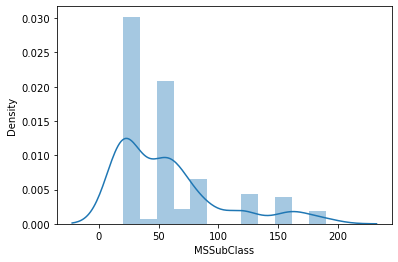

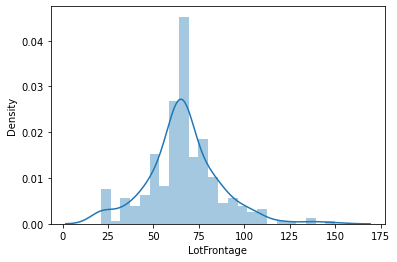

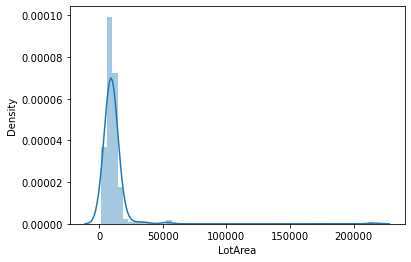

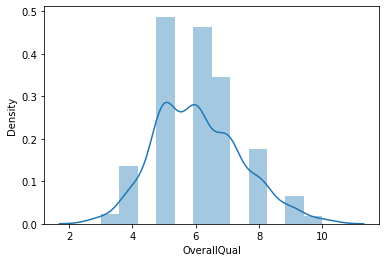

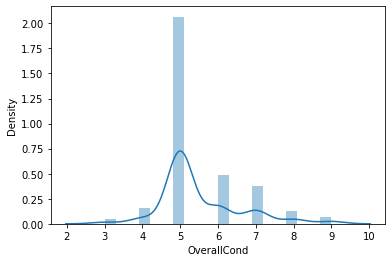

...

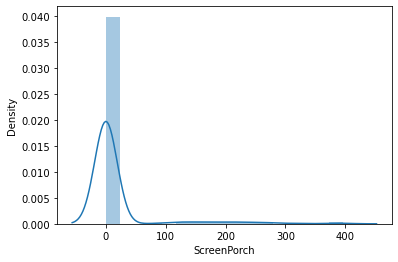

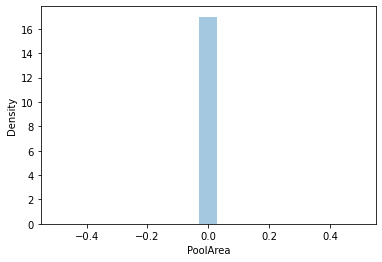

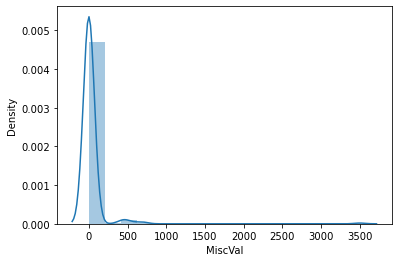

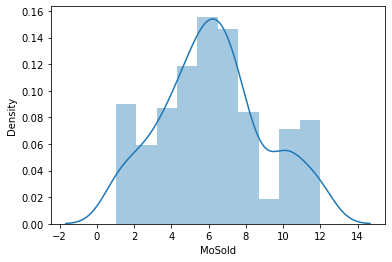

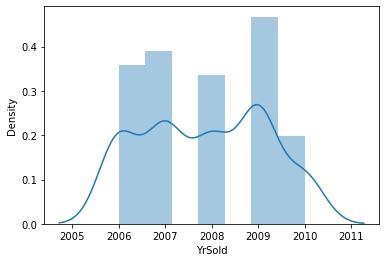

In [317]:
#plotting ditsribution plot
for i in cont_features_test:
    sns.distplot(data1[i],kde=True)
    plt.show()

**In the above plots we can see that skewness is present in most of the columns and data is also not distributed properly,so i will cross verify this at the time of checking skewness.**

RL         223
RM          55
FV          13
C (all)      1
Name: MSZoning, dtype: int64


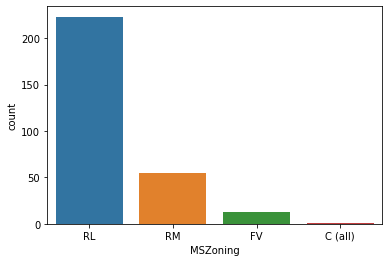

Pave    290
Grvl      2
Name: Street, dtype: int64


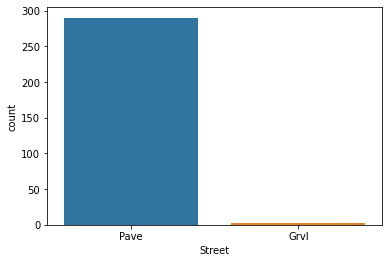

Reg    185
IR1     94
IR2      9
IR3      4
Name: LotShape, dtype: int64


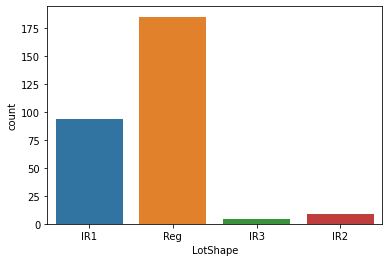

Lvl    265
Bnk     13
HLS      8
Low      6
Name: LandContour, dtype: int64


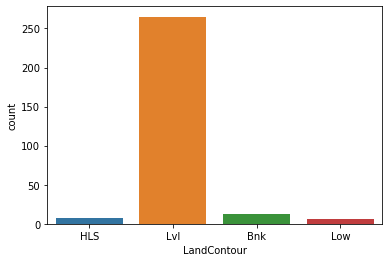

AllPub    291
NoSeWa      1
Name: Utilities, dtype: int64


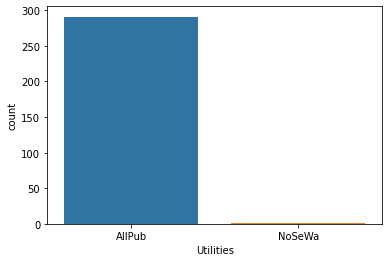

Inside     210
Corner      41
CulDSac     25
FR2         14
FR3          2
Name: LotConfig, dtype: int64


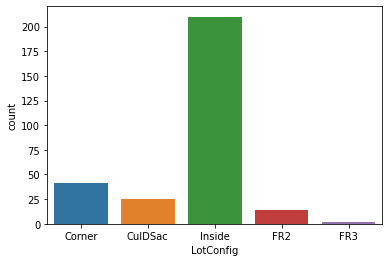

Gtl    277
Mod     14
Sev      1
Name: LandSlope, dtype: int64


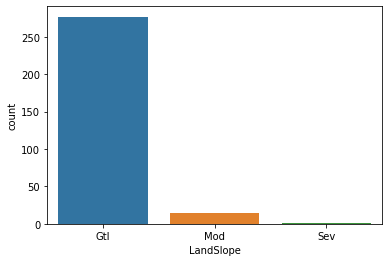

NAmes      43
CollgCr    32
OldTown    27
Somerst    18
Edwards    17
NridgHt    16
Gilbert    15
Mitchel    15
Timber     14
Sawyer     14
NWAmes     14
MeadowV     8
SawyerW     8
BrkSide     8
IDOTRR      7
NoRidge     6
StoneBr     6
Crawfor     6
BrDale      5
SWISU       4
ClearCr     4
Blmngtn     2
Veenker     2
NPkVill     1
Name: Neighborhood, dtype: int64


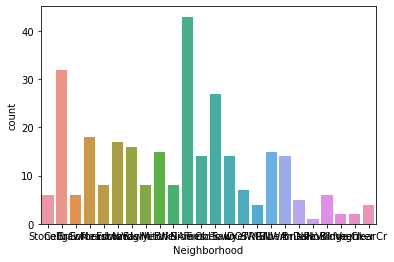

Norm      255
Feedr      14
Artery     10
RRAn        6
RRAe        2
PosN        2
PosA        2
RRNn        1
Name: Condition1, dtype: int64


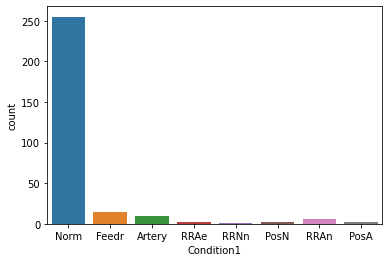

Norm    291
RRNn      1
Name: Condition2, dtype: int64


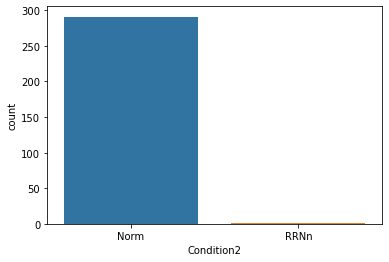

1Fam      239
TwnhsE     24
Twnhs      14
Duplex     11
2fmCon      4
Name: BldgType, dtype: int64


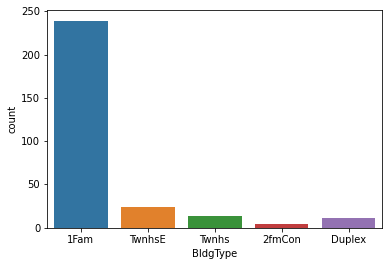

1Story    148
2Story     84
1.5Fin     33
SLvl       18
SFoyer      5
1.5Unf      2
2.5Fin      1
2.5Unf      1
Name: HouseStyle, dtype: int64


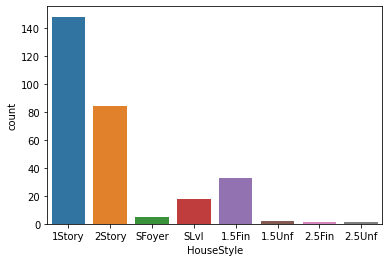

Gable      226
Hip         61
Gambrel      2
Mansard      2
Flat         1
Name: RoofStyle, dtype: int64


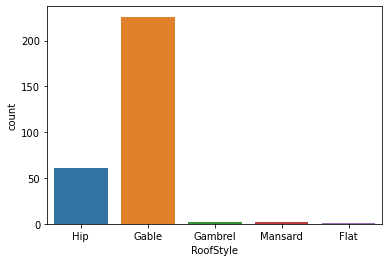

CompShg    290
WdShake      1
Tar&Grv      1
Name: RoofMatl, dtype: int64


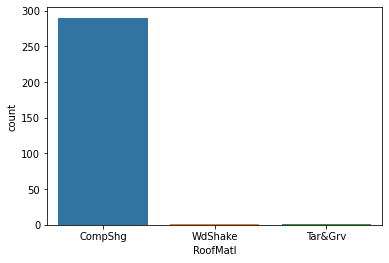

VinylSd    119
HdBoard     43
MetalSd     42
Wd Sdng     32
CemntBd     19
Plywood     15
BrkFace      9
WdShing      7
Stucco       3
AsbShng      1
BrkComm      1
CBlock       1
Name: Exterior1st, dtype: int64


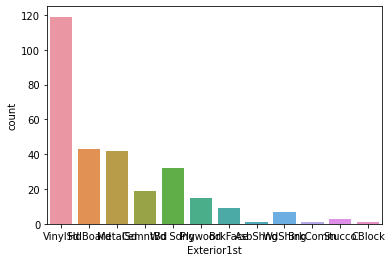

VinylSd    117
MetalSd     41
HdBoard     37
Wd Sdng     32
Plywood     24
CmentBd     18
Wd Shng      7
BrkFace      5
Stucco       3
Brk Cmn      2
ImStucc      2
AsbShng      2
Stone        1
CBlock       1
Name: Exterior2nd, dtype: int64


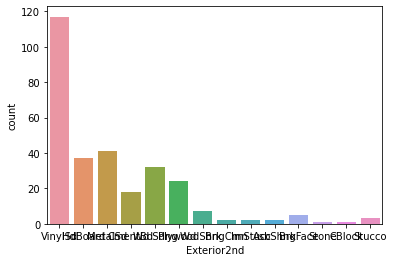

None       169
BrkFace     91
Stone       30
BrkCmn       2
Name: MasVnrType, dtype: int64


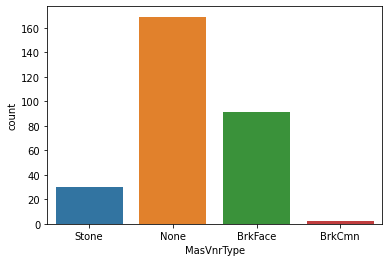

TA    189
Gd     91
Ex      9
Fa      3
Name: ExterQual, dtype: int64


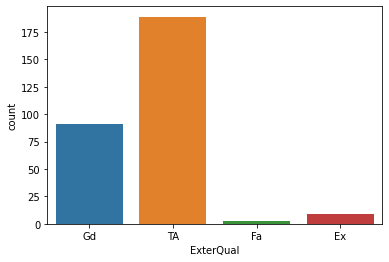

TA    260
Gd     29
Fa      2
Ex      1
Name: ExterCond, dtype: int64


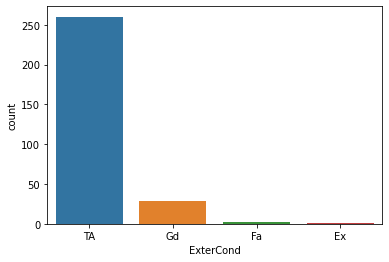

PConc     134
CBlock    118
BrkTil     34
Slab        3
Wood        2
Stone       1
Name: Foundation, dtype: int64


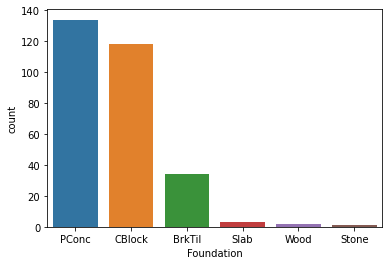

TA    139
Gd    120
Ex     27
Fa      6
Name: BsmtQual, dtype: int64


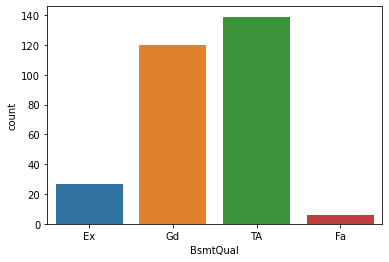

TA    277
Gd      9
Fa      6
Name: BsmtCond, dtype: int64


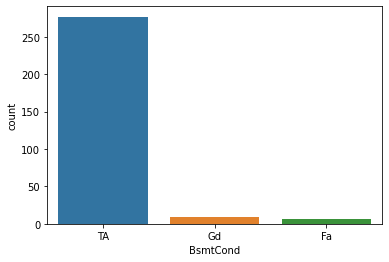

No    204
Av     41
Gd     26
Mn     21
Name: BsmtExposure, dtype: int64


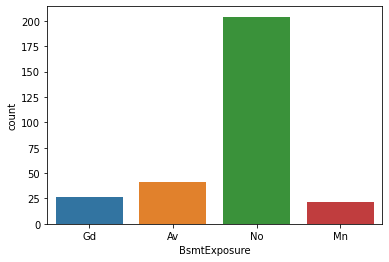

GLQ    95
Unf    85
ALQ    46
BLQ    27
Rec    24
LwQ    15
Name: BsmtFinType1, dtype: int64


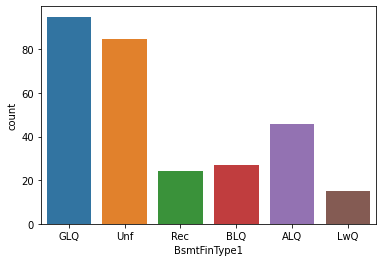

Unf    261
Rec     11
BLQ      9
LwQ      6
ALQ      3
GLQ      2
Name: BsmtFinType2, dtype: int64


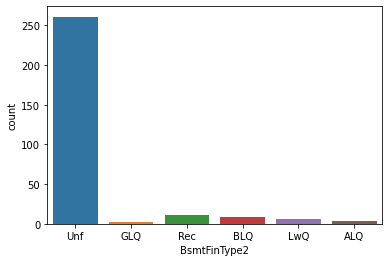

GasA    285
GasW      4
Grav      2
OthW      1
Name: Heating, dtype: int64


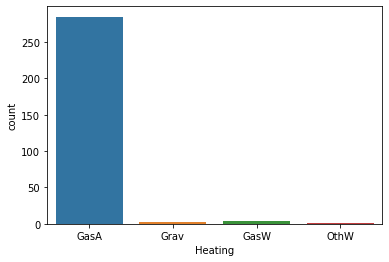

Ex    156
TA     76
Gd     49
Fa     11
Name: HeatingQC, dtype: int64


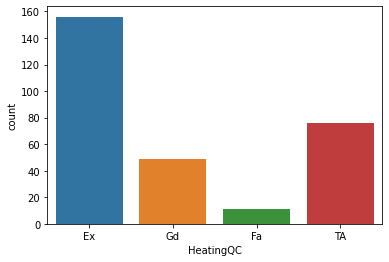

Y    275
N     17
Name: CentralAir, dtype: int64


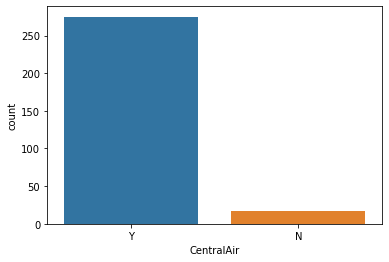

SBrkr    265
FuseA     20
FuseF      6
FuseP      1
Name: Electrical, dtype: int64


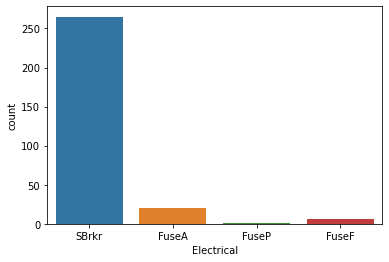

TA    157
Gd    108
Ex     18
Fa      9
Name: KitchenQual, dtype: int64


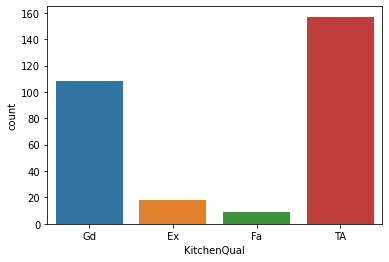

Typ     275
Min1      6
Min2      4
Mod       3
Maj1      3
Maj2      1
Name: Functional, dtype: int64


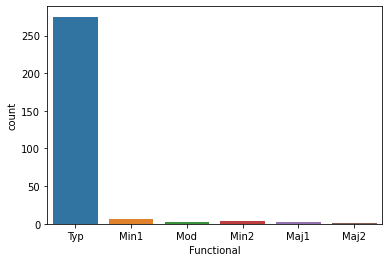

Gd    218
TA     61
Fa      8
Ex      3
Po      2
Name: FireplaceQu, dtype: int64


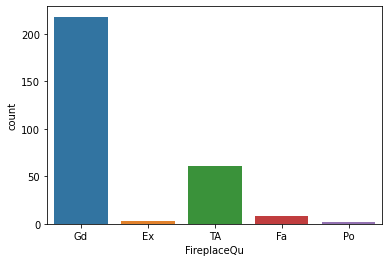

Attchd     196
Detchd      73
BuiltIn     18
Basment      3
2Types       1
CarPort      1
Name: GarageType, dtype: int64


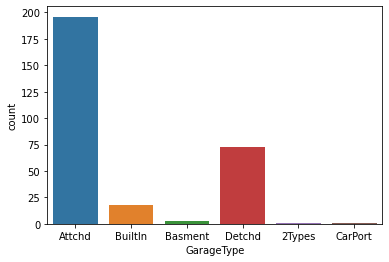

Unf    135
RFn     83
Fin     74
Name: GarageFinish, dtype: int64


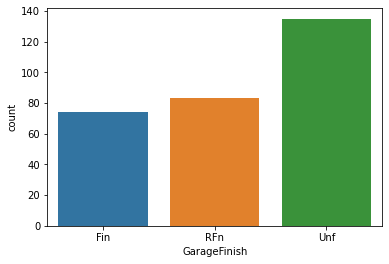

TA    278
Fa      9
Gd      3
Po      1
Ex      1
Name: GarageQual, dtype: int64


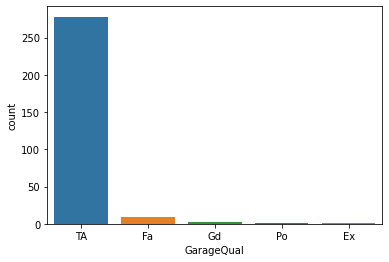

TA    282
Fa      7
Po      1
Ex      1
Gd      1
Name: GarageCond, dtype: int64


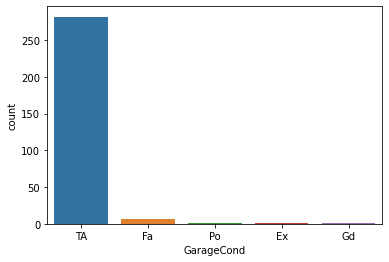

Y    269
N     16
P      7
Name: PavedDrive, dtype: int64


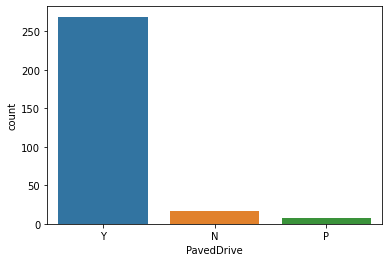

WD       268
New       16
COD        5
ConLD      1
CWD        1
ConLw      1
Name: SaleType, dtype: int64


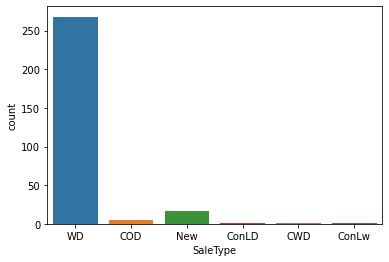

Normal     253
Abnorml     20
Partial     17
Family       2
Name: SaleCondition, dtype: int64


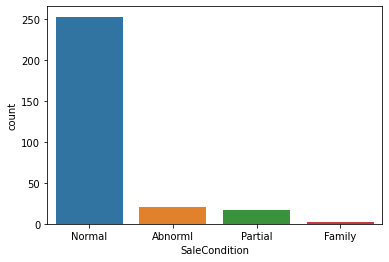

In [318]:
#plotting count plot
for i in cat_features_test:
    sns.countplot(x=data1[i],data=data1)
    print(data1[i].value_counts())
    plt.show()

**Observation**
* **In above plots we can see that count plots for the test data of categorical features.**

* **Residential Low Density count is high as compare to other MSZoning**
* **In the Stree Pave count is high, in increase of sales it also depends on the type of street**
* **In the general shape of the property, the regural shape has the maximum count, Single Regular count is also little high next to regular shape.**
* **If we see the flatness of the property, the property which is having the Near Flat level has maximum count. In the Depression flatness of propery has very less count.**
* **In the lot configuration, inside lot configuration has the maximum count.**
* **In the slope of propety, the gentle slope has the maximum count.**
* **In the Neighborhood: Physical locations within Ames city limits, NAMES has the maximum count as compare to others.**
* **In Condition1, proximity to various condition the normal condition has the maximum count. Many people to have normal proximity condition. So, its count is high.**
* **In Condition2, Proximity to various conditions (if more than one is present) also people prefer the normal condition. So, it has the maximum count.**
* **In BldgType, the type of dwelling, 1 Farm-Single Family Detached has the maximum count.**
* **For Vinyl Siding exterior-2 covering on house has maximum counts for the feature Exterior covering on house (if more than one material)(Exterior2nd).**

* **For Masonry veneer type(MasVnrType) None has maximum count.**
* **For Typical/Average(TA) quality of the material on the exterior has maximum count, for the feature Evaluates the quality of the material on the exterior (ExterQual).**
* **For Typical/Average(TA) condition of the material on the exterior has maximum count for the feature Evaluates the present condition of the material on the exterior(ExterCond).**
* **For Cinder Block and Poured Contrete foundations the count is maximum for the feature Type of foundation(Foundation).**
* **For good and average quality heights of the basement the count is high for the feature Evaluates the height of the basement(BsmtQual).**
* **For Typical/Average(TA) general condition of the basement the count is high for the feature Evaluates the general condition of the basement(BsmtCond)**
* **For No Exposure garden level walls the count is maximum for the feature Refers to walkout or garden level walls(BsmtExposure).**
* **For unfinished Rating of basement finished area-1 the count is maximum for the feature Rating of basement finished area(BsmtFinType1).**
* **For unfinished Rating of basement finished area-2 the count is maximum for the feature Rating of basement finished area (if multiple types)(BsmtFinType2).**
* **For Gas forced warm air furnace type of heating the count is maximum for the feature Type of heating(Heating).**
* **For Excellent Heating quality and condition the count is high for the feature Heating quality and condition(HeatingQC).**
* **For Central air conditioning-yes has maximum count for the feature Central air conditioning(CentralAir).**
* **For Standard Circuit Breakers & Romex Electrical system the count is high for the feature Electrical system(Electrical).**
* **For Typical/Average(TA) and good Kitchen quality the count is maximum for the feature Kitchen quality(KitchenQual).**
* **Typical Functionality has highest count for Home functionality (Assume typical unless deductions are warranted)(Functional).**
* **For good Fireplace quality the count is high for the feature Fireplace quality(FireplaceQu).**
* **If Garage location Attached to home then the count is high, for the feature Garage location(GarageType).**
* **For Unfinished Interior of the garage the count is maximum, for the feature Interior finish of the garage(GarageFinish).**
* **For Typical/Average(TA) Garage quality the count is high, for the feature Garage quality(GarageQual).**
* **For Typical/Average(TA) Garage condition the count is high, for the feature Garage condition(GarageCond).**
* **For Paved driveway the count is maximum, for the feature Paved driveway(PavedDrive).**
* **For Warranty Deed - Conventional type of sales the count is maximum, for the feature Type of sale(SaleType).**
* **For Normal sales condition the count is high, for the feature Condition of sale(SaleCondition).**

MSZoning


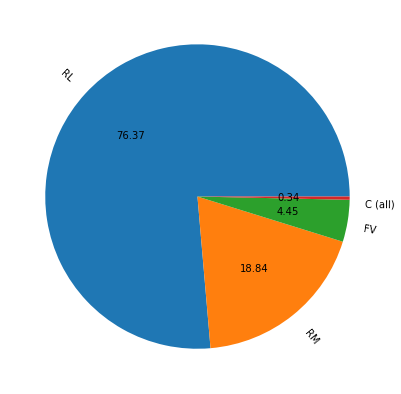

Street


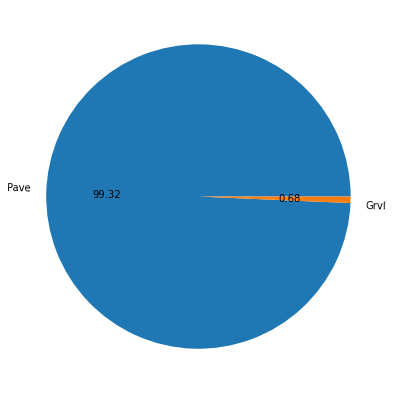

LotShape


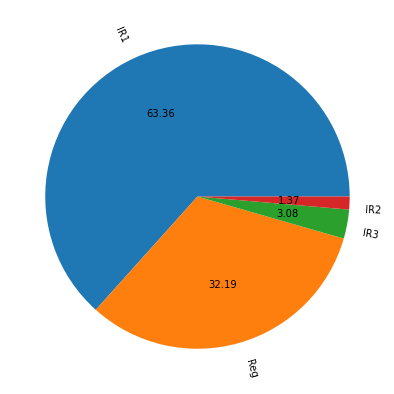

LandContour


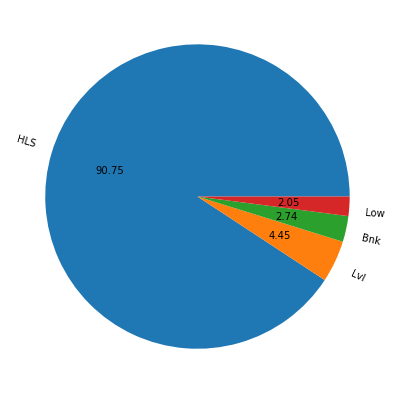

Utilities


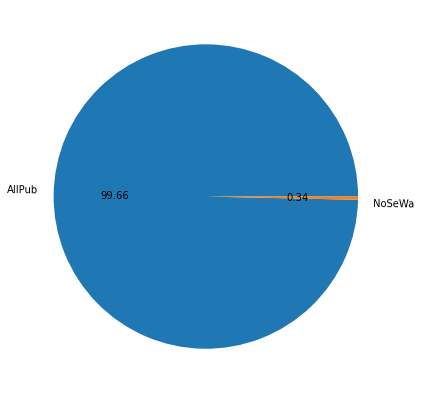

LotConfig


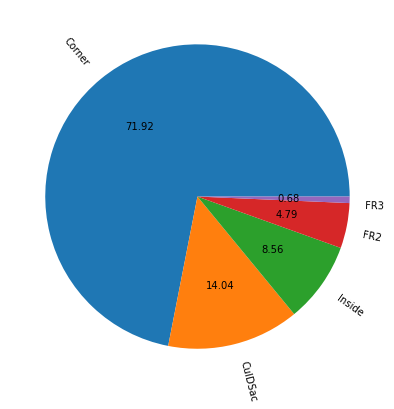

LandSlope


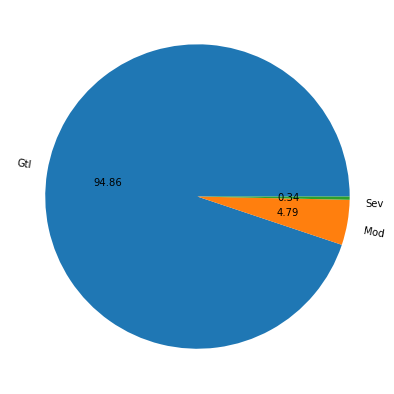

Neighborhood


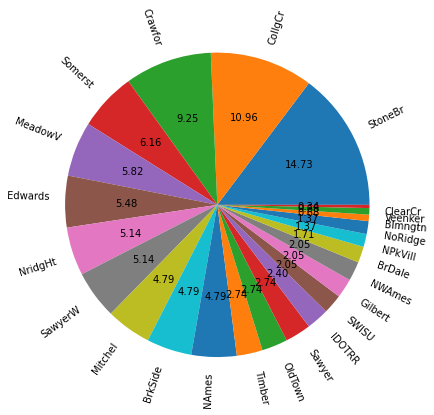

Condition1


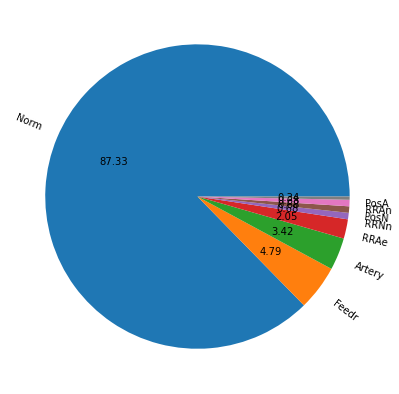

Condition2


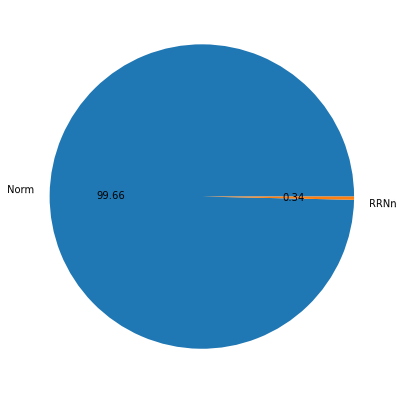

BldgType


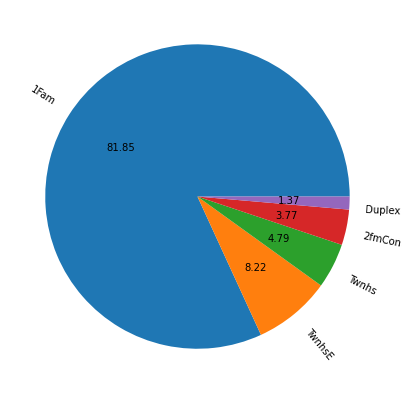

HouseStyle


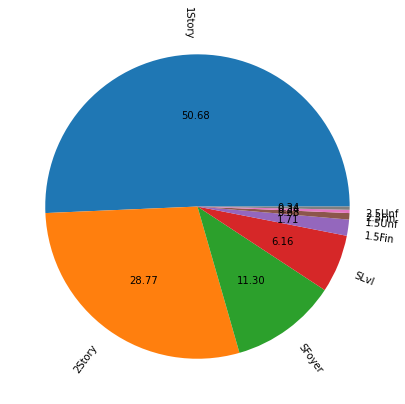

RoofStyle


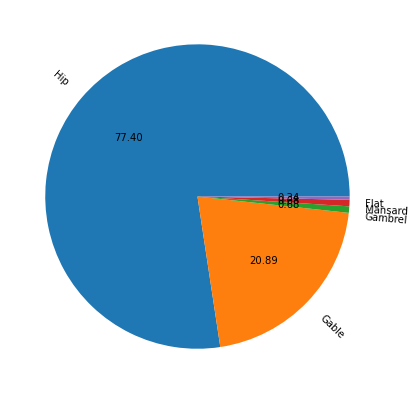

RoofMatl


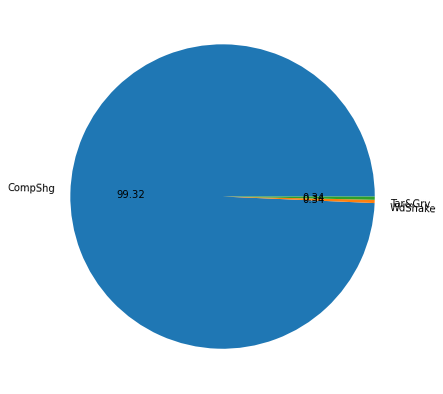

Exterior1st


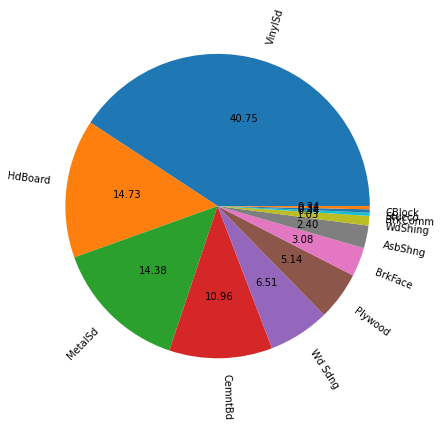

Exterior2nd


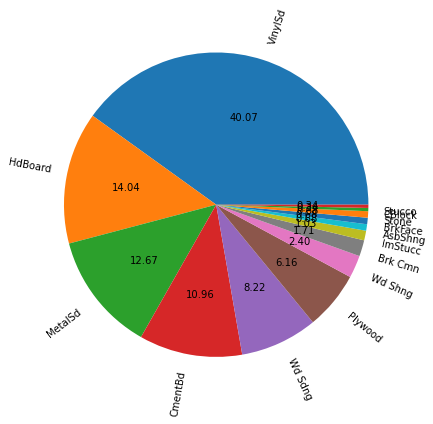

MasVnrType


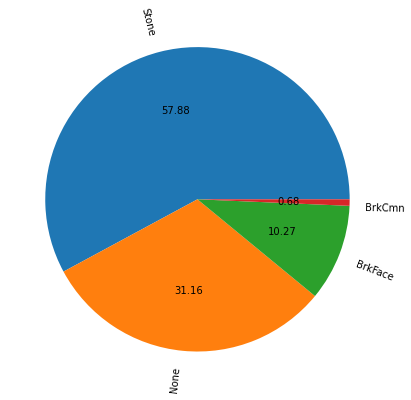

ExterQual


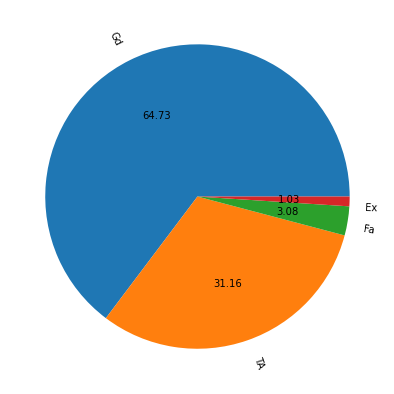

ExterCond


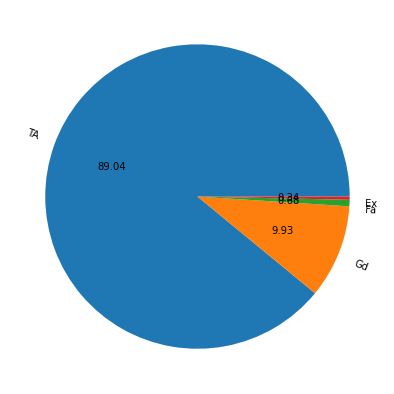

Foundation


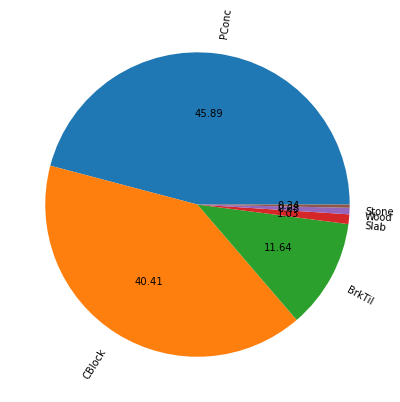

BsmtQual


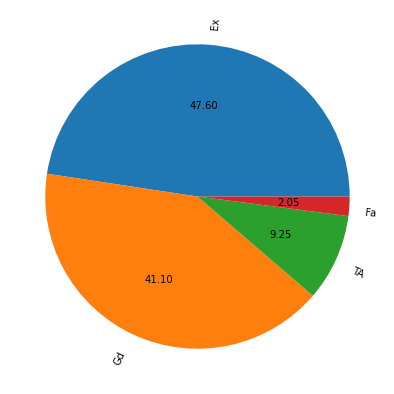

BsmtCond


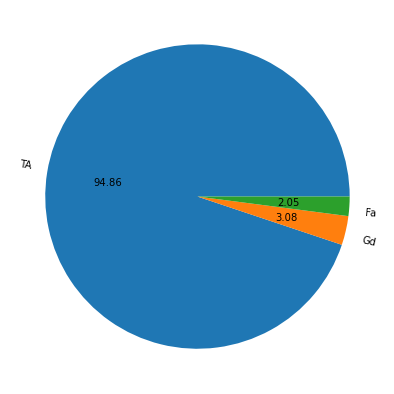

BsmtExposure


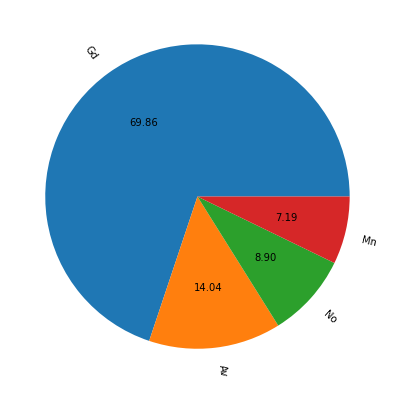

BsmtFinType1


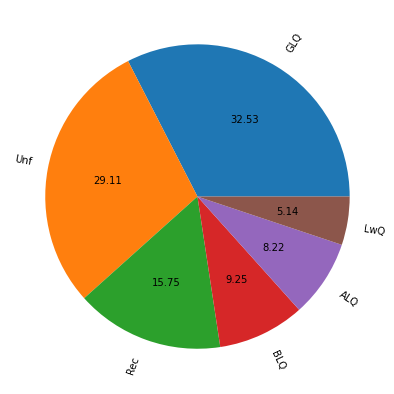

BsmtFinType2


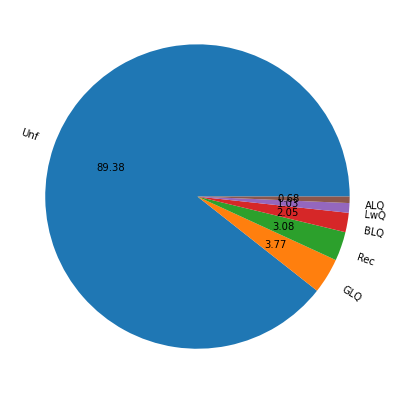

Heating


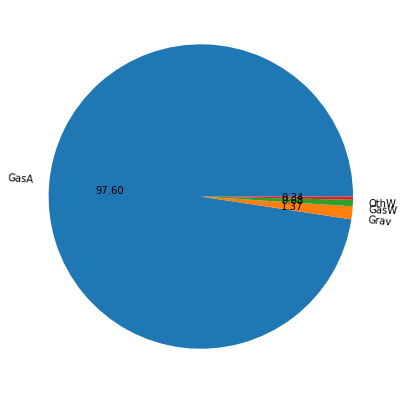

HeatingQC


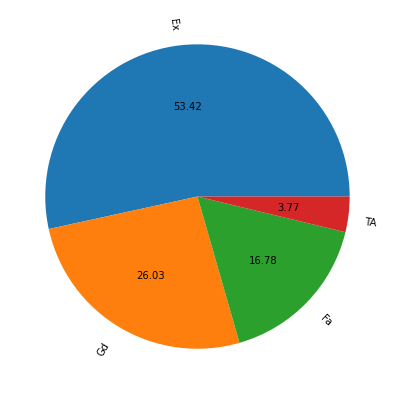

CentralAir


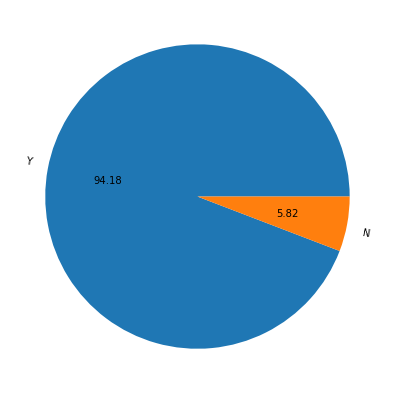

Electrical


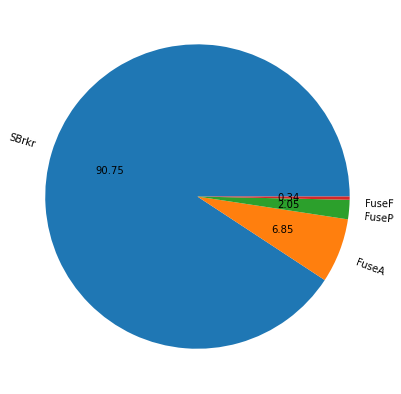

KitchenQual


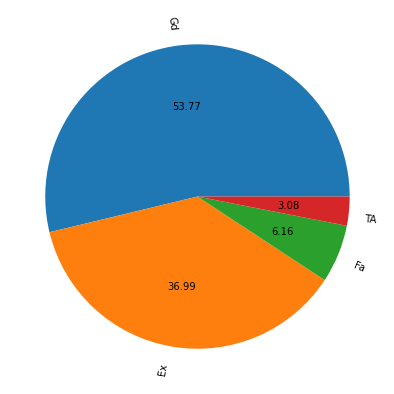

Functional


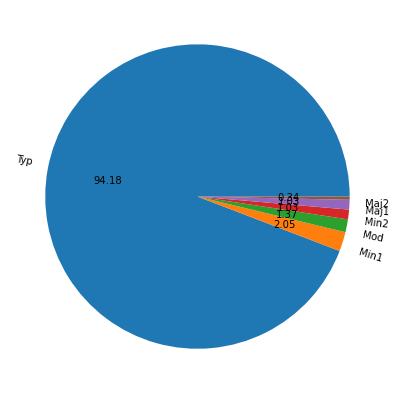

FireplaceQu


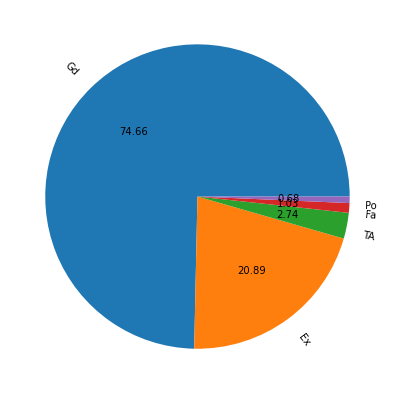

GarageType


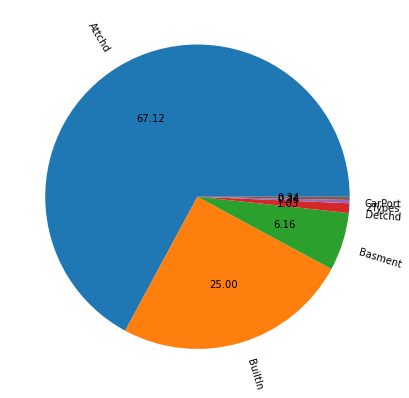

GarageFinish


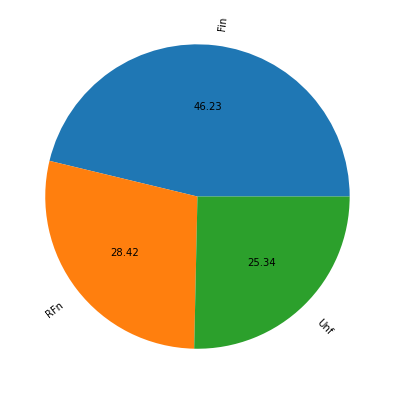

GarageQual


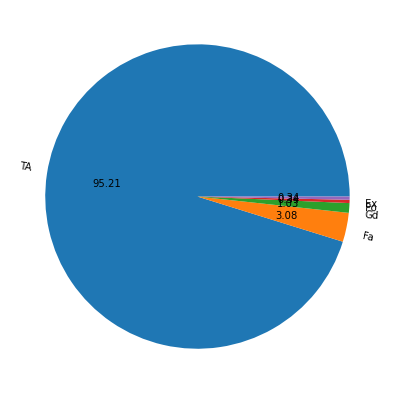

GarageCond


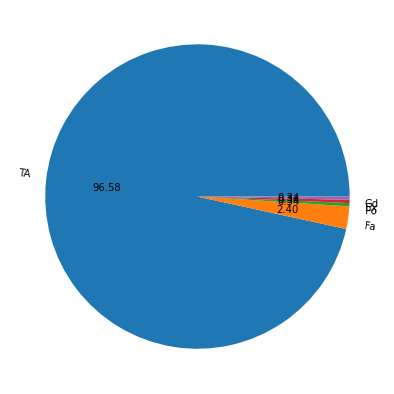

PavedDrive


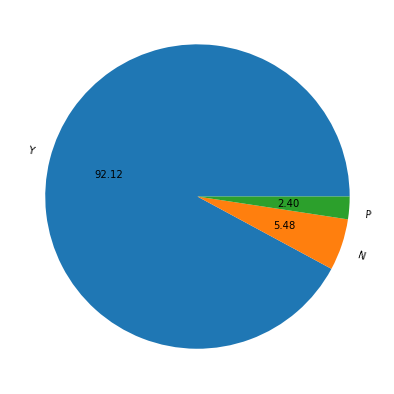

SaleType


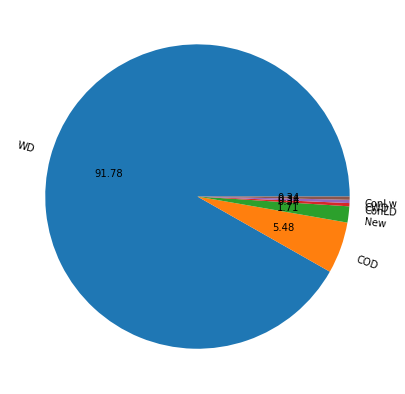

SaleCondition


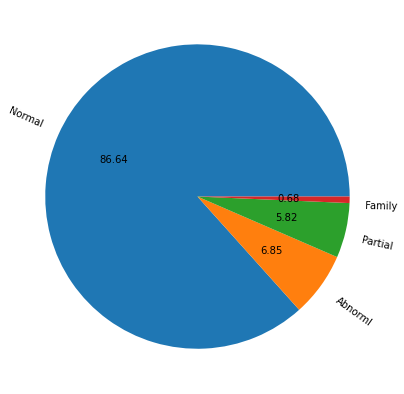

In [452]:
#plotting count plot
for i in data1:
    if data1[i].dtype=='object':
        print(i)
        plt.figure(figsize=(7,7))
        labels=data1[i].unique()
        plt.pie(x=data1[i].value_counts(),labels=labels,autopct='%.2f',rotatelabels=True)
        plt.show()

**Above plots are the pie plots for categorical features of test data.**

In [320]:
#Importing required libraries
from sklearn.preprocessing import LabelEncoder

In [321]:
#Encoding column
lab_enc=LabelEncoder()

In [322]:
# Let's convert the categorical data to numerical data for test data
for i in cat_features_test:
    data1[i]=lab_enc.fit_transform(data1[i])

In [323]:
data1.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,20,2,86.000000,14157,1,0,1,0,0,0,21,2,0,0,2,9,5,2005,2006,3,0,9,11,3,200.0,2,3,2,0,2,1,2,1249,5,0,673,1922,0,0,1,3,1922,0,0,1922,1,0,2,0,3,1,2,8,5,1,2,1,2005.0,0,3,676,4,4,2,178,51,0,0,0,0,0,7,2007,5,2
1,120,2,66.425101,5814,1,0,3,0,1,0,21,2,0,4,2,8,5,1984,1984,1,0,5,5,2,0.0,2,3,1,2,2,0,2,1036,5,0,184,1220,0,2,1,3,1360,0,0,1360,1,0,1,0,1,1,2,4,5,1,0,1,1984.0,1,2,565,4,4,2,63,0,0,0,0,0,0,8,2009,0,0
2,20,2,66.425101,11838,1,3,3,0,4,0,4,2,0,0,2,8,5,2001,2001,3,0,9,11,2,0.0,2,3,2,2,2,0,5,0,5,0,1753,1753,0,0,1,3,1788,0,0,1788,0,0,2,0,3,1,0,7,5,1,4,1,2001.0,1,2,522,4,4,2,202,151,0,0,0,0,0,6,2009,5,2
3,70,2,75.000000,12000,1,3,0,0,4,0,5,2,0,0,5,7,7,1941,1950,1,0,6,7,2,0.0,3,3,1,3,2,3,4,275,5,0,429,704,0,0,1,3,860,704,0,1564,0,0,1,1,3,1,1,7,5,1,2,1,1941.0,2,1,234,4,4,2,0,0,0,0,0,0,0,7,2009,5,2
4,60,2,86.000000,14598,1,0,3,0,1,0,20,1,0,0,5,6,5,2007,2007,1,0,9,11,3,74.0,2,3,2,2,2,2,5,0,5,0,894,894,0,0,1,3,894,1039,0,1933,0,0,2,1,4,1,2,9,5,1,2,3,2007.0,0,3,668,4,4,2,100,18,0,0,0,0,0,1,2008,5,2


**So we can see that all the categorical columns have been encoded.**

**Checking for outliers**

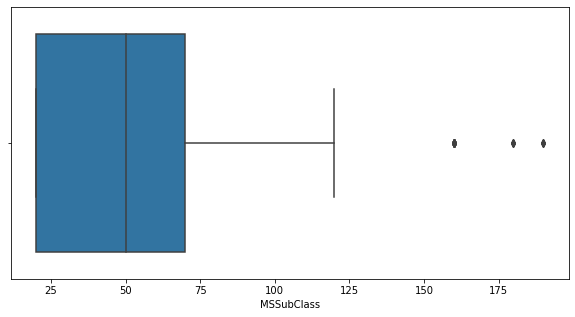

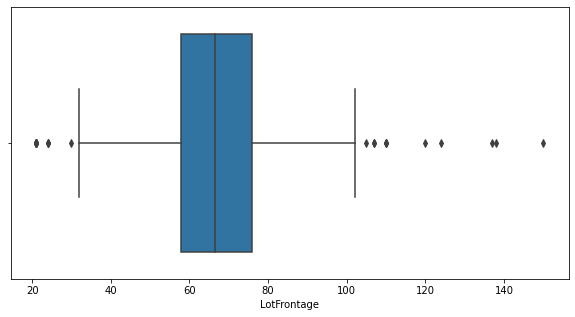

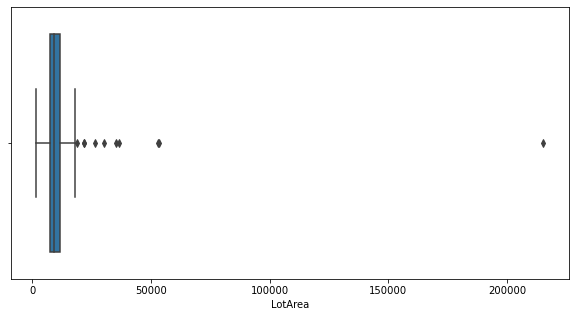

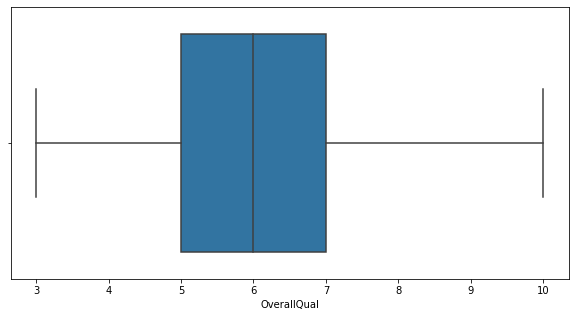

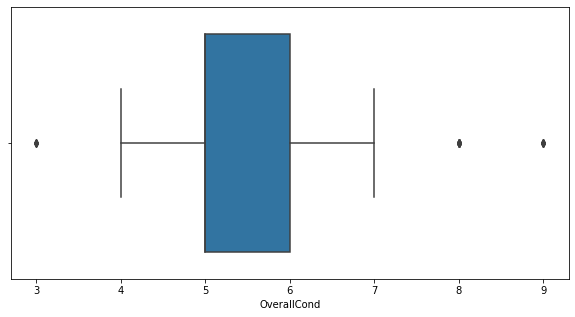

...

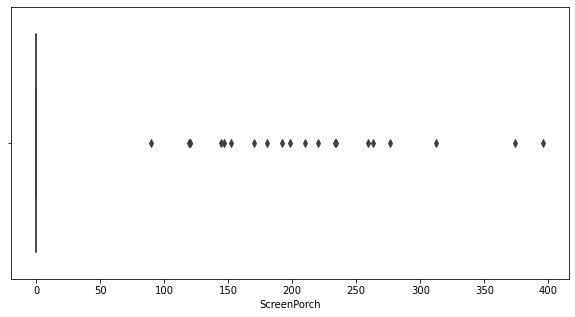

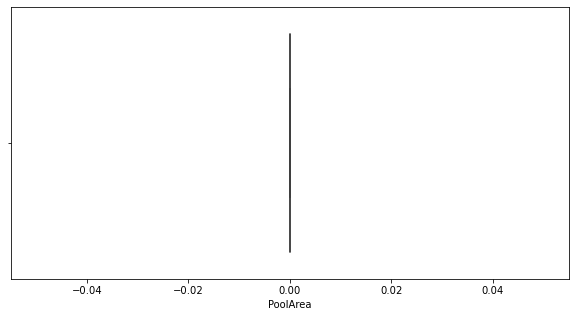

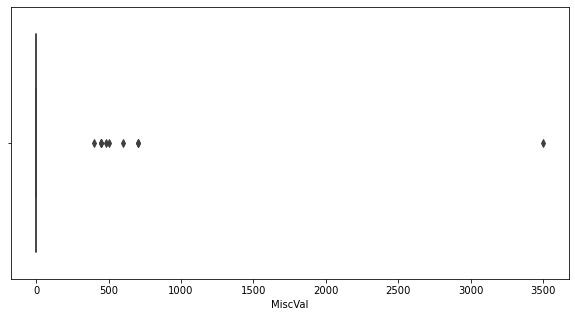

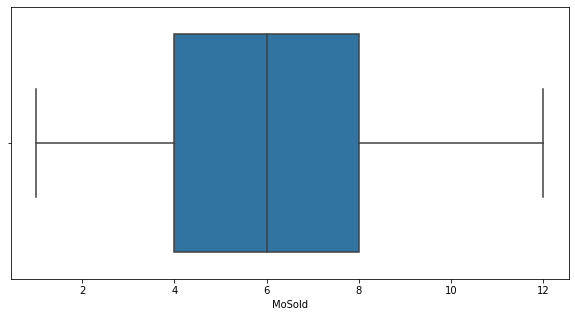

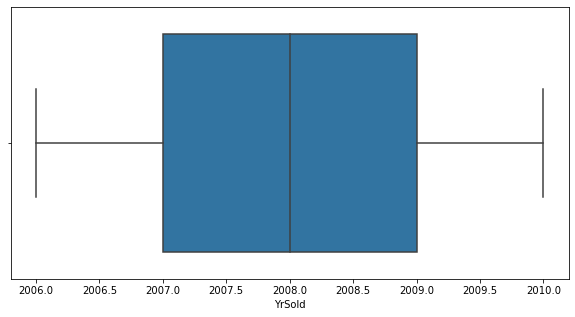

In [325]:
#plotting boxplot
for i in cont_features_test:
    plt.figure(figsize=(10,5))
    sns.boxplot(data1[i])
    plt.show()

**In the above plots we can see that in columns 'MSSubClass','LotFrontage','LotArea','OverallCond','YearBuilt','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','LowQualFinSF','GrLivArea','BsmtHalfBath','BedroomAbvGr','KitchenAbvGr','TotRmsAbvGrd','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','MiscVal'outliers are present.so using z-score method to remove outliers**

In [326]:
#Importing required libraries
from scipy.stats import zscore

In [327]:
#Removing outliers
z_score=zscore(data1[['MSSubClass','LotFrontage','LotArea','OverallCond','YearBuilt','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','LowQualFinSF','GrLivArea','BsmtHalfBath','BedroomAbvGr','KitchenAbvGr','TotRmsAbvGrd','GarageCars','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','MiscVal']])
abs_z_score=np.abs(z_score)
threshold=3
z=(abs_z_score<3).all(axis=1)

In [328]:
data1[z].shape

(209, 75)

In [329]:
data1.shape

(292, 75)

In [330]:
#Percentage Loss of Data
data_loss=((292-209)/292)*100
print(f'Data Loss:{data_loss} %')

Data Loss:28.424657534246577 %


**Data loss percentage is more,so not removing outliers.**

In [331]:
#checking skewness
data1[cont_features_test].skew()

MSSubClass        1.358597
LotFrontage       0.466813
LotArea          12.781805
OverallQual       0.397312
OverallCond       1.209714
YearBuilt        -0.755233
YearRemodAdd     -0.535600
MasVnrArea        1.976804
BsmtFinSF1        0.739790
BsmtFinSF2        3.698543
BsmtUnfSF         0.960708
TotalBsmtSF       0.519257
1stFlrSF          0.692047
2ndFlrSF          0.765511
LowQualFinSF     10.929928
GrLivArea         1.010586
BsmtFullBath      0.463685
BsmtHalfBath      3.544994
FullBath         -0.049800
HalfBath          0.758892
BedroomAbvGr      0.075315
KitchenAbvGr      4.849432
TotRmsAbvGrd      0.805535
Fireplaces        0.540164
GarageYrBlt      -0.683042
GarageCars       -0.280324
GarageArea        0.133547
WoodDeckSF        1.708221
OpenPorchSF       2.185030
EnclosedPorch     3.177046
3SsnPorch        12.277476
ScreenPorch       4.182351
PoolArea          0.000000
MiscVal          13.264758
MoSold            0.186504
YrSold            0.018412
dtype: float64

**So we can see that in columns 'MSSubClass','LotArea','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtHalfBath','HalfBath','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','MiscVal' skewness is present.so will be using power transform method to treat the skewness.**

In [332]:
data1[['MSSubClass','LotArea','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtHalfBath','HalfBath','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','MiscVal']]=power_transform(data1[['MSSubClass','LotArea','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtHalfBath','HalfBath','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','MiscVal']],method='yeo-johnson')
data1[['MSSubClass','LotArea','OverallCond','YearBuilt','YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF','GrLivArea','BsmtHalfBath','HalfBath','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','WoodDeckSF','OpenPorchSF','EnclosedPorch','3SsnPorch','ScreenPorch','MiscVal']]

,MSSubClass,LotArea,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtHalfBath,HalfBath,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,MiscVal
0,-1.149768,0.842656,-0.387299,1.222621,1.153837,1.182923,1.205140,-0.344636,0.455087,1.931242,1.814725,-0.870294,-0.101885,0.943726,-0.263813,-0.738058,-3.122502e-17,0.961793,0.808861,1.230141,1.119038,0.718308,-0.392619,-0.083045,-0.278372,-0.188311
1,1.337666,-0.739104,-0.387299,0.236597,-0.278412,-0.846534,1.064798,-0.344636,-0.841820,0.451268,0.726749,-0.870294,-0.101885,-0.077517,-0.263813,-0.738058,-3.122502e-17,-1.618327,0.808861,0.027527,0.813787,-1.111540,-0.392619,-0.083045,-0.278372,-0.188311
2,-1.149768,0.524304,-0.387299,1.013914,0.768563,-0.846534,-1.375716,-0.344636,2.127575,1.587714,1.586900,-0.870294,-0.101885,0.729670,-0.263813,-0.738058,-3.122502e-17,0.447622,0.808861,0.971376,1.153748,1.278346,-0.392619,-0.083045,-0.278372,-0.188311
3,0.705404,0.548484,1.397520,-1.113843,-1.524080,-0.846534,0.235689,-0.344636,-0.093395,-0.761116,-0.705442,1.137231,-0.101885,0.334155,-0.263813,1.349285,-3.122502e-17,0.447622,0.808861,-1.519315,-0.913570,-1.111540,-0.392619,-0.083045,-0.278372,-0.188311
4,0.507343,0.897263,-0.387299,1.331019,1.235800,0.952580,-1.375716,-0.344636,0.870427,-0.297412,-0.584696,1.211129,-0.101885,0.960645,-0.263813,1.349285,-3.122502e-17,1.420534,0.808861,1.365358,0.954066,0.218396,-0.392619,-0.083045,-0.278372,-0.188311
5,1.756245,-2.686724,0.624283,-0.287833,-0.900731,-0.846534,-0.121583,2.901894,-2.160537,-0.948903,-1.671754,-0.870294,-0.101885,-2.320101,-0.263813,-0.738058,-3.122502e-17,-2.607173,-1.023536,-0.173015,-0.913570,-1.111540,-0.392619,-0.083045,-0.278372,-0.188311
6,1.756245,-1.552498,-0.387299,1.222621,1.073555,0.972297,0.631537,-0.344636,-2.160537,-1.165395,-0.018210,-0.870294,-0.101885,-0.775347,-0.263813,-0.738058,-3.122502e-17,-0.814211,-1.023536,1.230141,-0.913570,0.425402,-0.392619,-0.083045,-0.278372,-0.188311
7,-1.149768,0.808892,-0.387299,1.331019,1.319477,1.334108,1.294045,-0.344636,-0.418790,1.499170,1.446419,-0.870294,-0.101885,0.597733,-0.263813,-0.738058,-3.122502e-17,-0.137017,0.808861,1.365358,-0.913570,1.071803,-0.392619,-0.083045,-0.278372,-0.188311
8,0.870603,0.663317,-0.387299,0.447961,-0.008005,1.113294,1.358618,-0.344636,-2.160537,1.097621,1.322535,-0.870294,-0.101885,0.481418,3.790570,-0.738058,-3.122502e-17,-0.814211,0.808861,0.280873,0.887219,-1.111540,-0.392619,-0.083045,3.592325,-0.188311
9,1.337666,-1.193546,-0.387299,0.864205,0.555876,1.276939,0.936219,-0.344636,-0.337301,0.415645,0.344966,-0.870294,-0.101885,-0.435293,-0.263813,-0.738058,-3.122502e-17,-0.814211,-1.023536,0.787088,-0.913570,1.543749,-0.392619,-0.083045,-0.278372,-0.188311


In [333]:
#checking skewness
data1[cont_features_test].skew()

MSSubClass        0.089921
LotFrontage       0.466813
LotArea           0.003111
OverallQual       0.397312
OverallCond      -0.079098
YearBuilt        -0.171084
YearRemodAdd     -0.227509
MasVnrArea        0.363253
BsmtFinSF1       -0.441605
BsmtFinSF2        2.570199
BsmtUnfSF        -0.232099
TotalBsmtSF      -0.037982
1stFlrSF         -0.000548
2ndFlrSF          0.284246
LowQualFinSF      9.763295
GrLivArea        -0.000307
BsmtFullBath      0.463685
BsmtHalfBath      3.544994
FullBath         -0.049800
HalfBath          0.621093
BedroomAbvGr      0.075315
KitchenAbvGr      0.000000
TotRmsAbvGrd     -0.000469
Fireplaces        0.076669
GarageYrBlt      -0.138287
GarageCars       -0.280324
GarageArea        0.133547
WoodDeckSF        0.210102
OpenPorchSF      -0.058951
EnclosedPorch     2.165535
3SsnPorch        12.020386
ScreenPorch       3.331084
PoolArea          0.000000
MiscVal           5.148542
MoSold            0.186504
YrSold            0.018412
dtype: float64

In [334]:
#Dividing dataset into features and label
#Features
X=data1

In [335]:
#Standardiziing the data
#Importing require libraries
from sklearn.preprocessing import StandardScaler
Scaler=StandardScaler()
x_scaler=Scaler.fit_transform(X)
x_scaler

array([[-1.14976802, -0.28700579,  0.98160499, ..., -0.65090813,
         0.23029007,  0.14865423],
       [ 1.33766595, -0.28700579,  0.        , ...,  0.86355541,
        -6.49418003, -3.32390858],
       [-1.14976802, -0.28700579,  0.        , ...,  0.86355541,
         0.23029007,  0.14865423],
       ...,
       [-1.14976802, -0.28700579,  0.        , ...,  1.62078718,
         0.23029007,  0.14865423],
       [ 0.262613  ,  1.80813647, -0.8236549 , ..., -1.4081399 ,
         0.23029007,  0.14865423],
       [ 1.63938246,  1.80813647, -2.27789203, ..., -1.4081399 ,
         0.23029007,  0.14865423]])

In [336]:
x_scaler.shape

(292, 75)

In [337]:
#Importing require libraries
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [339]:
vif=pd.DataFrame()
vif['vif']=[variance_inflation_factor(x_scaler,i)for i in range(x_scaler.shape[1])]
vif['feature']=X.columns
vif

,vif,feature
0,11.635667,MSSubClass
1,1.935401,MSZoning
2,2.700647,LotFrontage
3,4.389504,LotArea
4,1.613013,Street
5,1.762065,LotShape
6,1.781573,LandContour
7,1.977679,Utilities
8,1.417238,LotConfig
9,2.348686,LandSlope


**I have selected those features which I have used to train my model on train dataset.So I will require same features to predict test values.**

In [343]:
X=data1[['OverallQual','ExterQual','GrLivArea','BsmtQual','KitchenQual','FullBath','GarageFinish','YearRemodAdd','Street','Heating','Fireplaces','MSZoning','OpenPorchSF','CentralAir','Foundation','LotShape','LotArea','HeatingQC','HalfBath','Neighborhood','MasVnrArea','WoodDeckSF','BsmtExposure','LotFrontage','FireplaceQu','BsmtCond','RoofMatl','MasVnrType','GarageType','BedroomAbvGr','Electrical','BldgType','OverallCond','RoofStyle','Exterior1st','LandSlope','Exterior2nd','BsmtFullBath','LandContour','SaleCondition','YrSold','PavedDrive','GarageQual','LotConfig','BsmtFinType1','EnclosedPorch','ExterCond','MiscVal','LowQualFinSF','MoSold','HouseStyle']]
X

,OverallQual,ExterQual,GrLivArea,BsmtQual,KitchenQual,FullBath,GarageFinish,YearRemodAdd,Street,Heating,Fireplaces,MSZoning,OpenPorchSF,CentralAir,Foundation,LotShape,LotArea,HeatingQC,HalfBath,Neighborhood,MasVnrArea,WoodDeckSF,BsmtExposure,LotFrontage,FireplaceQu,BsmtCond,RoofMatl,MasVnrType,GarageType,BedroomAbvGr,Electrical,BldgType,OverallCond,RoofStyle,Exterior1st,LandSlope,Exterior2nd,BsmtFullBath,LandContour,SaleCondition,YrSold,PavedDrive,GarageQual,LotConfig,BsmtFinType1,EnclosedPorch,ExterCond,MiscVal,LowQualFinSF,MoSold,HouseStyle
0,9,2,0.943726,0,2,2,0,1.153837,1,0,0.808861,2,0.718308,1,2,0,0.842656,0,-0.738058,21,1.182923,1.119038,1,86.000000,2,2,0,3,1,3,3,0,-0.387299,3,9,0,11,1,1,2,2007,2,4,0,2,-0.392619,3,-0.188311,-0.101885,7,2
1,8,2,-0.077517,2,2,1,1,-0.278412,1,0,0.808861,2,-1.111540,1,1,0,-0.739104,2,-0.738058,21,-0.846534,0.813787,0,66.425101,0,2,0,2,1,1,3,4,-0.387299,1,5,0,5,1,3,0,2009,2,4,1,2,-0.392619,3,-0.188311,-0.101885,8,2
2,8,2,0.729670,2,0,2,1,0.768563,1,0,0.808861,2,1.278346,1,2,3,0.524304,0,-0.738058,4,-0.846534,1.153748,0,66.425101,4,2,0,2,1,3,3,0,-0.387299,3,9,0,11,0,3,2,2009,2,4,4,5,-0.392619,3,-0.188311,-0.101885,6,2
3,7,3,0.334155,3,1,1,2,-1.524080,1,0,0.808861,2,-1.111540,1,1,3,0.548484,0,1.349285,5,-0.846534,-0.913570,3,75.000000,2,2,0,2,1,3,3,0,1.397520,1,6,0,7,0,0,2,2009,2,4,4,4,-0.392619,3,-0.188311,-0.101885,7,5
4,6,2,0.960645,2,2,2,0,1.235800,1,0,0.808861,2,0.218396,1,2,0,0.897263,0,1.349285,20,0.952580,0.954066,2,86.000000,2,2,0,3,3,4,3,0,-0.387299,1,9,0,11,0,3,2,2008,2,4,1,5,-0.392619,3,-0.188311,-0.101885,1,5
5,4,3,-2.320101,2,3,1,2,-0.900731,1,0,-1.023536,3,-1.111540,1,1,3,-2.686724,2,-0.738058,9,-0.846534,-0.913570,0,21.000000,2,2,0,2,1,1,3,3,0.624283,1,4,0,4,1,3,2,2007,2,4,4,1,-0.392619,3,-0.188311,-0.101885,12,6
6,5,3,-0.775347,2,3,1,0,1.073555,1,0,-1.023536,3,0.425402,1,2,3,-1.552498,2,-0.738058,6,0.972297,-0.913570,1,35.000000,2,2,0,1,2,2,3,4,-0.387299,1,9,0,11,1,3,2,2006,2,4,4,2,-0.392619,3,-0.188311,-0.101885,5,7
7,8,2,0.597733,0,2,2,1,1.319477,1,0,0.808861,2,1.071803,1,2,3,0.808892,0,-0.738058,15,1.334108,-0.913570,1,107.000000,2,2,0,3,1,2,3,0,-0.387299,3,9,0,11,1,3,3,2008,2,4,4,2,-0.392619,3,-0.188311,-0.101885,1,2
8,7,2,0.481418,2,2,2,0,-0.008005,1,0,0.808861,2,-1.111540,1,2,3,0.663317,2,-0.738058,19,1.113294,0.887219,1,66.425101,4,2,0,1,1,2,3,0,-0.387299,1,10,1,12,1,2,2,2009,2,4,4,2,-0.392619,3,-0.188311,-0.101885,8,7
9,6,3,-0.435293,0,3,2,0,0.555876,1,0,-1.023536,3,1.543749,1,2,3,-1.193546,0,-0.738058,10,1.276939,-0.913570,3,32.000000,2,2,0,1,1,2,3,4,-0.387299,3,9,0,11,1,3,2,2009,2,4,2,2,-0.392619,3,-0.188311,-0.101885,6,2


In [344]:
#Standardiziing the data
#Importing require libraries
from sklearn.preprocessing import StandardScaler
Scaler=StandardScaler()
x_scaler=Scaler.fit_transform(X)
x_scaler

array([[ 2.15776566, -0.85785774,  0.94372642, ..., -0.10188534,
         0.27695974, -0.51867068],
       [ 1.41911669, -0.85785774, -0.07751673, ..., -0.10188534,
         0.63799655, -0.51867068],
       [ 1.41911669, -0.85785774,  0.72967038, ..., -0.10188534,
        -0.08407707, -0.51867068],
       ...,
       [-0.05818125,  0.63318071, -0.96684744, ..., -0.10188534,
        -1.16718749, -0.51867068],
       [-0.05818125,  0.63318071,  0.5171399 , ..., -0.10188534,
         1.36007017, -1.53854839],
       [-0.05818125,  0.63318071, -1.01670121, ..., -0.10188534,
        -0.08407707,  1.01114588]])

In [345]:
#Loading the model and predicting
model=pickle.load(open('Housing Prediction','rb'))
print(model.predict(x_scaler))

[357975.24838403 228961.15920696 244946.15886843 192180.66242075
 206293.140288    94799.20696636 131972.78686063 321887.59822126
 212943.84047982 163673.10887303  69489.08990125 146870.87582208
 118166.92241416 165259.32159171 283279.89297626 137009.14186839
 127500.9628794  123780.5256344  187798.30247393 206620.28928472
 177872.50887393 148798.93801505 145844.23449271  96321.86033977
  98779.26083282 131562.85823242 173384.46323865 138689.16727472
 169642.71795516  97359.72439783 167074.50249173 193849.66265245
 216796.40460586 162565.80402781  92897.65005121 176585.85122669
 194126.99507882 120131.79947862 165167.54730986 145893.76350307
 105770.59570837 310921.48959209 202053.49543065 195465.7790228
 131985.26912832 135328.83234178 133522.21301901  78944.64339211
 205403.36712024 363174.87075559 143094.5338102  198924.46863764
  91717.70977689  80441.61093684 264733.7455375  139507.46296465
 136665.14357334 191637.04366652 109739.72368479 229952.16932966
 114203.60141165 181674.93